<a href="https://colab.research.google.com/github/SergeiVKalinin/ACerS_AE_2024/blob/main/17_AE_STEM_DKL_BO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DKL-GPR-BO for active learning
This notebook demonstrates how to use a deep kernel learning (DKL)-based Gaussian process regression (GPR) with vector output for autonomous experiments. Here we will be using the pre-acquired experimental dataset on plasmonic nanoparticles (HAADF + EELS) from `Kevin M. Roccapriore`.

*Prepared by `Maxim Ziatdinov` (June 2021)*

* Project conceived and overseen by `Sergei Kalinin` (<font color = 'crimson'>ORNL</font>)
* Electron microscopy, data preparation, and autonomous experiment carried out by `Kevin M. Roccapriore` (<font color = 'crimson'>ORNL</font>)
* DKL codes prepared and compiled by `Maxim Ziatdinov` (<font color = 'crimson'>ORNL</font>)


We graciously thank our friends and collaborators for providing the excellent samples used in this work:
* Plasmonic nanoparticles were chemically synthesized by `Shin-Hum Cho` (<font color = 'crimson'>Samsung Electronics</font>) & `Delia J. Milliron` (<font color = 'crimson'>UT Austin</font>)
* MnPS3 crystals were grown by `Nan Huang` & `David G. Mandrus` (<font color = 'crimson'>UT Knoxville</font>)

## Installations/Imports/Downloads

Installation:

In [1]:
# !pip install -q --upgrade torch==1.8.1 torchvision==0.9.1 torchtext==0.9.1
!pip install -q --upgrade git+https://github.com/pycroscopy/atomai

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 266.1/266.1 kB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.6/175.6 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 39.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.7/40.7 kB 4.7 MB/s eta 0:00:00


Check the GPU type/status:

In [2]:
!nvidia-smi

Sun Apr 21 18:26:35 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla V100-SXM2-16GB           Off | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P0              24W / 300W |      0MiB / 16384MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
#@title Library imports
import numpy as np
import matplotlib.pyplot as plt
import glob
import json
from scipy import ndimage, signal, interpolate
import operator
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches

import torch
import atomai as aoi
from sklearn.model_selection import train_test_split

from copy import deepcopy
from numpy.random import RandomState

from skimage import draw
from skimage.transform import resize
from skimage import color
from skimage.draw import disk as circle


# from IPython.display import Video
from IPython.core.display import Video
!pip install imageio-ffmpeg
import imageio

# To stop warning logs during movie creation
import imageio.core.util

In [4]:
#@title Acquisition function definitions
from typing import Union

def EI(model: aoi.models.dklGPR, X: Union[np.ndarray, torch.Tensor],
       best_f: Union[float, torch.Tensor], xi: Union[float, torch.Tensor] = 0.01
       ) -> np.ndarray:
    """
    Expected Improvement
    """
    tt = torch.tensor
    tor = lambda a: tt(a) if isinstance(a, (np.ndarray, float)) else a
    device=model.device
    dtype = model.dtype
    X, best_f, xi = tor(X), tor(best_f), tor(xi)
    posterior = model._compute_posterior(X.to(dtype).to(device))
    mean, sigma = posterior.mean, posterior.variance.sqrt()
    u = (mean - best_f.expand_as(mean) - xi.expand_as(mean)) / sigma
    normal = torch.distributions.Normal(torch.zeros_like(u), torch.ones_like(u))
    ucdf = normal.cdf(u)
    updf = torch.exp(normal.log_prob(u))
    obj = sigma * (updf + u * ucdf)
    return obj.detach().cpu().numpy()


def UCB(model: aoi.models.dklGPR, X: Union[np.ndarray, torch.Tensor],
        beta: Union[float, torch.Tensor] = 0.2) -> np.ndarray:
    """
    Upper confidence bound
    """
    tt = torch.tensor
    tor = lambda a: tt(a) if isinstance(a, (np.ndarray, float)) else a
    device = model.device
    dtype = model.dtype
    X, beta = tor(X), tor(beta)
    posterior = model._compute_posterior(X.to(dtype).to(device))
    mean, var = posterior.mean, posterior.variance
    delta = (beta.expand_as(mean).to(dtype).to(device) * var).sqrt()
    return (mean + delta).detach().cpu().numpy()


def CE(model: aoi.models.dklGPR, X: Union[np.ndarray, torch.Tensor]) -> np.ndarray:
    """Uncertainty-based exploration"""
    device = model.device
    dtype = model.dtype
    X = torch.tensor(X) if isinstance(X, (np.ndarray, float)) else X
    posterior = model._compute_posterior(X.to(dtype).to(device))
    obj = posterior.variance
    return obj.detach().cpu().numpy()


In [5]:
#@title Other functions
def plot_DKL_prediction_preacquired_notactive(model_name, structural_img, spectral_img, figsize = (15,8), energy_range = [0,-1]):

  mean,var = model_name.predict(X, batch_size = len(X))
  mean, var = mean.T, var.T
  s1, s2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
  s3 = y.shape[0]

  dkl_prediction = np.full((s1*s2,s3), np.nan)
  dkl_uncertainty = np.full((s1*s2,s3), np.nan)
  measurement_og = np.full((s1*s2,s3), np.nan)

  for ii in range(indices[:,0].shape[0]):
    dkl_prediction[ii] = mean[ii, :]
    dkl_uncertainty[ii] = var[ii, :]
    measurement_og[ii] = y.T[ii, :]

  dkl_prediction = dkl_prediction.reshape((s1,s2,s3))
  dkl_uncertainty = dkl_uncertainty.reshape((s1,s2,s3))
  measurement_og = measurement_og.reshape((s1,s2,s3))

  plt.figure(figsize=figsize)
  gs = gridspec.GridSpec(2,2)
  ax1,ax2 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])
  ax3,ax4 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])

  k1,k2 = energy_range[0], energy_range[1]

  im1 = ax1.imshow(np.mean(dkl_prediction[:,:,k1:k2],axis = 2), origin = 'lower')
  im2 = ax2.imshow(np.mean(dkl_uncertainty[:,:,k1:k2], axis = 2), origin = 'lower')
  ax1.set_title('DKL prediction', fontsize = 15)
  ax2.set_title('DKL uncertainty', fontsize = 15)

  cbar1 = plt.colorbar(im1, ax=ax1)
  cbar1.ax.tick_params(labelsize = 15)
  cbar2 = plt.colorbar(im2, ax=ax2)
  cbar2.ax.tick_params(labelsize = 15)

  predicted_spectrum = np.mean(mean[:,k1:k2], axis = 0)
  measured_spectrum = np.mean(y.T[:,k1:k2], axis = 0)

  ax3.plot(e_reduced[k1:k2],measured_spectrum, linewidth=6, c = 'blue', label="ground truth", zorder=0)
  ax3.plot(e_reduced[k1:k2],predicted_spectrum, linewidth=4, c='crimson', label="prediction", zorder=1)

  ax4.imshow(np.mean(measurement_og[:,:,k1:k2], axis = 2), origin = 'lower')

  leg=ax3.legend(fontsize = 20)
  for line in leg.get_lines():
    line.set_linewidth(10)

  ax3.set_xlabel('Energy loss (eV)', fontsize = 15, labelpad = 15, weight = 'bold')
  ax3.set_ylabel('Intensity (a.u.)', fontsize = 15, weight = 'bold')
  ax3.tick_params(labelsize = 15, length = 8, width = 3)
  ax3.axhline(0, c='k')

  all_axes = [ax1,ax2,ax3,ax4]
  for ax in all_axes:
    for axis in ['top','bottom','left','right']:
      ax.spines[axis].set_linewidth(3)

  ax1.axis('off'), ax2.axis('off'), ax4.axis('off')

  return dkl_prediction, dkl_uncertainty, predicted_spectrum, measured_spectrum, mean, var

def Make_AF_movies_preacquired(acquisition_functions,
                               RGB = [2,1,8],
                               brightness = 0.75,
                               measured_points_in_AF = [0,0,0],
                               measured_points_in_HAADF = [1,0,0]):

  R,G,B = RGB
  # k1,k2 = 0, -1  ## Energy bands to average across

  sr1, sr2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1

  AF_all_color = np.zeros((len(acquisition_functions), sr1,sr2, 3))
  AF_all = np.zeros((len(acquisition_functions), sr1,sr2))
  AF_combined_all = []
  for frame in range(len(acquisition_functions)):
    # Generate IMAGE from points

    AF_frame = np.full((sr1,sr2), np.nan)
    AF_combined = np.concatenate((acquisition_functions[frame]['frames'], acquisition_functions[frame]['colors'].reshape(-1,1)), axis = 1)
    AF_combined_all.append(AF_combined)
    for p in AF_combined:
      c1,c2,c3 = int(p[0]-window_size/2), int(p[1]-window_size/2), p[2]
      AF_frame[c1,c2] = c3
    AF_frame = normalize_nan(AF_frame)
    AF_all[frame] = AF_frame

    # Make COLOR image from grayscale image <-- for movie later
    AF_frame_c = np.array([[[s*R*brightness,s*G*brightness,s*B*brightness] for s in r] for r in AF_frame])
    nan_coords = np.argwhere(np.isnan(AF_frame_c))[::3][:,:2]

    for coord in nan_coords:
      AF_frame_c[coord[0], coord[1]] = measured_points_in_AF
    AF_all_color[frame] = np.clip(AF_frame_c, 0, 1)
    AF_all = np.asarray(AF_all)
    # AF_combined_all = np.asarray(AF_combined_all)

  return AF_all, AF_all_color, AF_combined_all

def create_point_search_mov_preacquired(structural_img, AF_combined, size = (50,50), point_radius = 1, point_color = [1,0,0], offset = 0):

  sr1, sr2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
  ir1, ir2 = structural_img.shape[0], structural_img.shape[1]
  cr1, cr2 = [int((ir1 - sr1)/2), int((ir2 - sr2)/2)]
  img_crop = structural_img[cr1:int(sr1+cr1), cr2:int(sr2+cr2)]

  size = [sr1,sr2]
  # Initialize stack
  Mov = np.zeros((len(AF_combined), sr1, sr2, 3))

  # Get coordinates for measured points (which are NaN)
  for frame in range(len(Mov)):
    temp = np.full((size), np.nan)
    for p in AF_combined[frame]:
      c1,c2,c3 = int(p[0]-window_size/2), int(p[1]-window_size/2), p[2]
      temp[c1,c2] = c3
    nan_coords = np.argwhere(np.isnan(temp))[:,:2]

    # Convert to color, and draw the measured points on each frame
    img_c = color.gray2rgb(normalize(img_crop))
    for m in nan_coords:
      a,b = m[0] + offset, m[1] + offset
      rr,cc = circle((a,b),point_radius)
      draw.set_color(img_c, (rr,cc), point_color)
    Mov[frame] = img_c

  return Mov

def normalize_nan(image):
  normed = (image - np.nanmin(image))/(np.nanmax(image) - np.nanmin(image))
  return normed



def plot_DKL_prediction_preacquired(model_files, step, embed = 2, precision = "double", figsize = (8,5), energy_range = [0,-1], colorscale = True):

  weights = model_files[step]
  num_cycles = 40
  dklgp_trained = aoi.models.dklGPR(data_dim, embedim=embed, precision=precision)
  dklgp_trained.compile_trainer(X, y, training_cycles = num_cycles)
  state_dict = torch.load(weights)
  dklgp_trained.gp_model.load_state_dict(state_dict)

  mean,var = dklgp_trained.predict(X, batch_size = len(X))

  s1, s2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
  s3 = y.shape[0]

  dkl_prediction = np.full((s1*s2,s3), np.nan)
  dkl_uncertainty = np.full((s1*s2,s3), np.nan)

  for ii in range(indices[:,0].shape[0]):
    dkl_prediction[ii] = mean.T[ii, :]
    dkl_uncertainty[ii] = var.T[ii, :]

  dkl_prediction = dkl_prediction.reshape((s1,s2,s3))
  dkl_uncertainty = dkl_uncertainty.reshape((s1,s2,s3))

  plt.figure(figsize=figsize)
  gs = gridspec.GridSpec(1,2)
  ax1,ax2 = plt.subplot(gs[0]), plt.subplot(gs[1])

  k1,k2 = energy_range[0], energy_range[1]
  im1 = ax1.imshow(np.mean(dkl_prediction[:,:,k1:k2],axis = 2), origin = 'lower')
  im2 = ax2.imshow(np.mean(dkl_uncertainty[:,:,k1:k2], axis = 2), origin = 'lower')

  ax1.set_title('DKL prediction: spectral average')
  ax2.set_title('DKL uncertainty: spectral average')

  plt.setp([ax1,ax2], xticks=[], yticks=[])

  if colorscale:
    cbar1 = plt.colorbar(im1, ax=ax1, fraction = 0.069,  aspect = 10)
    cbar2 = plt.colorbar(im2, ax=ax2, fraction = 0.069, aspect = 10)
    cbar1.ax.tick_params(labelsize = 15)
    cbar2.ax.tick_params(labelsize = 15)

  return dkl_prediction, dkl_uncertainty, mean, var

########################################
def DisplayAverageData(figsize = (15,5), scalebar = 15):

  fig,ax = plt.subplots(1,2,figsize=figsize)

  ax[0].imshow(img, cmap = 'gray')

  scalebar = 15

  yy,xx = img.shape[0], img.shape[1]
  xfrac, yfrac = 0.02, 0.85
  p1,p2 = xfrac*xx, yfrac*yy
  length = scalebar/imscale


  ax[0].add_patch(patches.Rectangle((p1,p2), length, length/7, color = 'w', ec = 'k', lw = 1))
  length

  ax[0].set_title("HAADF", fontsize = 22, weight = 'bold');

  avg_spec = np.mean(specim,axis=(0,1))
  ax[1].plot(e_ax, avg_spec)
  # ax[1].axvline(0.2, c='r')

  ax[1].set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
  ax[1].set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
  ax[1].tick_params(labelsize = 20, length = 8, width = 3)


  for axis in ['top','bottom','left','right']:
    ax[1].spines[axis].set_linewidth(3)

  ax[1].axhline(0, c='k')

  plt.setp(ax[0],xticks=[], yticks=[])





def LoadADF(filename):
    ADF1    = np.load(filename)
    ADF1j = json.load(open(filename[:-3]+'json','r'))
    ADF1_scale = ADF1j['spatial_calibrations'][0]['scale']
    return ADF1, ADF1_scale

def LoadMovie(filename):
    mov    = np.load(filename)
    movj = json.load(open(filename[:-3]+'json','r'))
    mov_scale = movj['spatial_calibrations'][1]['scale']
    return mov, mov_scale

def normalize(image):
  return (image - np.min(image))/(np.ptp(image))


# Patch functions
def create_patches(image, winsize):
    grid = aoi.utils.get_coord_grid(image, step = 1)
    patches, coords, _ = aoi.utils.extract_subimages(image, grid, window_size=winsize)
    patches = patches[:,:,:,0]

    return patches

def prepare_data_testing(patches, winsize, Spectrum_image):
    # Array to store images

    p1,p2,p3 = patches.shape
    half_win = int(winsize/2)
    d1,d2,d3 = Spectrum_image.shape

    feature_arr = patches.reshape(int(np.sqrt(p1)), int(np.sqrt(p1)), int(p2*p3))
    # target_arr = np.zeros((feature_arr.shape[0], feature_arr.shape[1], d3))


    return X_train, X_test, y_train_, indices_train, indices_test

def plot_result(indices, obj, n=0):
    fig, ax = plt.subplots(figsize=(4, 4))
    ax.scatter(indices[:, 1], indices[:, 0], s=50, c=obj, cmap='jet')
    ax.set_title("Exploration step {}".format(n))
    #fig.savefig("./acq/{}.png".format(n))
    next_point = indices_test[obj.argmax()]
    plt.scatter(next_point[1], next_point[0], marker='x', c='k')
    plt.title("Acquisition function values")
    plt.show()

def save_result(indices, obj):
    next_point = indices_test[obj.mean(0).argmax()]
    frames = indices
    colors = obj.mean(0)
    points = next_point

    saved_results = {}

    saved_results['frames'] = frames
    saved_results['colors'] = colors
    saved_results['points'] = points

    return saved_results

# colors
Purple=130./255,53/255., 1.
Orange=1,120./255, 0
Blue=10./255,100/255., 1.
Red=200./255,20/255., 20/225.
Green=10./255,150./255, 80./255
Pink=255/255.,105/255., 180/255.
Gold=155/255.,205/255.,32/255.
Gray=159/255., 176/255., 184/255

Download data:

In [6]:
%%capture
!wget https://www.dropbox.com/s/1tguc2zraiyxg7h/Plasmonic_EELS_FITO0_edgehole_01.npy

In [7]:
loadedfile = np.load("Plasmonic_EELS_FITO0_edgehole_01.npy", allow_pickle=True).tolist()
for key,value in loadedfile.items():
  print(key)

image
spectrum image
energy axis
scale


Survey:

(62, 75, 1496)


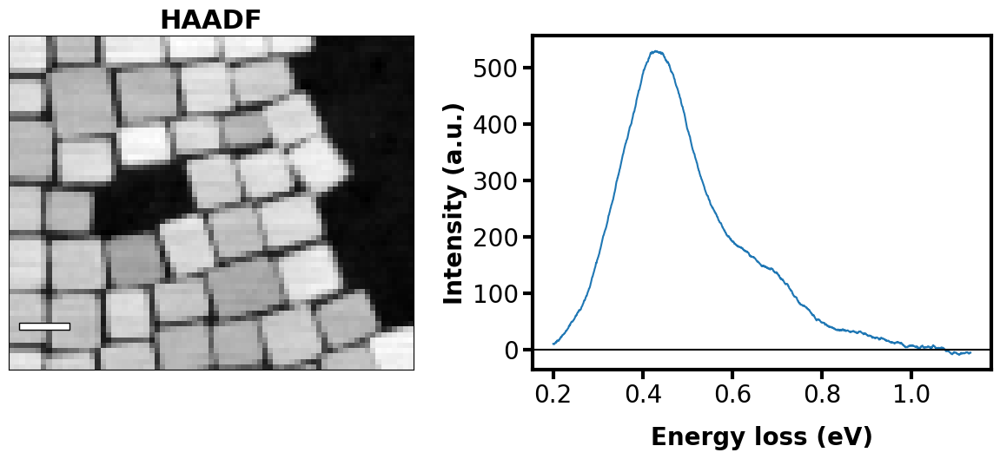

In [8]:
img = loadedfile['image']
specim = loadedfile['spectrum image']
e_ax = loadedfile['energy axis']
imscale = loadedfile['scale']

DisplayAverageData(figsize = (15,5),
                   scalebar = 15)

print(specim.shape)

* Prepare data for ML/DL:

/usr/local/lib/python3.10/dist-packages/atomai/utils/img.py:450: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:275.)
  spectra = torch.tensor(spectra).unsqueeze(1)


((2820, 16, 16), (2820, 46))

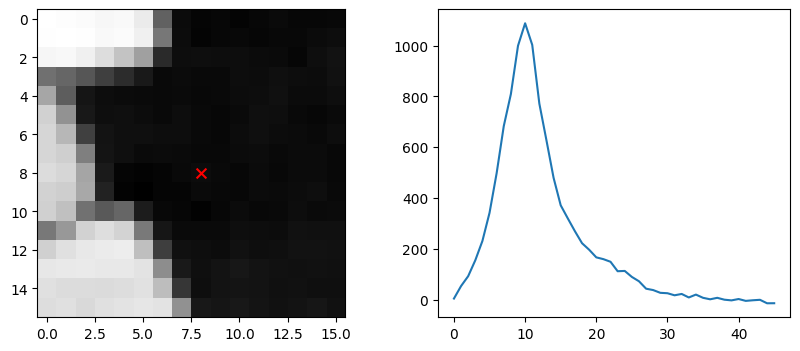

In [9]:
window_size       = 16              # select window size for geometric feature length scales
spectralavg       = 32              # average spectral channels (reduces # of channels significantly --> easier to process! usually don't need 2048 ch, a few hundred I think are sufficient)

coordinates = aoi.utils.get_coord_grid(img, step = 1, return_dict=False)
img_patches, specs, coords = aoi.utils.extract_patches_and_spectra(specim,
                                                                     img,
                                                                     coordinates=coordinates,
                                                                     window_size=window_size,
                                                                    #  band=[0, 2], # average over these slices and use as "structural data"
                                                                     avg_pool=spectralavg)

m = 50

fig,ax=plt.subplots(1,2,figsize=(10,4))
ax[0].imshow(img_patches[m], cmap = 'gray')
ax[1].plot(specs[m])
ax[0].scatter(window_size/2, window_size/2, marker = 'x', c='r', s=50)

img_patches.shape, specs.shape

In [10]:
full_img = np.copy(img)
indices = np.copy(coords)
features = np.copy(img_patches)
targets = np.copy(specs)
scale = np.copy(imscale)
e_scale = np.copy(e_ax[::spectralavg])

# Match the energy scale lengths (this only occurs from the spectral averaging in previous step)
while e_scale.shape[0] > targets[0].shape[0]:
  e_scale = e_scale[:-1]

e_scale.shape, targets[0].shape

((46,), (46,))

# Load and process

In [11]:
%cd "/content"
%mkdir DKL
%cd "DKL"

/content
/content/DKL


Preprocess:

In [12]:
norm_ = lambda x: (x - x.min()) / (x.max() - x.min())
features, targets = norm_(features), norm_(targets)

In [13]:
# Reduce the size of spectra via average pooling (for vector-DKL, the vector size should typically be < 200)
REDUCE = 1
y = torch.from_numpy(targets)[:, None]
y = torch.nn.functional.avg_pool1d(y, 1, 1).squeeze().numpy()

# Flatten image data
n, d1, d2 = features.shape
X = features.reshape(n, d1*d2)

# Transpose so that a spectrum length corresponds to a batch dimension in GP
y = y.T

e_reduced = np.copy(e_scale[::REDUCE])
while e_reduced.shape[0] > y.shape[0]:
  e_reduced = e_reduced[:-1]

# to use a scalar DKL-GPR, just take a single "slice" of y, e.g. y_sc = y[10:11]
print(y.shape, e_reduced.shape)

(46, 2820) (46,)


# DKL-GPR (no active learning)

## Full data

Initialize and train DKL-GPR model on the full dataset:

In [14]:
#!nvidia-smi

In [15]:
#data_dim = X.shape[-1]

#dklgp = aoi.models.dklGPR(data_dim, embedim=2, precision="single")
#dklgp.fit(X, y, training_cycles=100, lr=1e-2)

Sample from the DKL-GP posterior over model outputs at the provided points (X) to compute mean prediction and associated uncertainty for each input image patch (here, we are basically checking how well our model fitted the data):

In [16]:
# samples = dklgp.sample_from_posterior(X, num_samples=1000)
# mean, var = samples.mean(0).T, samples.var(0).T # transpose so that "energy dimension" is the last one

# Alternatively, one can use the following prediction method that allows splitting the test data into mini-batches
# mean, var = dklgp.predict(X, batch_size=len(X))

Plot DKL-GPR prediction for a selected slice:

In [97]:
'''
#k1,k2 = 0,-1 # Specify energy range (in *pixels* not eV), 0 to -1 means full spectrum average
#dkl_pred_full, dkl_unc_full, pred_spec_full, meas_spec_full, mean_full, var_full = plot_DKL_prediction_preacquired_notactive(dklgp,
                                                                                                                             full_img,
                                                                                                                             specim,
                                                                                                                             figsize = (14,8), energy_range = [k1,k2])
'''

'\n#k1,k2 = 0,-1 # Specify energy range (in *pixels* not eV), 0 to -1 means full spectrum average\n#dkl_pred_full, dkl_unc_full, pred_spec_full, meas_spec_full, mean_full, var_full = plot_DKL_prediction_preacquired_notactive(dklgp,\n                                                                                                                             full_img,\n                                                                                                                             specim,\n                                                                                                                             figsize = (14,8), energy_range = [k1,k2])\n'

In [98]:
'''
print(dkl_pred_full.shape)
print(dkl_unc_full.shape)
print(pred_spec_full.shape)
print(meas_spec_full.shape)
print(mean_full.shape)
print(var_full.shape)
'''

'\nprint(dkl_pred_full.shape)\nprint(dkl_unc_full.shape)\nprint(pred_spec_full.shape)\nprint(meas_spec_full.shape)\nprint(mean_full.shape)\nprint(var_full.shape)\n'

* Select two different pixels in space, plot their measured and their predicted (DKL) spectra

In [99]:
'''
i1,j1 = 30, 24
i2,j2 = 30, 58

plt.figure(figsize=(10,5))
ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred_full.shape)

ax.plot(e_reduced, dkl_meas_full[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax.plot(e_reduced, dkl_meas_full[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax.plot(e_reduced, dkl_pred_full[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 1", zorder=1)
ax.plot(e_reduced, dkl_pred_full[i2,j2], linewidth=4, c='crimson', alpha=1, label="Prediction 2", zorder=2)

ax.legend()
leg=ax.legend(fontsize = 20)
for line in leg.get_lines():
  line.set_linewidth(15)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)

for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)
'''

'\ni1,j1 = 30, 24\ni2,j2 = 30, 58\n\nplt.figure(figsize=(10,5))\nax=plt.gca()\n\ndkl_meas_full = y.T.reshape(dkl_pred_full.shape)\n\nax.plot(e_reduced, dkl_meas_full[i1,j1], linewidth=7, c=\'darkorange\', label="Ground truth 1", zorder=0)\nax.plot(e_reduced, dkl_meas_full[i2,j2], linewidth=7, c=\'blue\', label="Ground truth 2", zorder=0)\nax.plot(e_reduced, dkl_pred_full[i1,j1], linewidth=4, c=\'mediumseagreen\', alpha=1, label="Prediction 1", zorder=1)\nax.plot(e_reduced, dkl_pred_full[i2,j2], linewidth=4, c=\'crimson\', alpha=1, label="Prediction 2", zorder=2)\n\nax.legend()\nleg=ax.legend(fontsize = 20)\nfor line in leg.get_lines():\n  line.set_linewidth(15)\n\nax.set_xlabel(\'Energy loss (eV)\', fontsize = 20, labelpad = 15, weight = \'bold\')\nax.set_ylabel(\'Intensity (a.u.)\', fontsize = 20, weight = \'bold\')\nax.tick_params(labelsize = 20, length = 8, width = 3)\n\nfor axis in [\'top\',\'bottom\',\'left\',\'right\']:\n  ax.spines[axis].set_linewidth(3)\n'

* Average energy image (ground truth)

In [100]:
'''
plt.figure(figsize=(9,7))
gs = gridspec.GridSpec(1,1)
ax1 = plt.subplot(gs[0])

ax1.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
ax1.scatter(j1,i1, c='r', s=500, marker = 'X')
ax1.scatter(j2,i2, c='r', s=500, marker = 'X')

ax1.axis('off')
'''

"\nplt.figure(figsize=(9,7))\ngs = gridspec.GridSpec(1,1)\nax1 = plt.subplot(gs[0])\n\nax1.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')\nax1.scatter(j1,i1, c='r', s=500, marker = 'X')\nax1.scatter(j2,i2, c='r', s=500, marker = 'X')\n\nax1.axis('off')\n"

* Embedding layers

In [101]:
#embeded = dklgp.embed(X)
#embeded = embeded / embeded.max()

In [102]:
#_, (ax1, ax2) = plt.subplots(2, 1, figsize=(4.5, 9))
#ax1.scatter(indices[:, 1], indices[:, 0], c=embeded[:, 0], cmap='RdBu')
#ax2.scatter(indices[:, 1], indices[:, 0], c=embeded[:, 1], cmap='RdBu')

### Additional Predictions

In [103]:
'''
i1,j1 = 0, 0
i2,j2 = 3, 23
i3,j3 = 0, 58
i4,j4 = 15, 5
i5,j5 = 20, 18
i6,j6 = 43, 12
i7,j7 = 25, 50
i8,j8 = 45, 45

plt.figure(figsize=(30,14))
gs=gridspec.GridSpec(2,3)
aximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])
# ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred_full.shape)

halfwin = int(window_size/2)

aximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
aximg.scatter(j1+halfwin,i1+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j2+halfwin,i2+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j3+halfwin,i3+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j4+halfwin,i4+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j5+halfwin,i5+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j6+halfwin,i6+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j7+halfwin,i7+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j8+halfwin,i8+halfwin, c='r', s=500, marker = 'X')

# aximg.axis('off')
ax00.plot(e_reduced, dkl_meas_full[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax00.plot(e_reduced, dkl_meas_full[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax00.plot(e_reduced, dkl_pred_full[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 1", zorder=1)
ax00.plot(e_reduced, dkl_pred_full[i2,j2], linewidth=4, c='crimson', alpha=1, label="Prediction 2", zorder=2)

ax01.plot(e_reduced, dkl_meas_full[i3,j3], linewidth=7, c='darkorange', label="Ground truth 3", zorder=0)
ax01.plot(e_reduced, dkl_meas_full[i4,j4], linewidth=7, c='blue', label="Ground truth 4", zorder=0)
ax01.plot(e_reduced, dkl_pred_full[i3,j3], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 3", zorder=1)
ax01.plot(e_reduced, dkl_pred_full[i4,j4], linewidth=4, c='crimson', alpha=1, label="Prediction 4", zorder=2)

ax10.plot(e_reduced, dkl_meas_full[i5,j5], linewidth=7, c='darkorange', label="Ground truth 5", zorder=0)
ax10.plot(e_reduced, dkl_meas_full[i6,j6], linewidth=7, c='blue', label="Ground truth 6", zorder=0)
ax10.plot(e_reduced, dkl_pred_full[i5,j5], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 5", zorder=1)
ax10.plot(e_reduced, dkl_pred_full[i6,j6], linewidth=4, c='crimson', alpha=1, label="Prediction 6", zorder=2)

ax11.plot(e_reduced, dkl_meas_full[i7,j7], linewidth=7, c='darkorange', label="Ground truth 7", zorder=0)
ax11.plot(e_reduced, dkl_meas_full[i8,j8], linewidth=7, c='blue', label="Ground truth 8", zorder=0)
ax11.plot(e_reduced, dkl_pred_full[i7,j7], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 7", zorder=1)
ax11.plot(e_reduced, dkl_pred_full[i8,j8], linewidth=4, c='crimson', alpha=1, label="Prediction 8", zorder=2)

for ax in [ax00,ax01,ax10,ax11]:
    leg=ax.legend(fontsize = 20)
    for line in leg.get_lines():
        line.set_linewidth(15)

    ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
    ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
    ax.tick_params(labelsize = 20, length = 8, width = 3)

    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(3)
'''

'\ni1,j1 = 0, 0\ni2,j2 = 3, 23\ni3,j3 = 0, 58\ni4,j4 = 15, 5\ni5,j5 = 20, 18\ni6,j6 = 43, 12\ni7,j7 = 25, 50\ni8,j8 = 45, 45\n\nplt.figure(figsize=(30,14))\ngs=gridspec.GridSpec(2,3)\naximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])\n# ax=plt.gca()\n\ndkl_meas_full = y.T.reshape(dkl_pred_full.shape)\n\nhalfwin = int(window_size/2)\n\naximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = \'lower\')\naximg.scatter(j1+halfwin,i1+halfwin, c=\'r\', s=500, marker = \'X\')\naximg.scatter(j2+halfwin,i2+halfwin, c=\'r\', s=500, marker = \'X\')\naximg.scatter(j3+halfwin,i3+halfwin, c=\'r\', s=500, marker = \'X\')\naximg.scatter(j4+halfwin,i4+halfwin, c=\'r\', s=500, marker = \'X\')\naximg.scatter(j5+halfwin,i5+halfwin, c=\'r\', s=500, marker = \'X\')\naximg.scatter(j6+halfwin,i6+halfwin, c=\'r\', s=500, marker = \'X\')\naximg.scatter(j7+halfwin,i7+halfwin, c=\'r\', s=500, marker = \'X\')\naximg.scatt

## 10% data

In [104]:
fraction = 0.1

prng = RandomState(33)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

data_dim = X.shape[-1]

X_train = X[indices_partial]
y_train = y.T[indices_partial].T
indices_train = indices[indices_partial]

print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 282/2820 data points


In [26]:
dklgp10 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp10.fit(X_train, y_train, training_cycles=200, lr=1e-2)

/usr/local/lib/python3.10/dist-packages/torch/__init__.py:696: UserWarning: torch.set_default_tensor_type() is deprecated as of PyTorch 2.1, please use torch.set_default_dtype() and torch.set_default_device() as alternatives. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:451.)
  _C._set_default_tensor_type(t)
/usr/local/lib/python3.10/dist-packages/linear_operator/utils/interpolation.py:71: UserWarning: The torch.cuda.*DtypeTensor constructors are no longer recommended. It's best to use methods such as torch.tensor(data, dtype=*, device='cuda') to create tensors. (Triggered internally at ../torch/csrc/tensor/python_tensor.cpp:83.)
  summing_matrix = cls(summing_matrix_indices, summing_matrix_values, size)
/usr/local/lib/python3.10/dist-packages/linear_operator/utils/interpolation.py:71: UserWarning: torch.sparse.SparseTensor(indices, values, shape, *, device=) is deprecated.  Please use torch.sparse_coo_tensor(indices, values, shape, dtype=, device=). (Triggered inter

Epoch 1/200 ... Training loss: 34.9423
Epoch 10/200 ... Training loss: 33.3124
Epoch 20/200 ... Training loss: 31.5613
Epoch 30/200 ... Training loss: 29.7241
Epoch 40/200 ... Training loss: 27.8812
Epoch 50/200 ... Training loss: 25.9975
Epoch 60/200 ... Training loss: 24.0696
Epoch 70/200 ... Training loss: 22.0964
Epoch 80/200 ... Training loss: 20.0783
Epoch 90/200 ... Training loss: 18.0188
Epoch 100/200 ... Training loss: 15.9191
Epoch 110/200 ... Training loss: 13.7805
Epoch 120/200 ... Training loss: 11.6097
Epoch 130/200 ... Training loss: 9.4095
Epoch 140/200 ... Training loss: 7.1816
Epoch 150/200 ... Training loss: 4.9288
Epoch 160/200 ... Training loss: 2.6535
Epoch 170/200 ... Training loss: 0.3573
Epoch 180/200 ... Training loss: -1.9618
Epoch 190/200 ... Training loss: -4.2972
Epoch 200/200 ... Training loss: -6.6224


Plot DKL-GPR prediction for a selected slice:

/usr/local/lib/python3.10/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-10.
  warnings.warn(


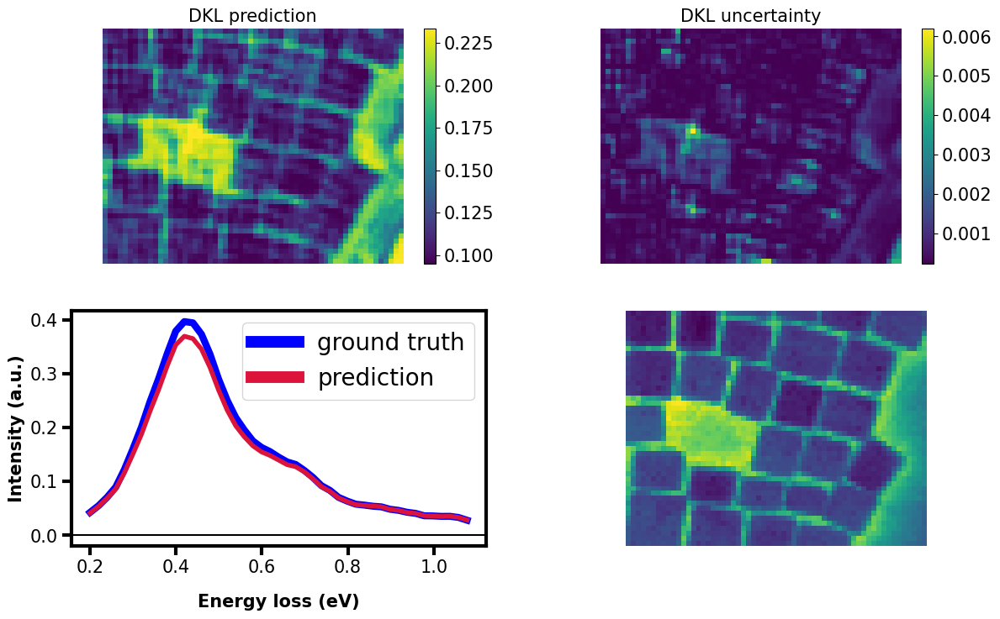

In [27]:
k1,k2 = 0,-1
dkl_pred10, dkl_unc10, pred_spec10, meas_spec10, mean10, var10 = plot_DKL_prediction_preacquired_notactive(dklgp10,
                                                                                                           full_img,
                                                                                                           specim,
                                                                                                           figsize = (14,8),
                                                                                                           energy_range = [k1,k2])

In [28]:
print(dkl_pred10.shape)
print(dkl_unc10.shape)
print(pred_spec10.shape)
print(meas_spec10.shape)
print(mean10.shape)
print(var10.shape)

(47, 60, 46)
(47, 60, 46)
(45,)
(45,)
(2820, 46)
(2820, 46)


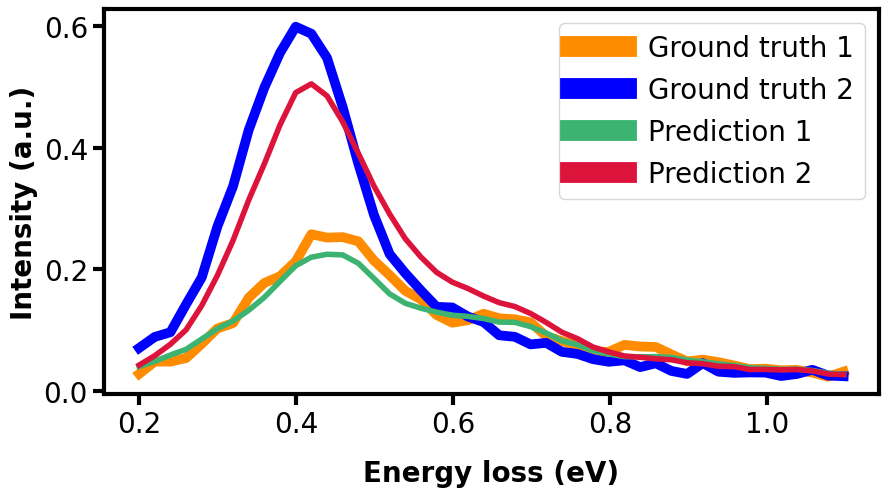

In [29]:
i1,j1 = 30, 24
i2,j2 = 30, 58

plt.figure(figsize=(10,5))
ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred10.shape)

ax.plot(e_reduced, dkl_meas_full[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax.plot(e_reduced, dkl_meas_full[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax.plot(e_reduced,dkl_pred10[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 1", zorder=1)
ax.plot(e_reduced,dkl_pred10[i2,j2], linewidth=4, c='crimson', alpha=1, label="Prediction 2", zorder=2)

ax.legend()
leg=ax.legend(fontsize = 20)
for line in leg.get_lines():
  line.set_linewidth(15)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)

for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)

* Embedding layers

In [30]:
embeded10 = dklgp10.embed(X)
embeded10 = embeded10 / embeded10.max()

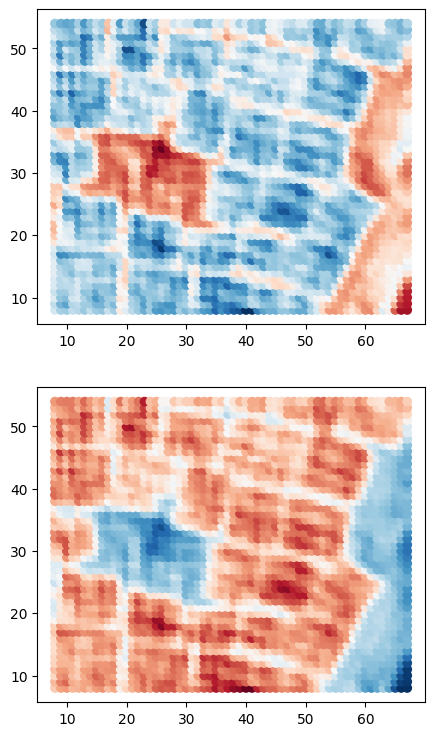

In [31]:
_, (ax1, ax2) = plt.subplots(2, 1, figsize=(5, 9))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded10[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded10[:, 1], cmap='RdBu')

## 3% data

In [32]:
fraction = 0.03

prng = RandomState(22)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

X_train = X[indices_partial]
y_train = y.T[indices_partial].T
indices_train = indices[indices_partial]
print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 84/2820 data points


In [33]:
dklgp03 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp03.fit(X_train, y_train, training_cycles=200, lr=1e-2)

Epoch 1/200 ... Training loss: 35.9821
Epoch 10/200 ... Training loss: 34.1709
Epoch 20/200 ... Training loss: 32.4158
Epoch 30/200 ... Training loss: 30.6359
Epoch 40/200 ... Training loss: 28.7033
Epoch 50/200 ... Training loss: 26.7454
Epoch 60/200 ... Training loss: 24.7829
Epoch 70/200 ... Training loss: 22.7837
Epoch 80/200 ... Training loss: 20.7434
Epoch 90/200 ... Training loss: 18.6718
Epoch 100/200 ... Training loss: 16.5753
Epoch 110/200 ... Training loss: 14.4571
Epoch 120/200 ... Training loss: 12.3061
Epoch 130/200 ... Training loss: 10.1068
Epoch 140/200 ... Training loss: 7.8598
Epoch 150/200 ... Training loss: 5.5764
Epoch 160/200 ... Training loss: 3.2712
Epoch 170/200 ... Training loss: 0.9508
Epoch 180/200 ... Training loss: -1.3846
Epoch 190/200 ... Training loss: -3.7322
Epoch 200/200 ... Training loss: -6.0901


Plot DKL-GPR prediction for a selected slice:

/usr/local/lib/python3.10/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-10.
  warnings.warn(


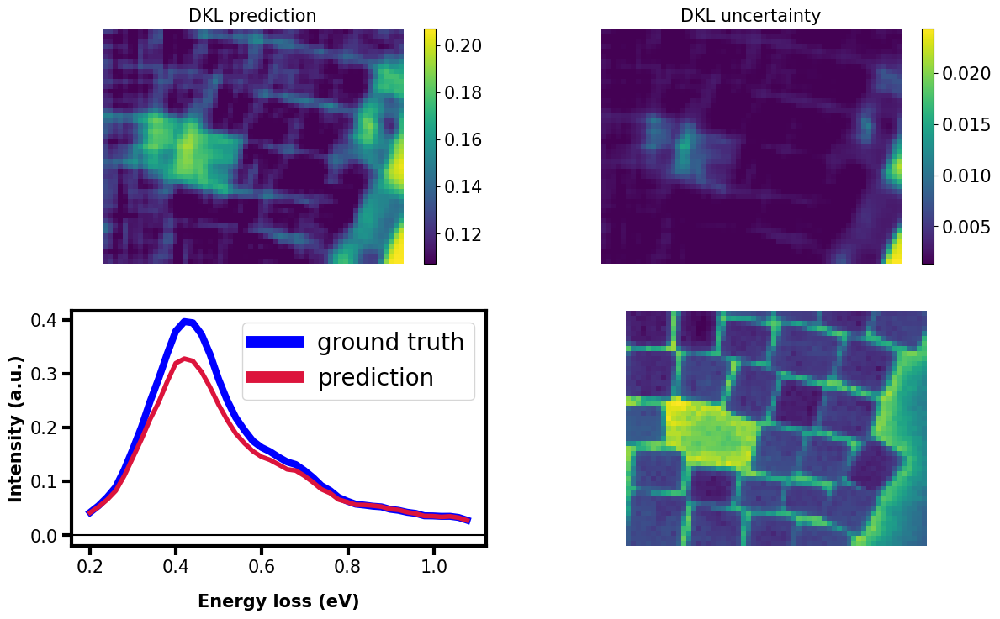

In [34]:
k1,k2 = 0,-1
dkl_pred03, dkl_unc03, pred_spec03, meas_spec03, mean03, var03 = plot_DKL_prediction_preacquired_notactive(dklgp03,
                                                                                                           full_img,
                                                                                                           specim,
                                                                                                           figsize = (14,8),
                                                                                                           energy_range = [k1,k2])

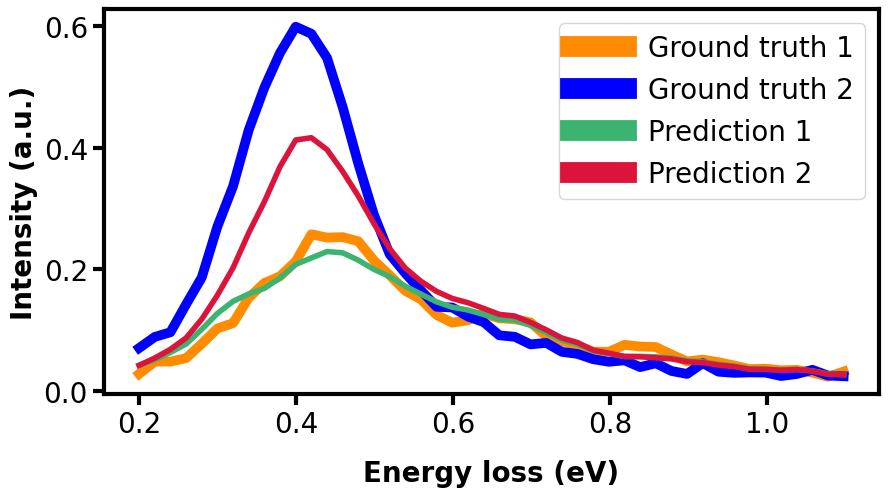

In [35]:
i1,j1 = 30, 24
i2,j2 = 30, 58

plt.figure(figsize=(10,5))
ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred03.shape)

ax.plot(e_reduced, dkl_meas_full[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax.plot(e_reduced, dkl_meas_full[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax.plot(e_reduced,dkl_pred03[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 1", zorder=1)
ax.plot(e_reduced,dkl_pred03[i2,j2], linewidth=4, c='crimson', alpha=1, label="Prediction 2", zorder=2)

ax.legend()
leg=ax.legend(fontsize = 20)
for line in leg.get_lines():
  line.set_linewidth(15)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)

for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)

In [36]:
embeded03 = dklgp03.embed(X)
embeded03 = embeded03 / embeded03.max()

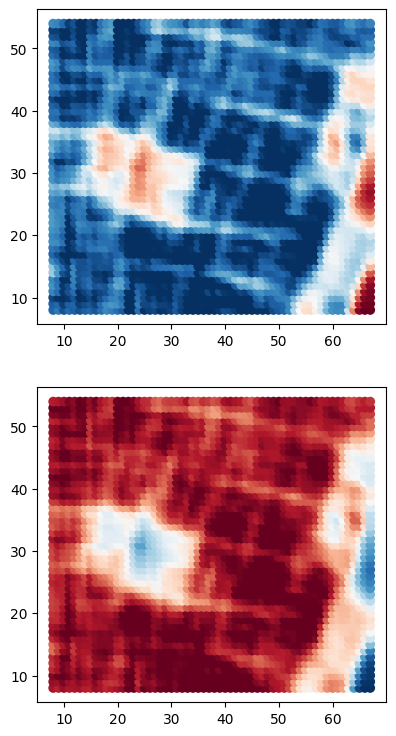

In [37]:
_, (ax1, ax2) = plt.subplots(2, 1, figsize=(4.5, 9))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded03[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded03[:, 1], cmap='RdBu')

## 1% data

In [38]:
fraction = 0.01
prng = RandomState(42)
indices_partial = prng.choice(len(indices), size=int(fraction*len(indices)), replace=False)

X_train = X[indices_partial]
y_train = y.T[indices_partial].T
indices_train = indices[indices_partial]
print("Training with {}/{} data points".format(len(indices_train), len(indices)))

Training with 28/2820 data points


In [39]:
dklgp01 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp01.fit(X_train, y_train, training_cycles=200, lr=1e-2)

Epoch 1/200 ... Training loss: 37.7669
Epoch 10/200 ... Training loss: 36.1523
Epoch 20/200 ... Training loss: 34.201
Epoch 30/200 ... Training loss: 32.2952
Epoch 40/200 ... Training loss: 30.3522
Epoch 50/200 ... Training loss: 28.6343
Epoch 60/200 ... Training loss: 26.3745
Epoch 70/200 ... Training loss: 24.3249
Epoch 80/200 ... Training loss: 22.2196
Epoch 90/200 ... Training loss: 20.0913
Epoch 100/200 ... Training loss: 17.911
Epoch 110/200 ... Training loss: 15.7274
Epoch 120/200 ... Training loss: 13.5271
Epoch 130/200 ... Training loss: 11.3093
Epoch 140/200 ... Training loss: 9.0749
Epoch 150/200 ... Training loss: 6.85
Epoch 160/200 ... Training loss: 4.5601
Epoch 170/200 ... Training loss: 2.2784
Epoch 180/200 ... Training loss: -0.0056
Epoch 190/200 ... Training loss: -2.2924
Epoch 200/200 ... Training loss: -4.5843


Plot DKL-GPR prediction for a selected slice:

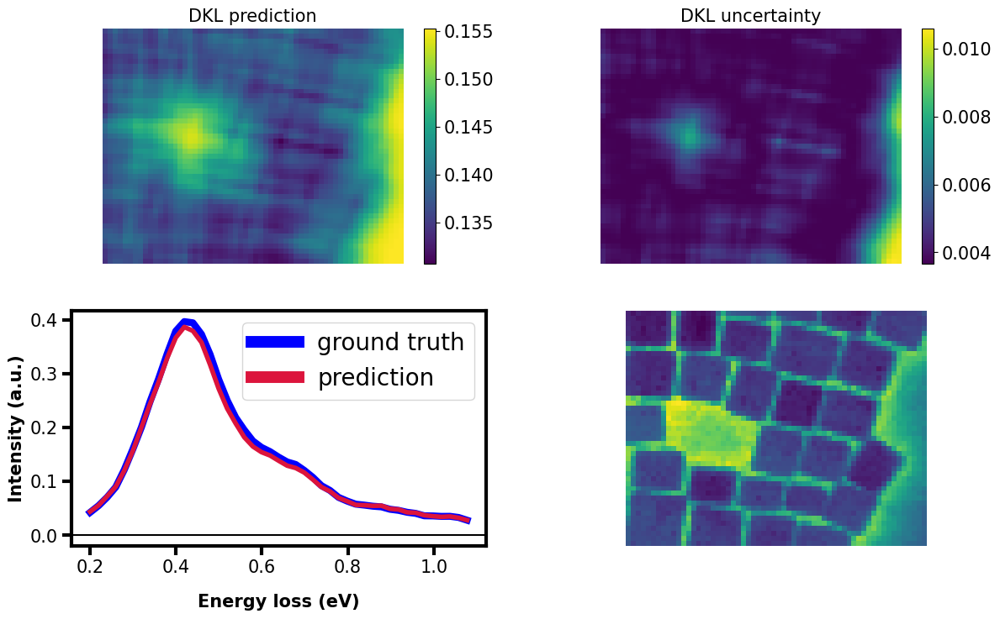

In [40]:
k1,k2 = 0,-1
dkl_pred01, dkl_unc01, pred_spec01, meas_spec01, mean01, var01 = plot_DKL_prediction_preacquired_notactive(dklgp01,
                                                                                                           full_img,
                                                                                                           specim,
                                                                                                           figsize = (14,8),
                                                                                                           energy_range = [k1,k2])

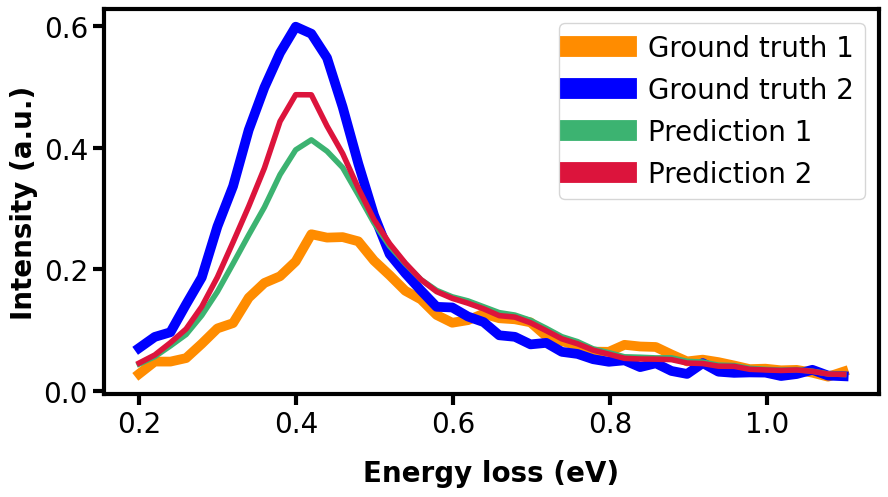

In [41]:
i1,j1 = 30, 24
i2,j2 = 30, 58

plt.figure(figsize=(10,5))
ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred01.shape)

ax.plot(e_reduced, dkl_meas_full[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax.plot(e_reduced, dkl_meas_full[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax.plot(e_reduced,dkl_pred01[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="Prediction 1", zorder=1)
ax.plot(e_reduced,dkl_pred01[i2,j2], linewidth=4, c='crimson', alpha=1, label="Prediction 2", zorder=2)

ax.legend()
leg=ax.legend(fontsize = 20)
for line in leg.get_lines():
  line.set_linewidth(15)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)

for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)

* Embedding layers

In [42]:
embeded01 = dklgp01.embed(X)
embeded01 = embeded01 / embeded01.max()

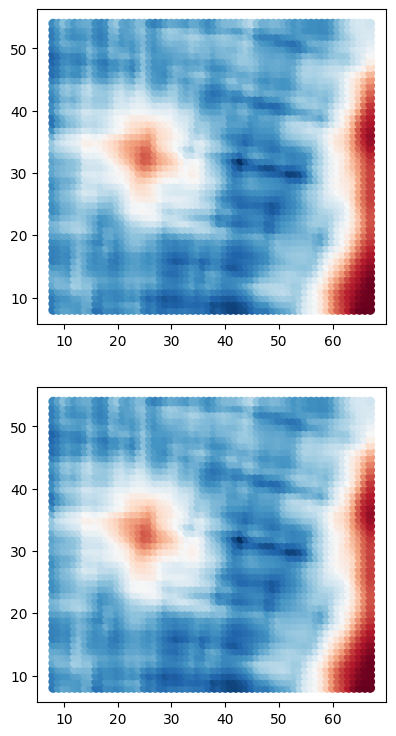

In [43]:
_, (ax1, ax2) = plt.subplots(2, 1, figsize=(4.5, 9))
ax1.scatter(indices[:, 1], indices[:, 0], c=embeded01[:, 0], cmap='RdBu')
ax2.scatter(indices[:, 1], indices[:, 0], c=embeded01[:, 1], cmap='RdBu')

### Collect results

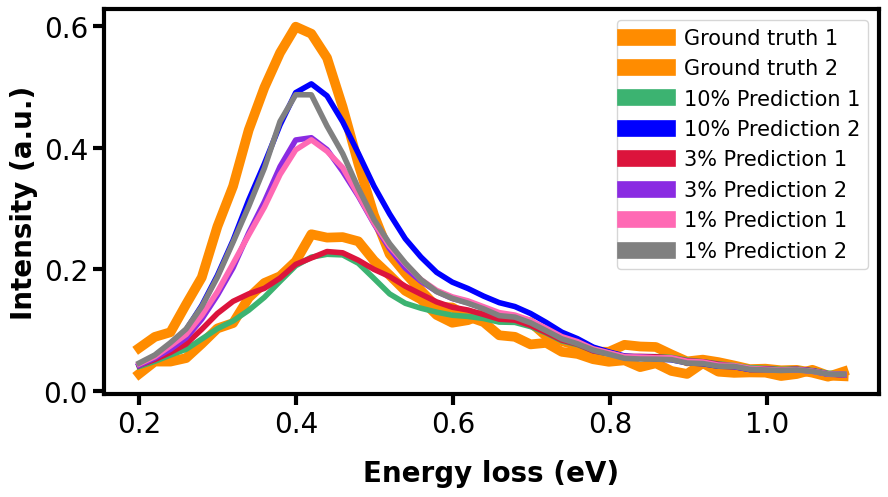

In [44]:
plt.figure(figsize=(10,5))
ax=plt.gca()


ax.plot(e_reduced, dkl_meas_full[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax.plot(e_reduced, dkl_meas_full[i2,j2], linewidth=7, c='darkorange', label="Ground truth 2", zorder=0)
ax.plot(e_reduced,dkl_pred10[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="10% Prediction 1", zorder=1)
ax.plot(e_reduced,dkl_pred10[i2,j2], linewidth=4, c='blue', alpha=1, label="10% Prediction 2", zorder=1)
ax.plot(e_reduced,dkl_pred03[i1,j1], linewidth=4, c='crimson', alpha=1, label="3% Prediction 1", zorder=1)
ax.plot(e_reduced,dkl_pred03[i2,j2], linewidth=4, c='blueviolet', alpha=1, label="3% Prediction 2", zorder=1)
ax.plot(e_reduced,dkl_pred01[i1,j1], linewidth=4, c='hotpink', alpha=1, label="1% Prediction 1", zorder=1)
ax.plot(e_reduced,dkl_pred01[i2,j2], linewidth=4, c='gray', alpha=1, label="1% Prediction 2", zorder=1)
ax.legend()

leg=ax.legend(fontsize = 15)
for line in leg.get_lines():
  line.set_linewidth(12)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)

for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)

* Average prediction

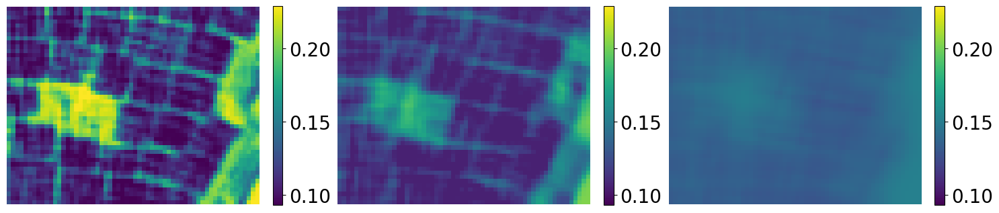

In [45]:
cmax = np.asarray([np.mean(dkl_pred10, axis = 2), np.mean(dkl_pred03, axis = 2), np.mean(dkl_pred01, axis = 2)]).max()
cmin = np.asarray([np.mean(dkl_pred10, axis = 2), np.mean(dkl_pred03, axis = 2), np.mean(dkl_pred01, axis = 2)]).min()

cmin,cmax

plt.figure(figsize=(18,7))
gs = gridspec.GridSpec(1,3)
ax1,ax2,ax3 = plt.subplot(gs[0]), plt.subplot(gs[1]), plt.subplot(gs[2])

im1 = ax1.imshow(np.mean(dkl_pred10, axis = 2), origin = 'lower', vmin = cmin, vmax = cmax)
im2 = ax2.imshow(np.mean(dkl_pred03, axis = 2), origin = 'lower', vmin = cmin, vmax = cmax)
im3 = ax3.imshow(np.mean(dkl_pred01, axis = 2), origin = 'lower', vmin = cmin, vmax = cmax)

cbar1 = plt.colorbar(im1, ax = ax1, fraction = 0.036)
cbar2 = plt.colorbar(im2, ax = ax2, fraction = 0.036)
cbar3 = plt.colorbar(im3, ax = ax3, fraction = 0.036)

cbar1.ax.tick_params(labelsize = 20)
cbar2.ax.tick_params(labelsize = 20)
cbar3.ax.tick_params(labelsize = 20)

ax1.axis('off'), ax2.axis('off'), ax3.axis('off');

Average uncertainty

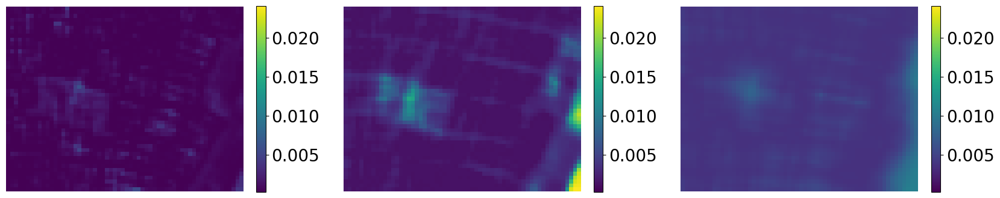

In [46]:
cmax = np.asarray([np.mean(dkl_unc10, axis = 2), np.mean(dkl_unc03, axis = 2), np.mean(dkl_unc01, axis = 2)]).max()
cmin = np.asarray([np.mean(dkl_unc10, axis = 2), np.mean(dkl_unc03, axis = 2), np.mean(dkl_unc01, axis = 2)]).min()

cmin,cmax

plt.figure(figsize=(20,7))
gs = gridspec.GridSpec(1,3, wspace = 0.3)
ax1,ax2,ax3 = plt.subplot(gs[0]), plt.subplot(gs[1]), plt.subplot(gs[2])

im1 = ax1.imshow(np.mean(dkl_unc10, axis = 2), origin = 'lower', vmin = cmin, vmax = cmax)
im2 = ax2.imshow(np.mean(dkl_unc03, axis = 2), origin = 'lower', vmin = cmin, vmax = cmax)
im3 = ax3.imshow(np.mean(dkl_unc01, axis = 2), origin = 'lower', vmin = cmin, vmax = cmax)

cbar1 = plt.colorbar(im1, ax = ax1, fraction = 0.036)
cbar2 = plt.colorbar(im2, ax = ax2, fraction = 0.036)
cbar3 = plt.colorbar(im3, ax = ax3, fraction = 0.036)

cbar1.ax.tick_params(labelsize = 20)
cbar2.ax.tick_params(labelsize = 20)
cbar3.ax.tick_params(labelsize = 20)

ax1.axis('off'), ax2.axis('off'), ax3.axis('off');

* Big fig

In [47]:
cmin, cmax

(0.00023601925449875366, 0.02403013608737988)

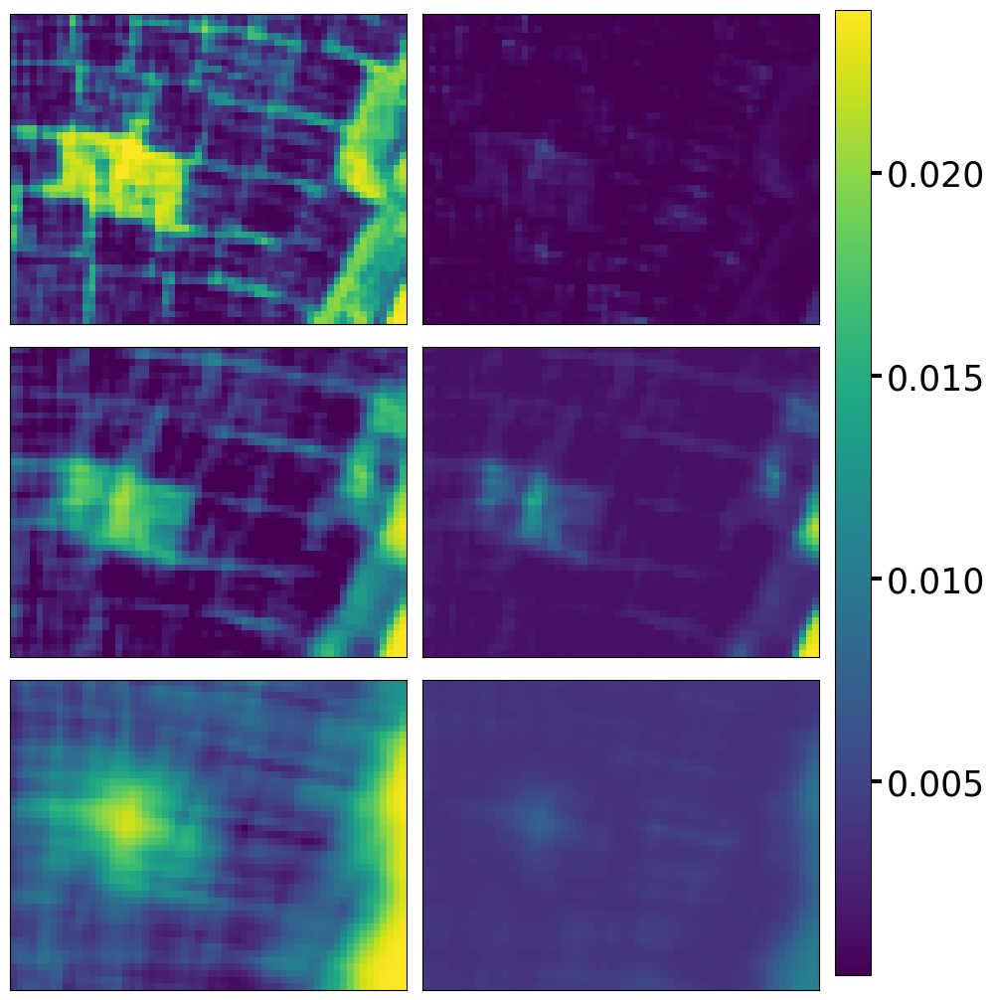

In [48]:
Preds = [dkl_pred10.mean(2), dkl_pred03.mean(2), dkl_pred01.mean(2)]
Uncertains = [dkl_unc10.mean(2), dkl_unc03.mean(2), dkl_unc01.mean(2)]

###############################################################
fig = plt.figure(figsize=(10.5,13))
gs = gridspec.GridSpec(3,2, wspace = 0.04, hspace = 0.01)

for ii in range(3):
    ax = fig.add_subplot(gs[ii,0])
    ax.imshow(Preds[ii], origin = 'lower')
    plt.setp(ax, xticks=[], yticks=[])
for ii in range(3):
    ax = fig.add_subplot(gs[ii,1])
    im = ax.imshow(Uncertains[ii], origin = 'lower', vmin = cmin, vmax = cmax)
    plt.setp(ax, xticks=[], yticks=[])




cbar_ax = fig.add_axes([0.915, 0.129, 0.035, 0.747])
fig.colorbar(im, cax=cbar_ax)
cbar_ax.tick_params(labelsize = 25, width = 3, length = 8)

# Active learning

* This is where physics is embedded into the model!
* We need to define a function that will scalarize our vector-valued acquisition function. Here, we simply take an average over a selected energy band
* However this can be anything we can imagine that can be done to the spectrum

In [49]:
def scalarize_acq(obj: np.ndarray) -> np.ndarray:
    """
    Scalarize acquisition function (n_samples x vector_size)
    by averaging over a selected energy band.
    """
    band = [0, -1]
    obj = obj[:, band[0]:band[1]].mean(-1)
    return obj

We start with a small number (2) of randomly sampled measurements and use DKL-GPR predictions to guide the sample exploration via pre-defined acquisition functions:

In [50]:
# Here X_train and y_train are our measured image patches (HAADF) and spectra/peaks (EELS),
# whereas X_test and y_test are the "unknown" ones. The indices_train are grid coordinates of the measured points,
# whereas the indices_test are the grid coordinates of the remaining available points on the grid

(X_train, X_test, y_train, y_test,
 indices_train, indices_test) = train_test_split(
     X, y.T, indices, test_size=0.999, shuffle=True, random_state=20)

# The targets for the DKL-GPR must have vector_size x n_samples dimensions where vector_size is equal to spectral length
y_train = y_train.T
y_test = y_test.T

print(X_train.shape) # n_samples x n_features
print(y_train.shape) # vector_size x n_samples

(2, 256)
(46, 2)


Run the "experiment":

* Note, if you prefer to skip ahead and not wait for this training, please go to the next section titled "**Load and reconstruct**"

In [51]:
# Memory dump if (GPU) memory usage is high

# import gc
# dklgp_new = None
# gc.collect()
# torch.cuda.empty_cache()
# with torch.no_grad():
#     torch.cuda.empty_cache()

1/40
Epoch 1/20 ... Training loss: 44.1651
Epoch 10/20 ... Training loss: 41.9784
Epoch 20/20 ... Training loss: 39.7602


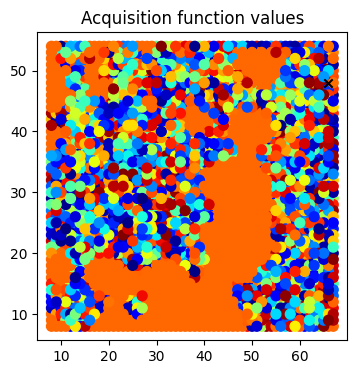

2/40
Epoch 1/20 ... Training loss: 44.4167
Epoch 10/20 ... Training loss: 42.6008
Epoch 20/20 ... Training loss: 39.9796


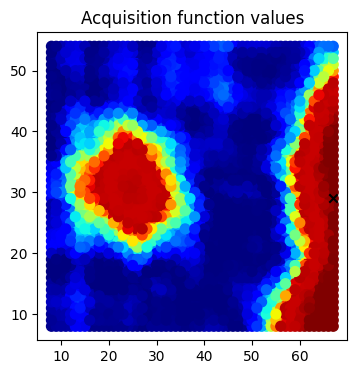

3/40
Epoch 1/20 ... Training loss: 43.5197
Epoch 10/20 ... Training loss: 41.8909
Epoch 20/20 ... Training loss: 39.6328


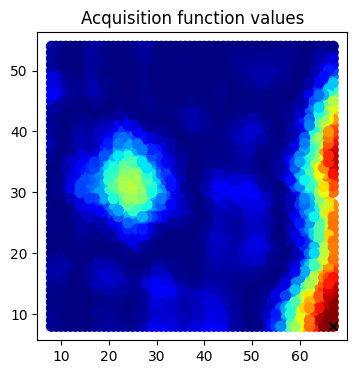

4/40
Epoch 1/20 ... Training loss: 42.972
Epoch 10/20 ... Training loss: 41.8646
Epoch 20/20 ... Training loss: 39.506


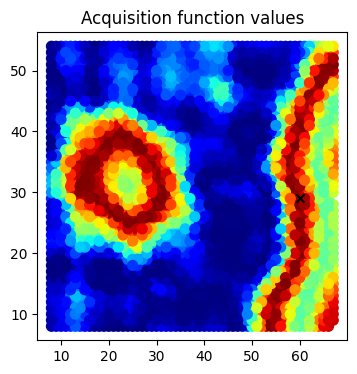

5/40
Epoch 1/20 ... Training loss: 42.2976
Epoch 10/20 ... Training loss: 41.3005
Epoch 20/20 ... Training loss: 39.044


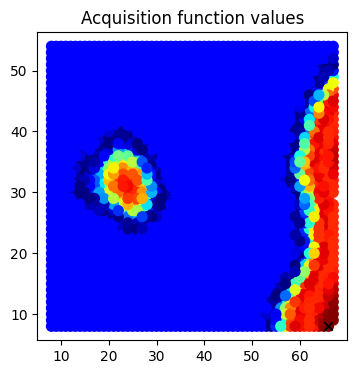

6/40
Epoch 1/20 ... Training loss: 41.7715
Epoch 10/20 ... Training loss: 40.5142
Epoch 20/20 ... Training loss: 38.5609


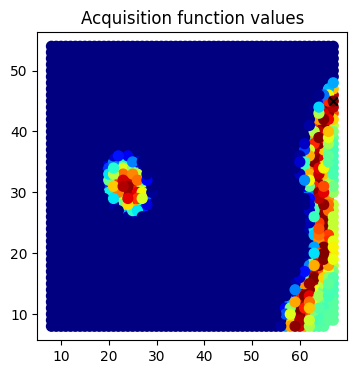

7/40
Epoch 1/20 ... Training loss: 41.4755
Epoch 10/20 ... Training loss: 40.3829
Epoch 20/20 ... Training loss: 38.178


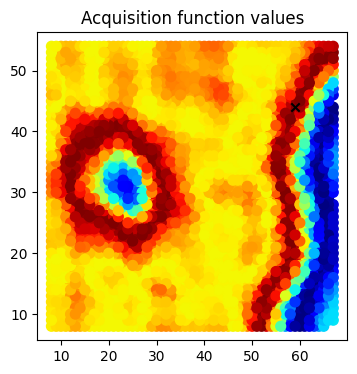

8/40
Epoch 1/20 ... Training loss: 41.2685
Epoch 10/20 ... Training loss: 40.1912
Epoch 20/20 ... Training loss: 37.8831


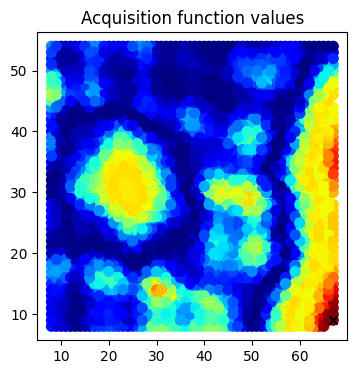

9/40
Epoch 1/20 ... Training loss: 40.8944
Epoch 10/20 ... Training loss: 39.4043
Epoch 20/20 ... Training loss: 37.4761


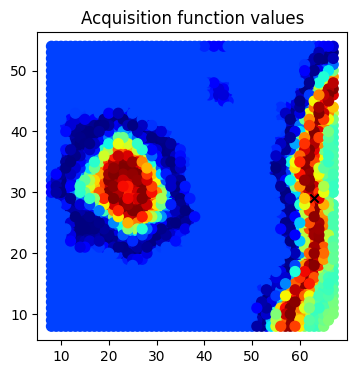

10/40
Epoch 1/20 ... Training loss: 40.6452
Epoch 10/20 ... Training loss: 39.0451
Epoch 20/20 ... Training loss: 37.2043


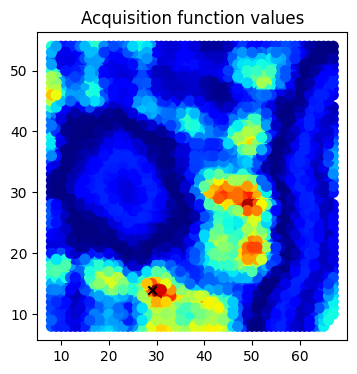

11/40
Epoch 1/20 ... Training loss: 40.3236
Epoch 10/20 ... Training loss: 39.0537
Epoch 20/20 ... Training loss: 37.01


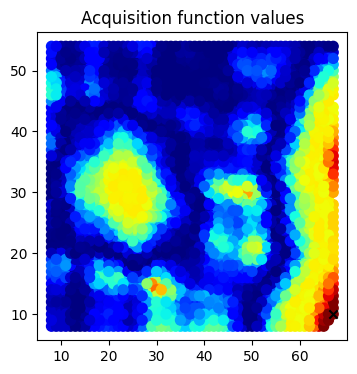

12/40
Epoch 1/20 ... Training loss: 40.0735
Epoch 10/20 ... Training loss: 38.9357
Epoch 20/20 ... Training loss: 36.7779


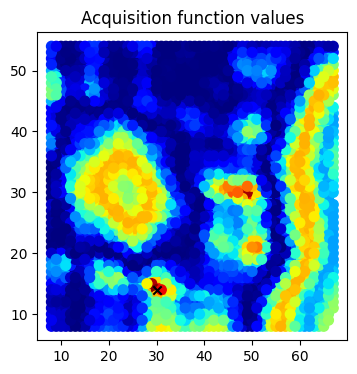

13/40
Epoch 1/20 ... Training loss: 39.8249
Epoch 10/20 ... Training loss: 38.6561
Epoch 20/20 ... Training loss: 36.6964


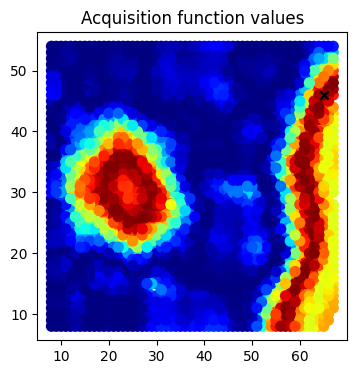

14/40
Epoch 1/20 ... Training loss: 39.6506
Epoch 10/20 ... Training loss: 38.4175
Epoch 20/20 ... Training loss: 36.4432


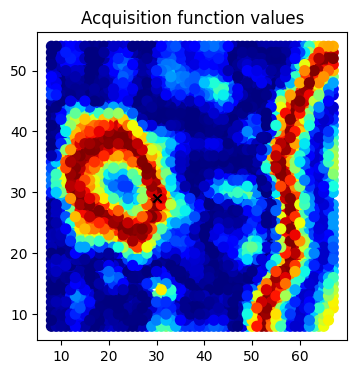

15/40
Epoch 1/20 ... Training loss: 39.4579
Epoch 10/20 ... Training loss: 38.2246
Epoch 20/20 ... Training loss: 36.1634


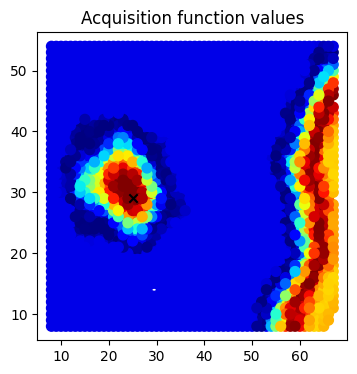

16/40
Epoch 1/20 ... Training loss: 39.2792
Epoch 10/20 ... Training loss: 37.7524
Epoch 20/20 ... Training loss: 35.8176


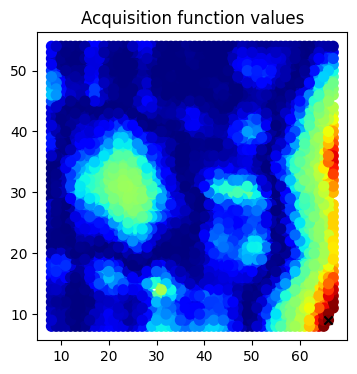

17/40
Epoch 1/20 ... Training loss: 39.1114
Epoch 10/20 ... Training loss: 37.9337
Epoch 20/20 ... Training loss: 35.8194


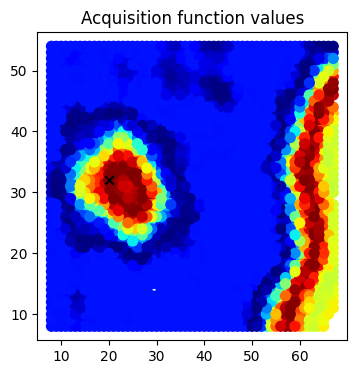

18/40
Epoch 1/20 ... Training loss: 38.9724
Epoch 10/20 ... Training loss: 37.4221
Epoch 20/20 ... Training loss: 35.7985


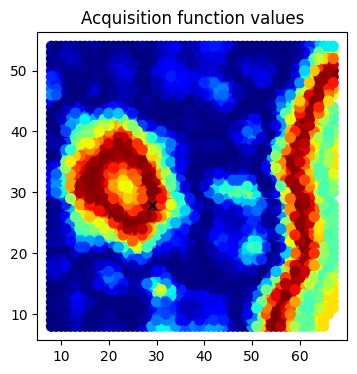

19/40
Epoch 1/20 ... Training loss: 38.8478
Epoch 10/20 ... Training loss: 37.904
Epoch 20/20 ... Training loss: 35.7345


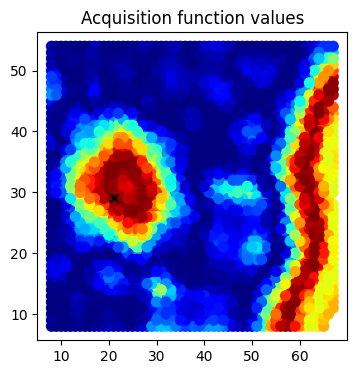

20/40
Epoch 1/20 ... Training loss: 38.7886
Epoch 10/20 ... Training loss: 37.5258
Epoch 20/20 ... Training loss: 35.5078


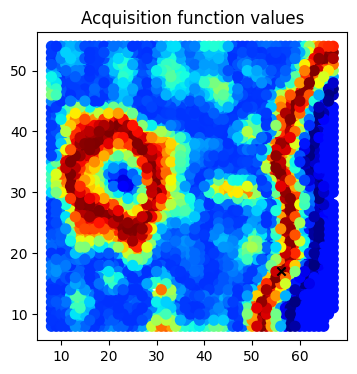

21/40
Epoch 1/20 ... Training loss: 38.6618
Epoch 10/20 ... Training loss: 37.4984
Epoch 20/20 ... Training loss: 35.4467


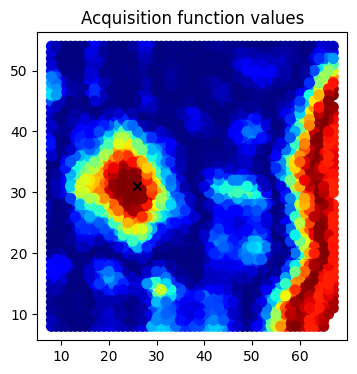

22/40
Epoch 1/20 ... Training loss: 38.5272
Epoch 10/20 ... Training loss: 37.3228
Epoch 20/20 ... Training loss: 35.3294


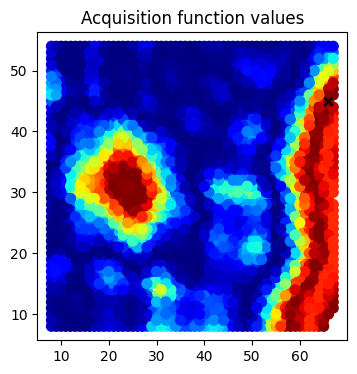

23/40
Epoch 1/20 ... Training loss: 38.4597
Epoch 10/20 ... Training loss: 36.8438
Epoch 20/20 ... Training loss: 35.1963


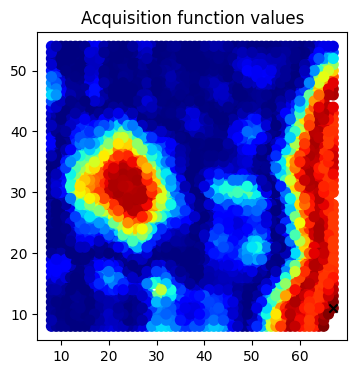

24/40
Epoch 1/20 ... Training loss: 38.3575
Epoch 10/20 ... Training loss: 36.7785
Epoch 20/20 ... Training loss: 34.8587


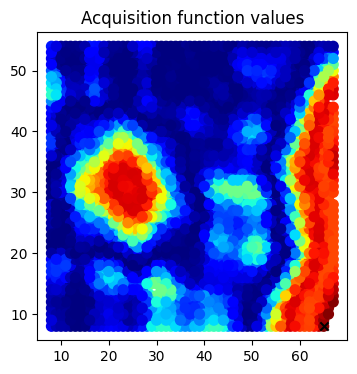

25/40
Epoch 1/20 ... Training loss: 38.2555
Epoch 10/20 ... Training loss: 37.0025
Epoch 20/20 ... Training loss: 34.8195


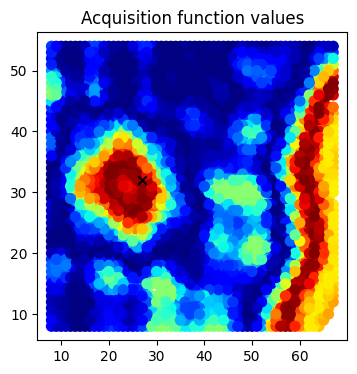

26/40
Epoch 1/20 ... Training loss: 38.1576
Epoch 10/20 ... Training loss: 36.7015
Epoch 20/20 ... Training loss: 34.8293


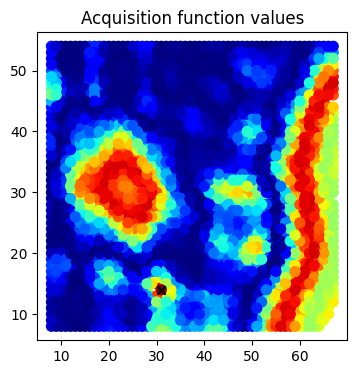

27/40
Epoch 1/20 ... Training loss: 38.095
Epoch 10/20 ... Training loss: 36.597
Epoch 20/20 ... Training loss: 34.9353


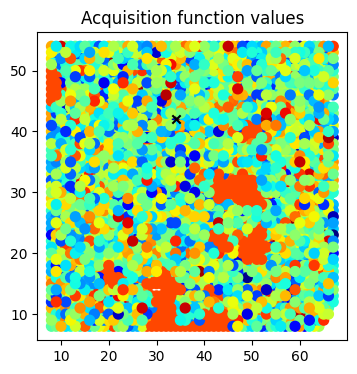

28/40
Epoch 1/20 ... Training loss: 38.0169
Epoch 10/20 ... Training loss: 36.7023
Epoch 20/20 ... Training loss: 34.6149


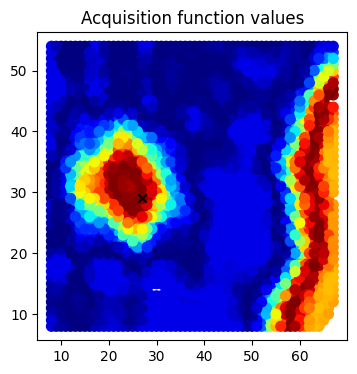

29/40
Epoch 1/20 ... Training loss: 37.9238
Epoch 10/20 ... Training loss: 36.753
Epoch 20/20 ... Training loss: 34.7008


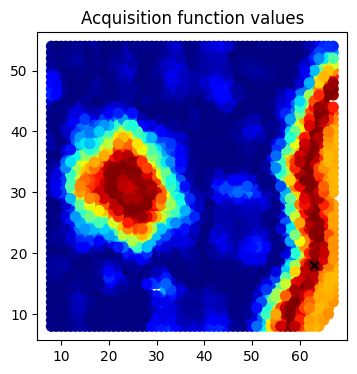

30/40
Epoch 1/20 ... Training loss: 37.8452
Epoch 10/20 ... Training loss: 36.4291
Epoch 20/20 ... Training loss: 34.5356


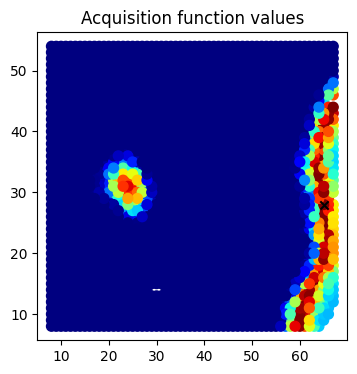

31/40
Epoch 1/20 ... Training loss: 37.772
Epoch 10/20 ... Training loss: 36.2846
Epoch 20/20 ... Training loss: 34.3681


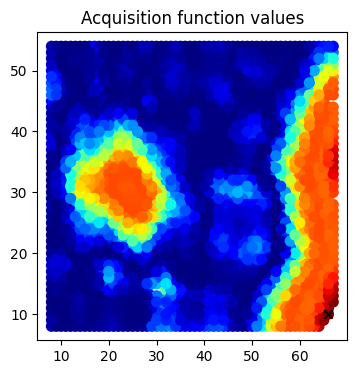

32/40
Epoch 1/20 ... Training loss: 37.7029
Epoch 10/20 ... Training loss: 36.2593
Epoch 20/20 ... Training loss: 34.1963


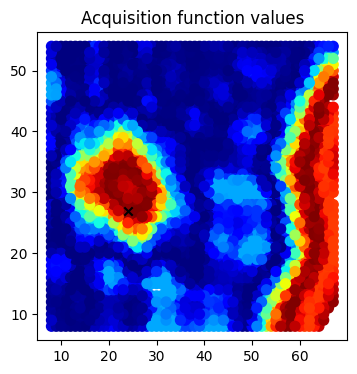

33/40
Epoch 1/20 ... Training loss: 37.6573
Epoch 10/20 ... Training loss: 35.9061
Epoch 20/20 ... Training loss: 34.384


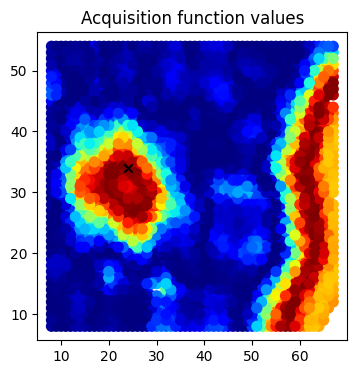

34/40
Epoch 1/20 ... Training loss: 37.6228
Epoch 10/20 ... Training loss: 36.2906
Epoch 20/20 ... Training loss: 34.114


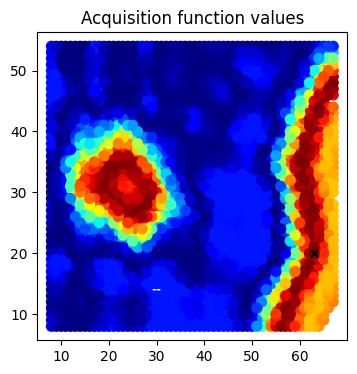

35/40
Epoch 1/20 ... Training loss: 37.6026
Epoch 10/20 ... Training loss: 36.1932
Epoch 20/20 ... Training loss: 34.2231


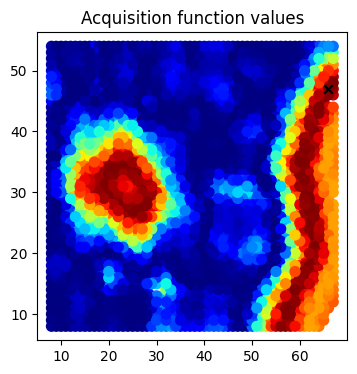

36/40
Epoch 1/20 ... Training loss: 37.5713
Epoch 10/20 ... Training loss: 36.1877
Epoch 20/20 ... Training loss: 33.9064


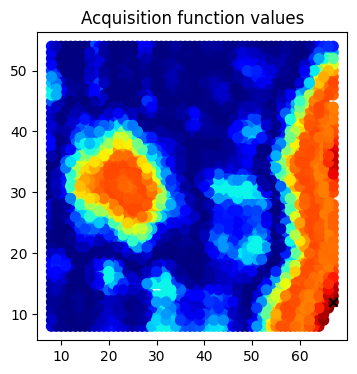

37/40
Epoch 1/20 ... Training loss: 37.5131
Epoch 10/20 ... Training loss: 36.0816
Epoch 20/20 ... Training loss: 34.0596


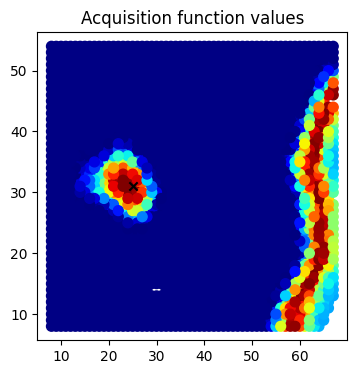

38/40
Epoch 1/20 ... Training loss: 37.4579
Epoch 10/20 ... Training loss: 36.0143
Epoch 20/20 ... Training loss: 34.1257


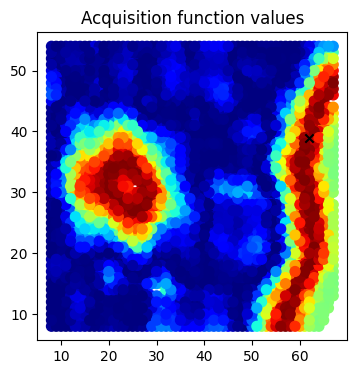

39/40
Epoch 1/20 ... Training loss: 37.3942
Epoch 10/20 ... Training loss: 35.6449
Epoch 20/20 ... Training loss: 33.7902


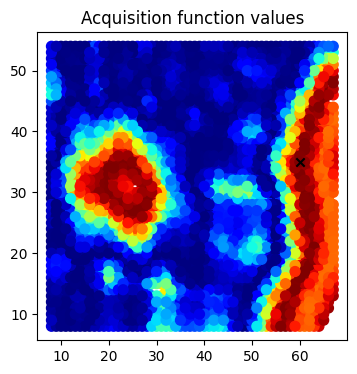

40/40
Epoch 1/20 ... Training loss: 37.3302
Epoch 10/20 ... Training loss: 35.6304
Epoch 20/20 ... Training loss: 33.9517


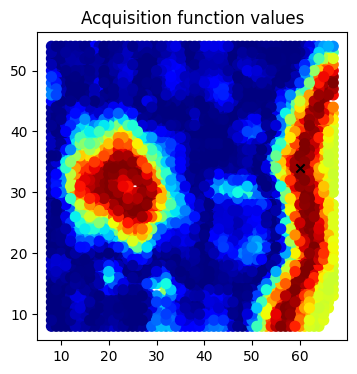

In [52]:
exploration_steps = 40  # 200 is about 7% of the points --> ~10-15 minute execution time! Note, 100 steps only takes ~3 min

xi = 0.01                # balances exploration and exploitation for EI

################################################################################
import time  # NEW LINE
time_all = []  # NEW LINE

AF_results = []
data_dim = X_train.shape[-1]
for e in range(exploration_steps):
    print("{}/{}".format(e+1, exploration_steps))
    start_time = time.time()  # NEW LINE
    training_iter = 20 if e < 100 else 40  # we do not want to "overfit" our model at the beginning

    # update GP posterior
    dklgp_new = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
    dklgp_new.fit(X_train, y_train, training_cycles=training_iter)

    # Compute the acquisition function
    best_f = torch.tensor(dklgp_new.predict(X_train)[0].max())
    obj = EI(dklgp_new, X_test, best_f, xi)

    # SAVE current acquisition function
    AF = save_result(indices_test, obj)
    AF_results.append(AF)

    obj = obj.T # transpose to n_samples x vector_size  for consistency

    # Scalarize the acquisition function
    obj = scalarize_acq(obj)

    # Select the next point to "measure"
    next_point_idx = obj.argmax()
    next_point = indices_test[next_point_idx]

    # Do "measurement"
    measured_point = y_test[:, next_point_idx]

    # Plot current result
    plot_result(indices_test, obj, e)

    # SAVE current MODEL WEIGHTS
    state_dict = dklgp_new.gp_model.state_dict()
    torch.save(state_dict, "Model_ActiveDKL {}.pt".format(e))

    # Append to the arrays of measured points
    X_train = np.append(X_train, X_test[next_point_idx][None], 0)
    X_test = np.delete(X_test, next_point_idx, 0)
    y_train = np.append(y_train, measured_point[:, None], 1)
    y_test = np.delete(y_test, next_point_idx, 1)
    indices_train = np.append(indices_train, next_point[None], 0)
    indices_test = np.delete(indices_test, next_point_idx, 0)
    time_all.append(time.time() - start_time)  # NEW LINE

Plot the visited points:

Overlay the explored point with a ground truth (again, we only will have a ground truth for *pre*-acquired data):

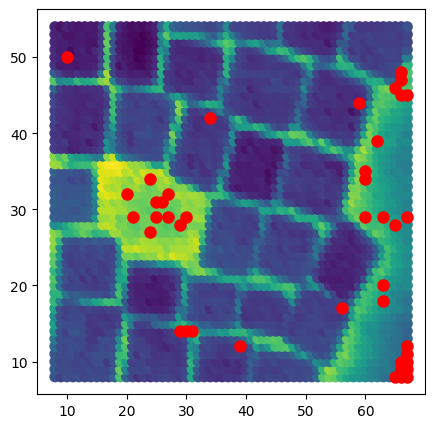

In [53]:
plt.figure(figsize=(5, 5))
plt.scatter(indices[:, 1], indices[:, 0], s=50, c=scalarize_acq(y.T))
plt.scatter(indices_train[:, 1], indices_train[:, 0], s=64, c='r')

Rather successful in finding intended behavior (defined by the "scalarize_acq" function)

* Zip all the weights, then download





In [54]:
# ## Do not do this as we will download a trained model later
# %%capture
# !zip -r /content/DKLweights_01.zip /content/DKL

* Save and, if interested, download results (model weights in DKLweights zip, and acquisition function in AF_results)

In [55]:
download = False

filename = "Acquisition_functions.npy"
np.save(filename, AF_results)

from google.colab import files
if download:
  files.download("DKLweights_01.zip")
  files.download(filename)

#### (Checkpoint) Load and reconstruct

In [56]:
%%capture

# Download the weights from a previously (actively) trained model
!wget https://www.dropbox.com/s/xl5745l7mp3ph3m/DKLweights_01.zip
!unzip "DKLweights_01.zip"
!rm DKLweights_01.zip

# Download the acquisition functions from a previously (actively) trained model
!wget https://www.dropbox.com/s/zc9ua64bi4348bw/ActiveDKL_FITOedge_10%.npy
AF_results = np.load("ActiveDKL_FITOedge_10%.npy", allow_pickle = True)

### AF movies

In [57]:
# Movies
def silence_imageio_warning(*args, **kwargs):
    pass
imageio.core.util._precision_warn = silence_imageio_warning

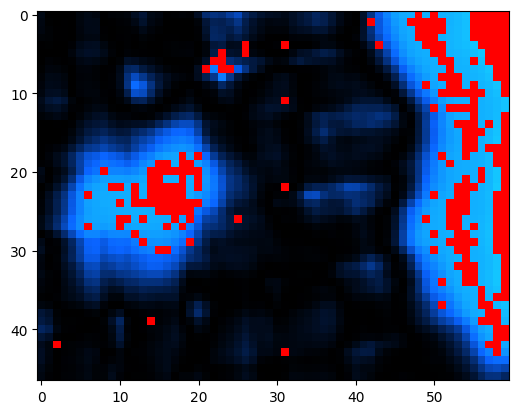

In [58]:
structural_img = np.copy(full_img)
AF_all, AF_all_color_combo, AF_combined = Make_AF_movies_preacquired(acquisition_functions = AF_results,
                                                                     RGB = Blue,
                                                                     brightness = 2,
                                                                     measured_points_in_AF = [1,0,0],
                                                                     measured_points_in_HAADF = [1,0,0])

plt.imshow(AF_all_color_combo[-1])

In [59]:
size_increase = 6

HAADF_mov = create_point_search_mov_preacquired(full_img, AF_combined, size = structural_img.shape, point_radius = 1, point_color = [1,0,0], offset = 0)
AF_resized = resize(AF_all_color_combo, HAADF_mov.shape)
Movie_combined = np.concatenate((AF_resized, HAADF_mov), axis = 2)

s1,s2,s3,s4 =  Movie_combined.shape
Movie_combined_upscaled = resize(Movie_combined, (s1,s2*size_increase,s3*size_increase,s4))

* View the A.F. at the last step:

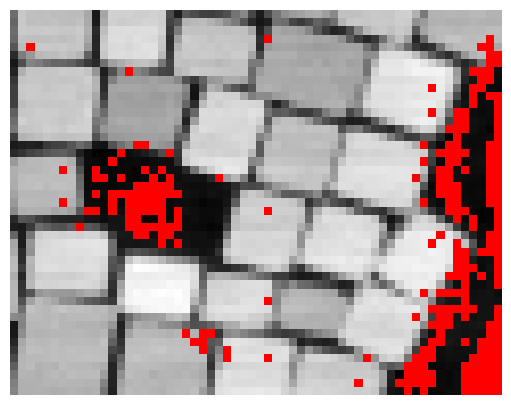

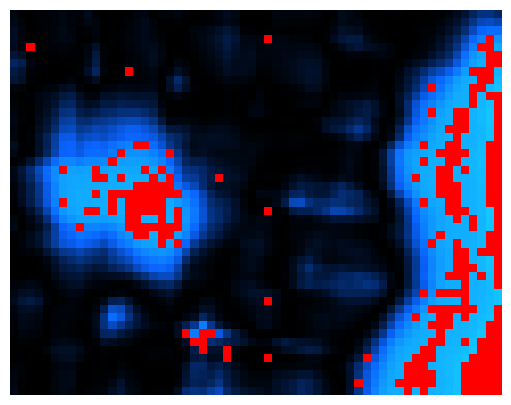

In [60]:
step = -1

plt.figure(figsize=(9,5))
ax=plt.gca()
plt.imshow(HAADF_mov[step], origin = 'lower')
ax.axis('off')

plt.figure(figsize=(9,5))
ax=plt.gca()
plt.imshow(AF_resized[step], origin = 'lower')
ax.axis('off');

* Or view the A.F. at only a few points visited:

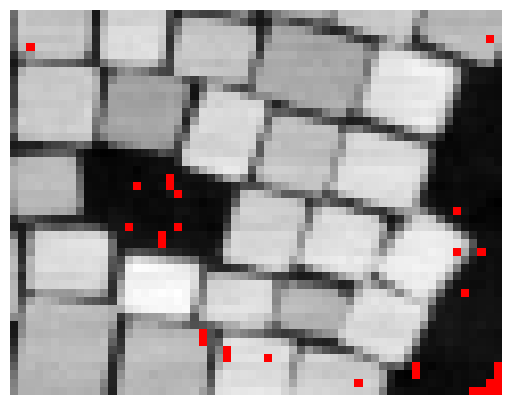

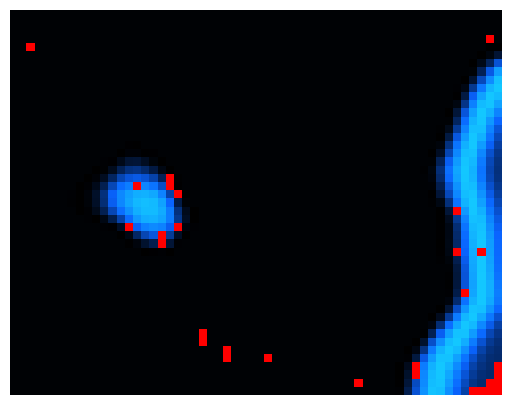

In [61]:
fraction = 0.01

step = int(fraction*X.shape[0])

plt.figure(figsize=(9,5))
ax=plt.gca()
plt.imshow(HAADF_mov[step], origin = 'lower')
ax.axis('off')

plt.figure(figsize=(9,5))
ax=plt.gca()
plt.imshow(AF_resized[step], origin = 'lower')
ax.axis('off');

* Create a movie

In [62]:
Mov_name = "AcquisitionFunction_mov1.mp4"

imageio.mimwrite(Mov_name, Movie_combined_upscaled, fps = 10)
Video(Mov_name, embed = True)

/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(


* Download if desired

In [63]:
download = False

from google.colab import files
if download:
  files.download(Mov_name)

### Reconstructions/Predictions

* Load and evaluate model performance at specific fractions of measured data points

In [64]:
cd '/content/DKL/content/DKL'

/content/DKL/content/DKL


In [65]:
weights_files = []
weights_files = sorted(glob.glob('*.pt'))
len(weights_files)

266

* Use model at this step.... (note, later cells use a function to accomplish the following two cells)

In [66]:
step = 10  # model step from which to load weights

#####################################
### do not change below parameters ###
#####################################

weights = weights_files[step]
device = 'cpu'            # constant
dtype = torch.float64     # constant

dklgp_trained =  aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_trained.compile_trainer(X, y) # extra step.

# Load trained weights
state_dict = torch.load(weights)
dklgp_trained.gp_model.load_state_dict(state_dict)

/usr/local/lib/python3.10/dist-packages/gpytorch/means/constant_mean.py:20: OldVersionWarning: You have loaded a GP model with a ConstantMean  from a previous version of GPyTorch. The mean module parameter `constant` has been renamed to `raw_constant`. Additionally, the shape of `raw_constant` is now *batch_shape, whereas the shape of `constant` was *batch_shape x 1. We have updated the name/shape of the parameter in your state dict, but we recommend that you re-save your model.
  warnings.warn(


<All keys matched successfully>

/usr/local/lib/python3.10/dist-packages/linear_operator/utils/sparse.py:51: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  if nonzero_indices.storage():


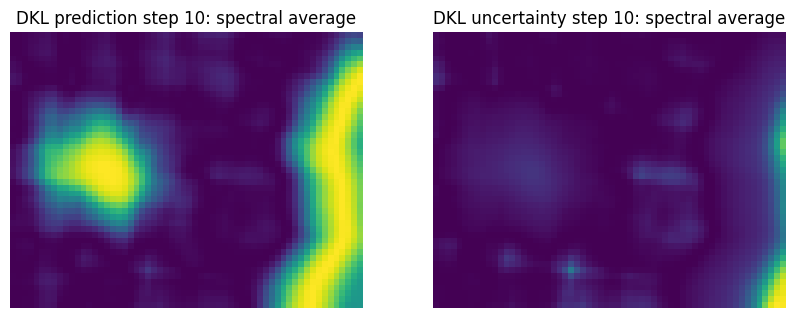

In [67]:
mean,var = dklgp_trained.predict(X, batch_size = len(X))

s1, s2 = structural_img.shape[0] - window_size+1, structural_img.shape[1] - window_size+1
s3 = y.shape[0]

dkl_prediction = np.full((s1*s2,s3), np.nan)
dkl_uncertainty = np.full((s1*s2,s3), np.nan)

for ii in range(indices[:,0].shape[0]):
  dkl_prediction[ii] = mean.T[ii, :]
  dkl_uncertainty[ii] = var.T[ii, :]

dkl_prediction = dkl_prediction.reshape((s1,s2,s3))
dkl_uncertainty = dkl_uncertainty.reshape((s1,s2,s3))

plt.figure(figsize=(10,5))
gs = gridspec.GridSpec(1,2)
ax1,ax2 = plt.subplot(gs[0]), plt.subplot(gs[1])

k1,k2 = 0, -1
ax1.imshow(np.mean(dkl_prediction[:,:,k1:k2],axis = 2), origin = 'lower')
ax2.imshow(np.mean(dkl_uncertainty[:,:,k1:k2], axis = 2), origin = 'lower')

ax1.set_title('DKL prediction step {}: spectral average'.format(step))
ax2.set_title('DKL uncertainty step {}: spectral average'.format(step))

ax1.axis('off'), ax2.axis('off');

#### 10%

/usr/local/lib/python3.10/dist-packages/gpytorch/means/constant_mean.py:20: OldVersionWarning: You have loaded a GP model with a ConstantMean  from a previous version of GPyTorch. The mean module parameter `constant` has been renamed to `raw_constant`. Additionally, the shape of `raw_constant` is now *batch_shape, whereas the shape of `constant` was *batch_shape x 1. We have updated the name/shape of the parameter in your state dict, but we recommend that you re-save your model.
  warnings.warn(


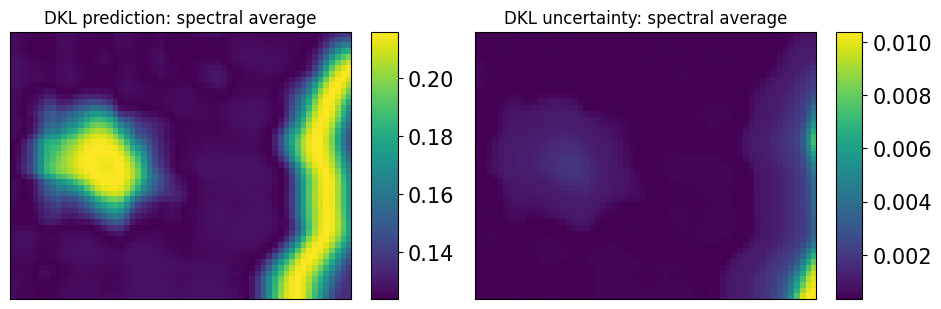

In [68]:
step = -1

k1,k2 = 0,-1  # average over full spectrum
pred10,unc10,mean10,var10 = plot_DKL_prediction_preacquired(weights_files,
                                                            step = step,
                                                            embed = 2,
                                                            precision = "double",
                                                            figsize = (11,4),
                                                            energy_range = [k1,k2],
                                                            colorscale = True)

#### 3%

/usr/local/lib/python3.10/dist-packages/gpytorch/means/constant_mean.py:20: OldVersionWarning: You have loaded a GP model with a ConstantMean  from a previous version of GPyTorch. The mean module parameter `constant` has been renamed to `raw_constant`. Additionally, the shape of `raw_constant` is now *batch_shape, whereas the shape of `constant` was *batch_shape x 1. We have updated the name/shape of the parameter in your state dict, but we recommend that you re-save your model.
  warnings.warn(


84

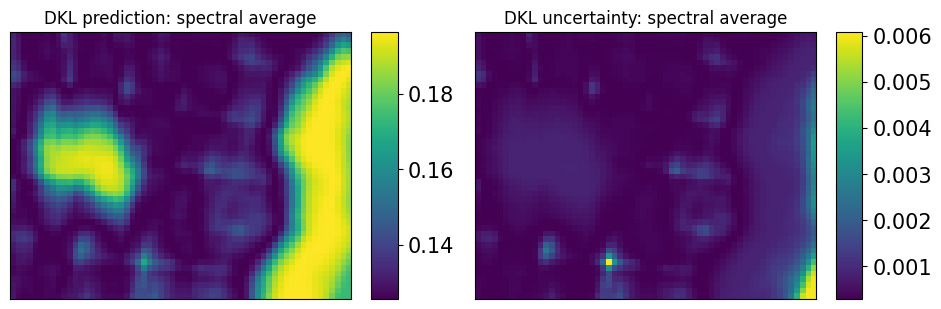

In [69]:
fraction = 0.03
k1,k2 = 0,-1  # average over full spectrum

step = int(fraction*X.shape[0])
pred03,unc03,mean03,var03 = plot_DKL_prediction_preacquired(weights_files,
                                           step = step,
                                           embed = 2,
                                           precision = "double",
                                           figsize = (11,4),
                                           energy_range = [k1,k2],
                                           colorscale = True)
step

#### 1%

/usr/local/lib/python3.10/dist-packages/gpytorch/means/constant_mean.py:20: OldVersionWarning: You have loaded a GP model with a ConstantMean  from a previous version of GPyTorch. The mean module parameter `constant` has been renamed to `raw_constant`. Additionally, the shape of `raw_constant` is now *batch_shape, whereas the shape of `constant` was *batch_shape x 1. We have updated the name/shape of the parameter in your state dict, but we recommend that you re-save your model.
  warnings.warn(


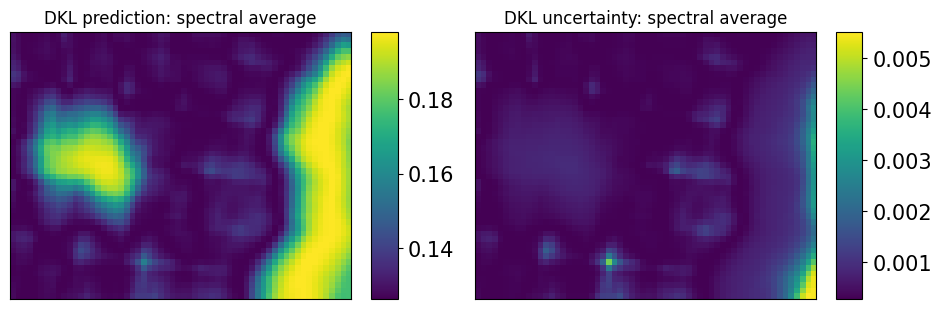

In [70]:
fraction = 0.01
k1,k2 = 0,-1  # average over full spectrum

step = int(fraction*X.shape[0])
pred01,unc01,mean01,var01 = plot_DKL_prediction_preacquired(weights_files,
                                           step = 27,
                                           embed = 2,
                                           precision = "double",
                                           figsize = (11,4),
                                           energy_range = [k1,k2],
                                           colorscale = True)

#### 0.1%
3 data points in total

/usr/local/lib/python3.10/dist-packages/gpytorch/means/constant_mean.py:20: OldVersionWarning: You have loaded a GP model with a ConstantMean  from a previous version of GPyTorch. The mean module parameter `constant` has been renamed to `raw_constant`. Additionally, the shape of `raw_constant` is now *batch_shape, whereas the shape of `constant` was *batch_shape x 1. We have updated the name/shape of the parameter in your state dict, but we recommend that you re-save your model.
  warnings.warn(


2

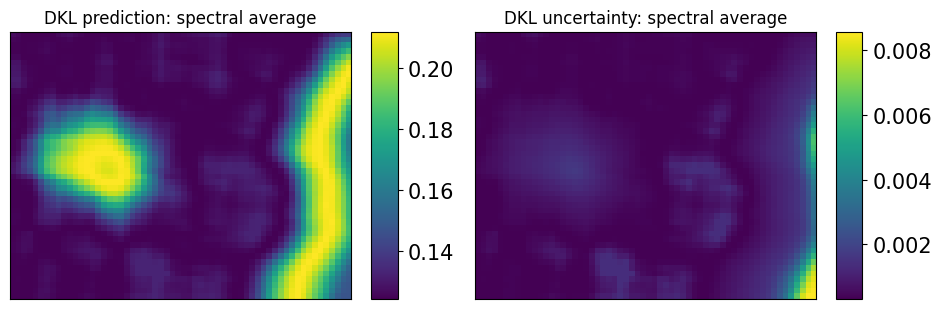

In [71]:
fraction = 0.001
k1,k2 = 0,-1  # average over full spectrum

step = int(fraction*X.shape[0])
pred001,unc001,mean001,var001 = plot_DKL_prediction_preacquired(weights_files,
                                           step = step,
                                           embed = 2,
                                           precision = "double",
                                           figsize = (11,4),
                                           energy_range = [k1,k2],
                                           colorscale = True)
step

### Collect results

* Predictions

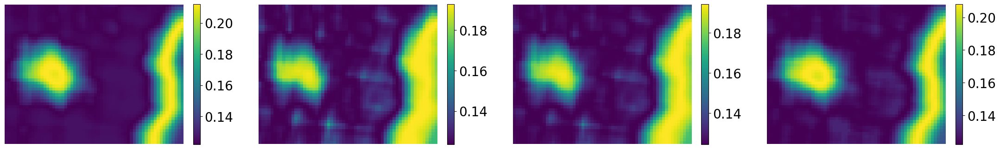

In [72]:
plt.figure(figsize=(26.67,7))
gs = gridspec.GridSpec(1,4, wspace = 0.3)
ax1,ax2,ax3,ax4 = plt.subplot(gs[0]), plt.subplot(gs[1]), plt.subplot(gs[2]), plt.subplot(gs[3])

im1 = ax1.imshow(np.mean(pred10, axis = 2), origin = 'lower')
im2 = ax2.imshow(np.mean(pred03, axis = 2), origin = 'lower')
im3 = ax3.imshow(np.mean(pred01, axis = 2), origin = 'lower')
im4 = ax4.imshow(np.mean(pred001, axis = 2), origin = 'lower')

cbar1 = plt.colorbar(im1, ax = ax1, fraction = 0.036)
cbar2 = plt.colorbar(im2, ax = ax2, fraction = 0.036)
cbar3 = plt.colorbar(im3, ax = ax3, fraction = 0.036)
cbar4 = plt.colorbar(im4, ax = ax4, fraction = 0.036)

cbar1.ax.tick_params(labelsize = 20)
cbar2.ax.tick_params(labelsize = 20)
cbar3.ax.tick_params(labelsize = 20)
cbar4.ax.tick_params(labelsize = 20)

ax1.axis('off'), ax2.axis('off'), ax3.axis('off'), ax4.axis('off');

* Uncertainties

In [73]:
cmax = np.asarray([np.mean(unc10, axis = 2), np.mean(unc03, axis = 2), np.mean(unc01, axis = 2), np.mean(unc001, axis = 2)]).max()
cmin = np.asarray([np.mean(unc10, axis = 2), np.mean(unc03, axis = 2), np.mean(unc01, axis = 2), np.mean(unc001, axis = 2)]).min()

unc_all = np.asarray([np.mean(unc10, axis = 2), np.mean(unc03, axis = 2), np.mean(unc01, axis = 2), np.mean(unc001, axis = 2)])

print("Average mean across all space: ", np.mean(unc_all[0]))
print("Average mean across all space: ", np.mean(unc_all[1]))
print("Average mean across all space: ", np.mean(unc_all[2]))
print("Average mean across all space: ", np.mean(unc_all[3]))

Average mean across all space:  0.0008213656781257378
Average mean across all space:  0.0006413816097016561
Average mean across all space:  0.0006128304185703413
Average mean across all space:  0.0007780386146719949


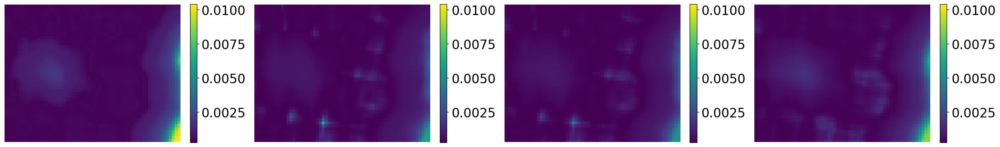

In [74]:
plt.figure(figsize=(26.67,7))
gs = gridspec.GridSpec(1,4, wspace = 0.3)
ax1,ax2,ax3,ax4 = plt.subplot(gs[0]), plt.subplot(gs[1]), plt.subplot(gs[2]), plt.subplot(gs[3])

im1 = ax1.imshow(np.mean(unc10, axis = 2),  origin = 'lower', vmin = cmin, vmax = cmax)
im2 = ax2.imshow(np.mean(unc03, axis = 2),  origin = 'lower', vmin = cmin, vmax = cmax)
im3 = ax3.imshow(np.mean(unc01, axis = 2),  origin = 'lower', vmin = cmin, vmax = cmax)
im4 = ax4.imshow(np.mean(unc001, axis = 2), origin = 'lower', vmin = cmin, vmax = cmax)

cbar1 = plt.colorbar(im1, ax = ax1, fraction = 0.036)
cbar2 = plt.colorbar(im2, ax = ax2, fraction = 0.036)
cbar3 = plt.colorbar(im3, ax = ax3, fraction = 0.036)
cbar4 = plt.colorbar(im4, ax = ax4, fraction = 0.036)

cbar1.ax.tick_params(labelsize = 20)
cbar2.ax.tick_params(labelsize = 20)
cbar3.ax.tick_params(labelsize = 20)
cbar4.ax.tick_params(labelsize = 20)

ax1.axis('off'), ax2.axis('off'), ax3.axis('off'), ax4.axis('off');

* Big fig

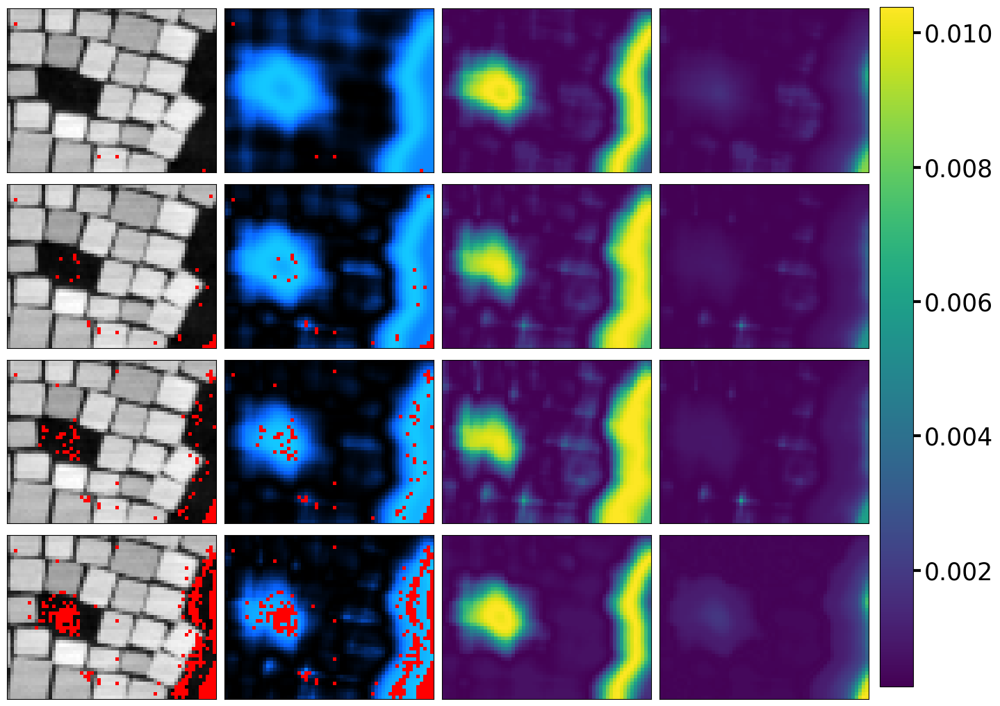

In [75]:
step1, step2, step3, step4 = 2, 27, 84, -1

Predictions = [pred001.mean(2), pred01.mean(2), pred03.mean(2), pred10.mean(2)]
Uncertainties = [unc001.mean(2), unc01.mean(2), unc03.mean(2), unc10.mean(2)]
ADFs = [HAADF_mov[step1], HAADF_mov[step2], HAADF_mov[step3], HAADF_mov[step4]]
AFs = [AF_resized[step1], AF_resized[step2], AF_resized[step3], AF_resized[step4]]
All_imgs = [ADFs, AFs, Predictions,Uncertainties]
###############################################################
fig = plt.figure(figsize=(16,13))
gs = gridspec.GridSpec(4,4, wspace = 0.04, hspace = 0.04)

for ii in range(4):
    ax = fig.add_subplot(gs[ii,0])
    ax.imshow(All_imgs[0][ii], origin = 'lower')
    plt.setp(ax, xticks=[], yticks=[])
for ii in range(4):
    ax = fig.add_subplot(gs[ii,1])
    ax.imshow(All_imgs[1][ii], origin = 'lower')
    plt.setp(ax, xticks=[], yticks=[])
for ii in range(4):
    ax = fig.add_subplot(gs[ii,2])
    ax.imshow(All_imgs[2][ii], origin = 'lower')
    plt.setp(ax, xticks=[], yticks=[])
for ii in range(4):
    ax = fig.add_subplot(gs[ii,3])
    im = ax.imshow(All_imgs[3][ii], origin = 'lower', vmin = cmin, vmax = cmax)
    plt.setp(ax, xticks=[], yticks=[])
    # cbar = plt.colorbar(im, ax=ax, fraction = 0.2, aspect = 5)
    # cbar.ax.tick_params(labelsize = 15)



cbar_ax = fig.add_axes([0.91, 0.127, 0.03, 0.752])
fig.colorbar(im, cax=cbar_ax)
cbar_ax.tick_params(labelsize = 25, width = 3, length = 8)

* Average Spectra combined

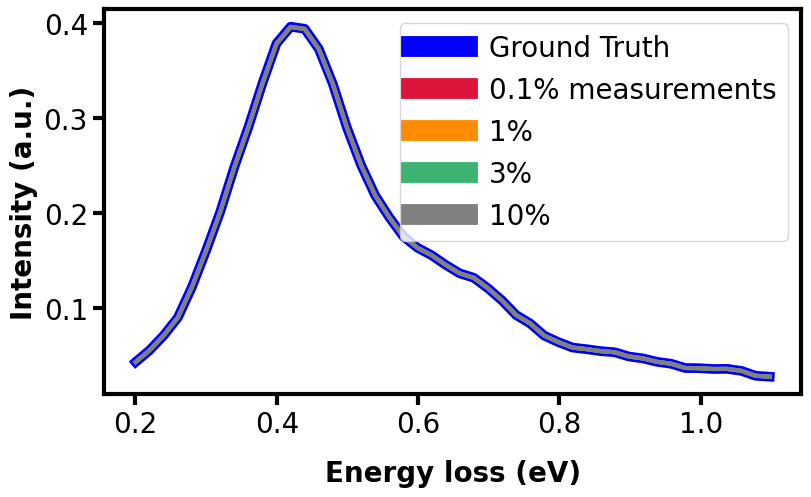

In [76]:
plt.figure(figsize=(9,5))
ax = plt.gca()

ax.plot(e_reduced, y.T.mean(0), c='blue', lw = 7, label = 'Ground Truth')
ax.plot(e_reduced, pred001.mean((0,1)), c='crimson', lw = 2, label = '0.1% measurements')
ax.plot(e_reduced, pred01.mean((0,1)), c='darkorange', lw = 3, label = '1%')
ax.plot(e_reduced, pred03.mean((0,1)), c='mediumseagreen', lw = 3, label = '3%')
ax.plot(e_reduced, pred10.mean((0,1)), c='gray', lw = 3, label = '10%')

leg=ax.legend(fontsize = 20)
for line in leg.get_lines():
  line.set_linewidth(15)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)


for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)

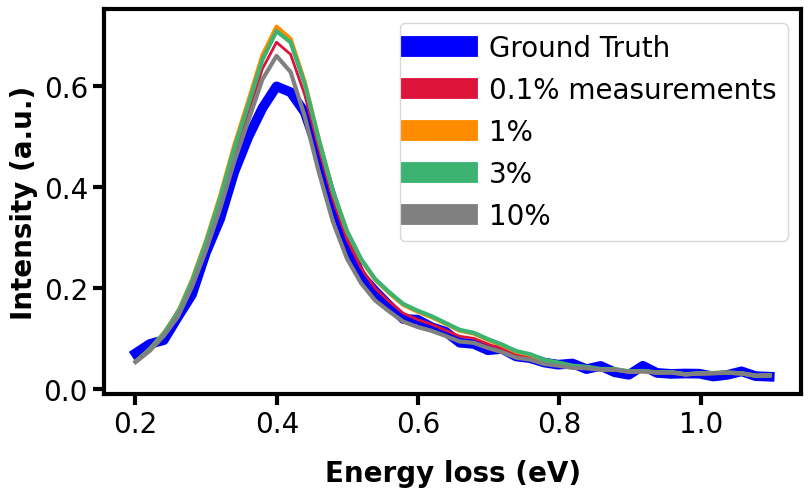

In [77]:
plt.figure(figsize=(9,5))
ax = plt.gca()
i1,j1 = 30, 58    # one where low uncertainty exists,
# i1,j1 = 30, 24    # one where high uncertainty exists
ax.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], c='blue', lw = 7, label = 'Ground Truth')
ax.plot(e_reduced, pred001[i1,j1], c='crimson', lw = 2, label = '0.1% measurements')
ax.plot(e_reduced, pred01[i1,j1], c='darkorange', lw = 3, label = '1%')
ax.plot(e_reduced, pred03[i1,j1], c='mediumseagreen', lw = 3, label = '3%')
ax.plot(e_reduced, pred10[i1,j1], c='gray', lw = 3, label = '10%')

leg=ax.legend(fontsize = 20)
for line in leg.get_lines():
  line.set_linewidth(15)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)


for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)

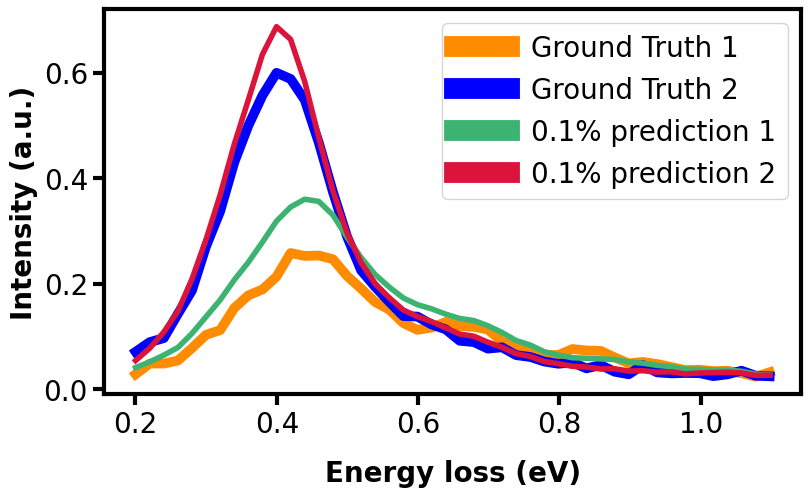

In [78]:
plt.figure(figsize=(9,5))
ax = plt.gca()

i1,j1 = 30, 24    # one where high uncertainty exists
i2,j2 = 30, 58    # one where low uncertainty exists,

ax.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], c='darkorange', lw = 7, label = 'Ground Truth 1')
ax.plot(e_reduced, y.T.reshape(pred10.shape)[i2,j2], c='blue', lw = 7, label = 'Ground Truth 2')
ax.plot(e_reduced, pred001[i1,j1], c='mediumseagreen', lw = 4, label = '0.1% prediction 1')
ax.plot(e_reduced, pred001[i2,j2], c='crimson', lw = 4, label = '0.1% prediction 2')

leg=ax.legend(fontsize = 20)
for line in leg.get_lines():
  line.set_linewidth(15)

ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
ax.tick_params(labelsize = 20, length = 8, width = 3)


for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(3)

# Additional Predictions

* 0.1%

Text(0.5, 1.0, '0.1% Predictions')

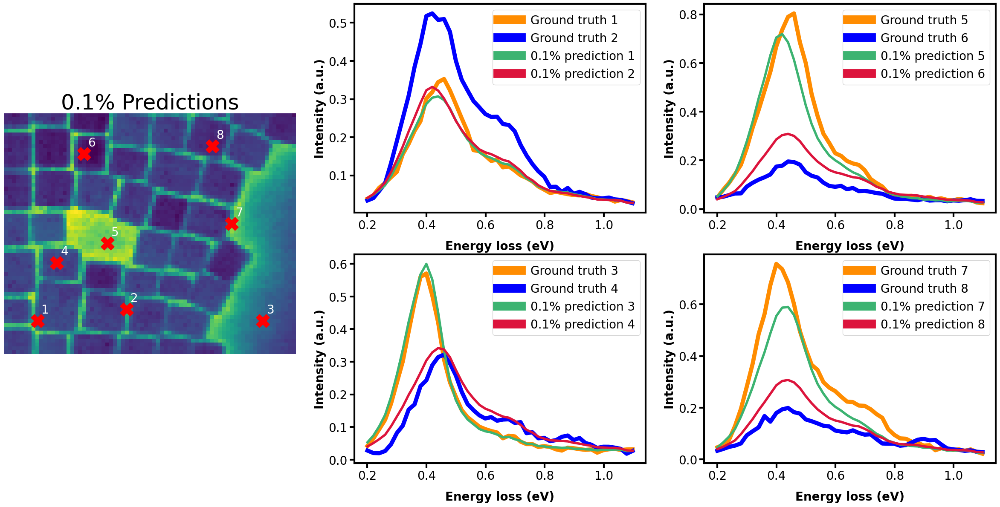

In [79]:
i1,j1 = 0, 0
i2,j2 = 3, 23
i3,j3 = 0, 58
i4,j4 = 15, 5
i5,j5 = 20, 18
i6,j6 = 43, 12
i7,j7 = 25, 50
i8,j8 = 45, 45

plt.figure(figsize=(30,14))
gs=gridspec.GridSpec(2,3)
aximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])
# ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred10.shape)

halfwin = int(window_size/2)

aximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
aximg.scatter(j1+halfwin,i1+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j2+halfwin,i2+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j3+halfwin,i3+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j4+halfwin,i4+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j5+halfwin,i5+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j6+halfwin,i6+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j7+halfwin,i7+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j8+halfwin,i8+halfwin, c='r', s=500, marker = 'X')


aximg.axis('off')
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax00.plot(e_reduced, pred001[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="0.1% prediction 1", zorder=1)
ax00.plot(e_reduced, pred001[i2,j2], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 2", zorder=2)

ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i3,j3], linewidth=7, c='darkorange', label="Ground truth 3", zorder=0)
ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i4,j4], linewidth=7, c='blue', label="Ground truth 4", zorder=0)
ax01.plot(e_reduced, pred001[i3,j3], linewidth=4, c='mediumseagreen', alpha=1, label="0.1% prediction 3", zorder=1)
ax01.plot(e_reduced, pred001[i4,j4], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 4", zorder=2)

ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i5,j5], linewidth=7, c='darkorange', label="Ground truth 5", zorder=0)
ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i6,j6], linewidth=7, c='blue', label="Ground truth 6", zorder=0)
ax10.plot(e_reduced, pred001[i5,j5], linewidth=4, c='mediumseagreen', alpha=1, label="0.1% prediction 5", zorder=1)
ax10.plot(e_reduced, pred001[i6,j6], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 6", zorder=2)

ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i7,j7], linewidth=7, c='darkorange', label="Ground truth 7", zorder=0)
ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i8,j8], linewidth=7, c='blue', label="Ground truth 8", zorder=0)
ax11.plot(e_reduced, pred001[i7,j7], linewidth=4, c='mediumseagreen', alpha=1, label="0.1% prediction 7", zorder=1)
ax11.plot(e_reduced, pred001[i8,j8], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 8", zorder=2)

for ax in [ax00,ax01,ax10,ax11]:
    leg=ax.legend(fontsize = 20)
    for line in leg.get_lines():
        line.set_linewidth(15)

    ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
    ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
    ax.tick_params(labelsize = 20, length = 8, width = 3)

    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(3)

offsetx, offsety = 1, 2
aximg.annotate("1", (j1+halfwin+offsetx,i1+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("2", (j2+halfwin+offsetx,i2+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("3", (j3+halfwin+offsetx,i3+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("4", (j4+halfwin+offsetx,i4+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("5", (j5+halfwin+offsetx,i5+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("6", (j6+halfwin+offsetx,i6+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("7", (j7+halfwin+offsetx,i7+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("8", (j8+halfwin+offsetx,i8+halfwin+offsety), fontsize = 20, color = 'white')

aximg.set_title("0.1% Predictions", fontsize = 36)

* 1%

Text(0.5, 1.0, '1% Predictions')

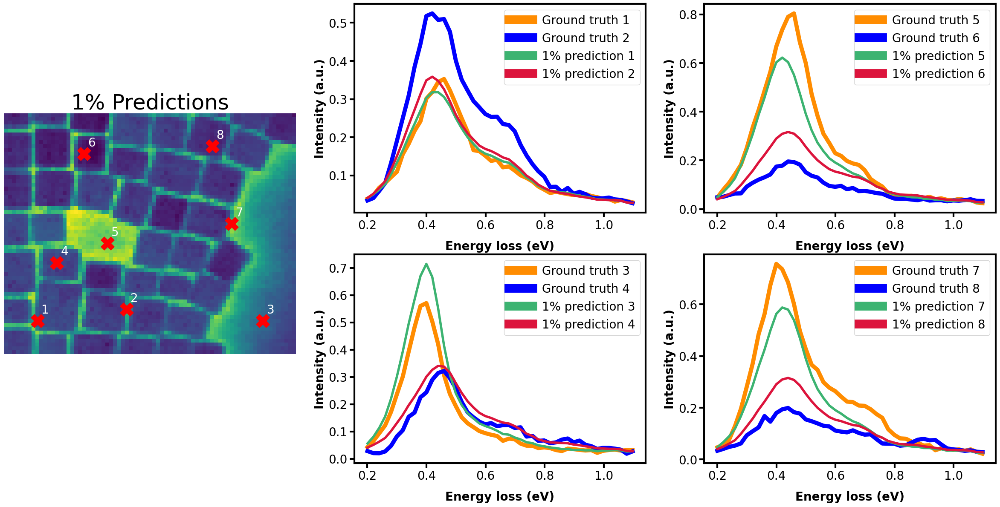

In [80]:
i1,j1 = 0, 0
i2,j2 = 3, 23
i3,j3 = 0, 58
i4,j4 = 15, 5
i5,j5 = 20, 18
i6,j6 = 43, 12
i7,j7 = 25, 50
i8,j8 = 45, 45

plt.figure(figsize=(30,14))
gs=gridspec.GridSpec(2,3)
aximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])
# ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred10.shape)

halfwin = int(window_size/2)

aximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
aximg.scatter(j1+halfwin,i1+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j2+halfwin,i2+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j3+halfwin,i3+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j4+halfwin,i4+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j5+halfwin,i5+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j6+halfwin,i6+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j7+halfwin,i7+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j8+halfwin,i8+halfwin, c='r', s=500, marker = 'X')


aximg.axis('off')
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax00.plot(e_reduced, pred01[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 1", zorder=1)
ax00.plot(e_reduced, pred01[i2,j2], linewidth=4, c='crimson', alpha=1, label="1% prediction 2", zorder=2)

ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i3,j3], linewidth=7, c='darkorange', label="Ground truth 3", zorder=0)
ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i4,j4], linewidth=7, c='blue', label="Ground truth 4", zorder=0)
ax01.plot(e_reduced, pred01[i3,j3], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 3", zorder=1)
ax01.plot(e_reduced, pred01[i4,j4], linewidth=4, c='crimson', alpha=1, label="1% prediction 4", zorder=2)

ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i5,j5], linewidth=7, c='darkorange', label="Ground truth 5", zorder=0)
ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i6,j6], linewidth=7, c='blue', label="Ground truth 6", zorder=0)
ax10.plot(e_reduced, pred01[i5,j5], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 5", zorder=1)
ax10.plot(e_reduced, pred01[i6,j6], linewidth=4, c='crimson', alpha=1, label="1% prediction 6", zorder=2)

ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i7,j7], linewidth=7, c='darkorange', label="Ground truth 7", zorder=0)
ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i8,j8], linewidth=7, c='blue', label="Ground truth 8", zorder=0)
ax11.plot(e_reduced, pred01[i7,j7], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 7", zorder=1)
ax11.plot(e_reduced, pred01[i8,j8], linewidth=4, c='crimson', alpha=1, label="1% prediction 8", zorder=2)

for ax in [ax00,ax01,ax10,ax11]:
    leg=ax.legend(fontsize = 20)
    for line in leg.get_lines():
        line.set_linewidth(15)

    ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
    ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
    ax.tick_params(labelsize = 20, length = 8, width = 3)

    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(3)

offsetx, offsety = 1, 2
aximg.annotate("1", (j1+halfwin+offsetx,i1+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("2", (j2+halfwin+offsetx,i2+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("3", (j3+halfwin+offsetx,i3+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("4", (j4+halfwin+offsetx,i4+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("5", (j5+halfwin+offsetx,i5+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("6", (j6+halfwin+offsetx,i6+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("7", (j7+halfwin+offsetx,i7+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("8", (j8+halfwin+offsetx,i8+halfwin+offsety), fontsize = 20, color = 'white')

aximg.set_title("1% Predictions", fontsize = 36)

* 3%

Text(0.5, 1.0, '3% Predictions')

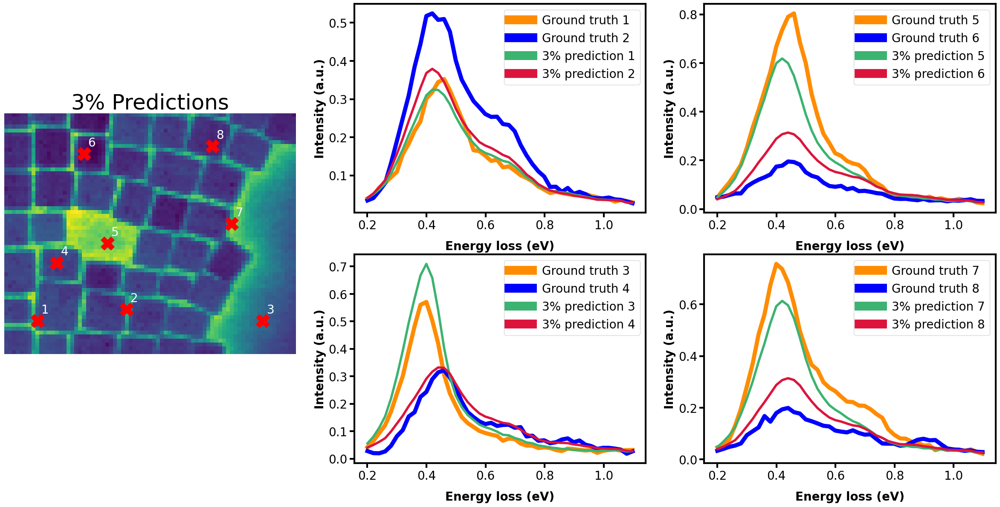

In [81]:
i1,j1 = 0, 0
i2,j2 = 3, 23
i3,j3 = 0, 58
i4,j4 = 15, 5
i5,j5 = 20, 18
i6,j6 = 43, 12
i7,j7 = 25, 50
i8,j8 = 45, 45

plt.figure(figsize=(30,14))
gs=gridspec.GridSpec(2,3)
aximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])
# ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred10.shape)

halfwin = int(window_size/2)

aximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
aximg.scatter(j1+halfwin,i1+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j2+halfwin,i2+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j3+halfwin,i3+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j4+halfwin,i4+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j5+halfwin,i5+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j6+halfwin,i6+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j7+halfwin,i7+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j8+halfwin,i8+halfwin, c='r', s=500, marker = 'X')


aximg.axis('off')
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax00.plot(e_reduced, pred03[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="3% prediction 1", zorder=1)
ax00.plot(e_reduced, pred03[i2,j2], linewidth=4, c='crimson', alpha=1, label="3% prediction 2", zorder=2)

ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i3,j3], linewidth=7, c='darkorange', label="Ground truth 3", zorder=0)
ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i4,j4], linewidth=7, c='blue', label="Ground truth 4", zorder=0)
ax01.plot(e_reduced, pred03[i3,j3], linewidth=4, c='mediumseagreen', alpha=1, label="3% prediction 3", zorder=1)
ax01.plot(e_reduced, pred03[i4,j4], linewidth=4, c='crimson', alpha=1, label="3% prediction 4", zorder=2)

ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i5,j5], linewidth=7, c='darkorange', label="Ground truth 5", zorder=0)
ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i6,j6], linewidth=7, c='blue', label="Ground truth 6", zorder=0)
ax10.plot(e_reduced, pred03[i5,j5], linewidth=4, c='mediumseagreen', alpha=1, label="3% prediction 5", zorder=1)
ax10.plot(e_reduced, pred03[i6,j6], linewidth=4, c='crimson', alpha=1, label="3% prediction 6", zorder=2)

ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i7,j7], linewidth=7, c='darkorange', label="Ground truth 7", zorder=0)
ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i8,j8], linewidth=7, c='blue', label="Ground truth 8", zorder=0)
ax11.plot(e_reduced, pred03[i7,j7], linewidth=4, c='mediumseagreen', alpha=1, label="3% prediction 7", zorder=1)
ax11.plot(e_reduced, pred03[i8,j8], linewidth=4, c='crimson', alpha=1, label="3% prediction 8", zorder=2)

for ax in [ax00,ax01,ax10,ax11]:
    leg=ax.legend(fontsize = 20)
    for line in leg.get_lines():
        line.set_linewidth(15)

    ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
    ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
    ax.tick_params(labelsize = 20, length = 8, width = 3)

    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(3)

offsetx, offsety = 1, 2
aximg.annotate("1", (j1+halfwin+offsetx,i1+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("2", (j2+halfwin+offsetx,i2+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("3", (j3+halfwin+offsetx,i3+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("4", (j4+halfwin+offsetx,i4+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("5", (j5+halfwin+offsetx,i5+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("6", (j6+halfwin+offsetx,i6+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("7", (j7+halfwin+offsetx,i7+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("8", (j8+halfwin+offsetx,i8+halfwin+offsety), fontsize = 20, color = 'white')

aximg.set_title("3% Predictions", fontsize = 36)

* 10%

Text(0.5, 1.0, '10% Predictions')

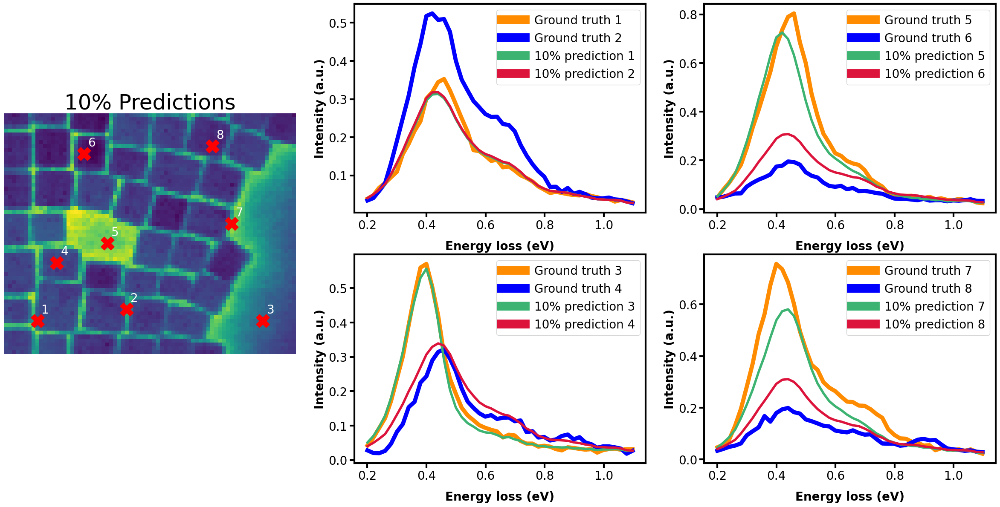

In [82]:
i1,j1 = 0, 0
i2,j2 = 3, 23
i3,j3 = 0, 58
i4,j4 = 15, 5
i5,j5 = 20, 18
i6,j6 = 43, 12
i7,j7 = 25, 50
i8,j8 = 45, 45

plt.figure(figsize=(30,14))
gs=gridspec.GridSpec(2,3)
aximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])
# ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred10.shape)

halfwin = int(window_size/2)

aximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
aximg.scatter(j1+halfwin,i1+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j2+halfwin,i2+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j3+halfwin,i3+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j4+halfwin,i4+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j5+halfwin,i5+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j6+halfwin,i6+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j7+halfwin,i7+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j8+halfwin,i8+halfwin, c='r', s=500, marker = 'X')


aximg.axis('off')
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], linewidth=7, c='darkorange', label="Ground truth 1", zorder=0)
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i2,j2], linewidth=7, c='blue', label="Ground truth 2", zorder=0)
ax00.plot(e_reduced, pred10[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="10% prediction 1", zorder=1)
ax00.plot(e_reduced, pred10[i2,j2], linewidth=4, c='crimson', alpha=1, label="10% prediction 2", zorder=2)

ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i3,j3], linewidth=7, c='darkorange', label="Ground truth 3", zorder=0)
ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i4,j4], linewidth=7, c='blue', label="Ground truth 4", zorder=0)
ax01.plot(e_reduced, pred10[i3,j3], linewidth=4, c='mediumseagreen', alpha=1, label="10% prediction 3", zorder=1)
ax01.plot(e_reduced, pred10[i4,j4], linewidth=4, c='crimson', alpha=1, label="10% prediction 4", zorder=2)

ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i5,j5], linewidth=7, c='darkorange', label="Ground truth 5", zorder=0)
ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i6,j6], linewidth=7, c='blue', label="Ground truth 6", zorder=0)
ax10.plot(e_reduced, pred10[i5,j5], linewidth=4, c='mediumseagreen', alpha=1, label="10% prediction 5", zorder=1)
ax10.plot(e_reduced, pred10[i6,j6], linewidth=4, c='crimson', alpha=1, label="10% prediction 6", zorder=2)

ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i7,j7], linewidth=7, c='darkorange', label="Ground truth 7", zorder=0)
ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i8,j8], linewidth=7, c='blue', label="Ground truth 8", zorder=0)
ax11.plot(e_reduced, pred10[i7,j7], linewidth=4, c='mediumseagreen', alpha=1, label="10% prediction 7", zorder=1)
ax11.plot(e_reduced, pred10[i8,j8], linewidth=4, c='crimson', alpha=1, label="10% prediction 8", zorder=2)

for ax in [ax00,ax01,ax10,ax11]:
    leg=ax.legend(fontsize = 20)
    for line in leg.get_lines():
        line.set_linewidth(15)

    ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
    ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
    ax.tick_params(labelsize = 20, length = 8, width = 3)

    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(3)

offsetx, offsety = 1, 2
aximg.annotate("1", (j1+halfwin+offsetx,i1+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("2", (j2+halfwin+offsetx,i2+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("3", (j3+halfwin+offsetx,i3+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("4", (j4+halfwin+offsetx,i4+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("5", (j5+halfwin+offsetx,i5+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("6", (j6+halfwin+offsetx,i6+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("7", (j7+halfwin+offsetx,i7+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("8", (j8+halfwin+offsetx,i8+halfwin+offsety), fontsize = 20, color = 'white')

aximg.set_title("10% Predictions", fontsize = 36)

* 10% vs 3% vs 1% vs 0.1%

# Percentage comparisons

Text(0.5, 1.0, 'Data percentage comparison')

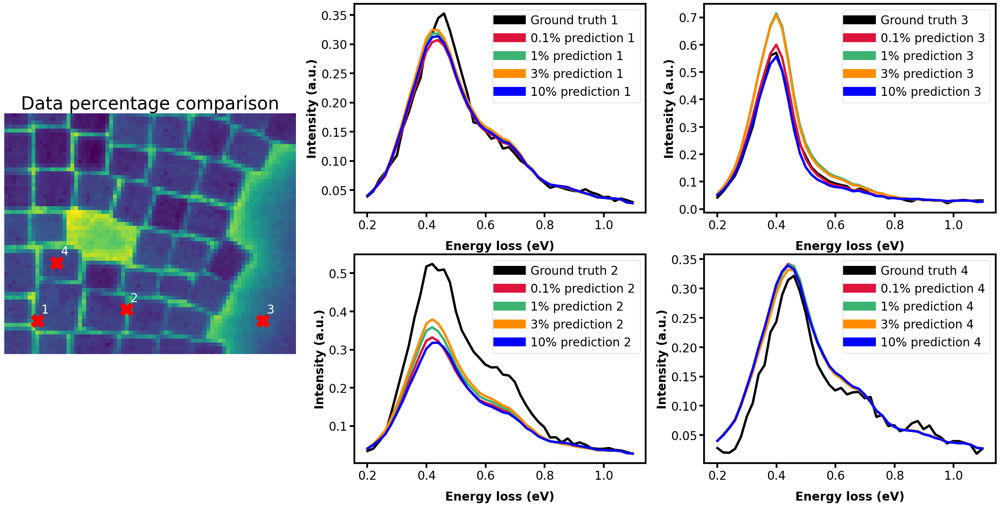

In [83]:
i1,j1 = 0, 0
i2,j2 = 3, 23
i3,j3 = 0, 58
i4,j4 = 15, 5
i5,j5 = 20, 18
i6,j6 = 43, 12
i7,j7 = 25, 50
i8,j8 = 45, 45

plt.figure(figsize=(30,14))
gs=gridspec.GridSpec(2,3)
aximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])
# ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred10.shape)

halfwin = int(window_size/2)

aximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
aximg.scatter(j1+halfwin,i1+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j2+halfwin,i2+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j3+halfwin,i3+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j4+halfwin,i4+halfwin, c='r', s=500, marker = 'X')
# aximg.scatter(j5+halfwin,i5+halfwin, c='r', s=500, marker = 'X')
# aximg.scatter(j6+halfwin,i6+halfwin, c='r', s=500, marker = 'X')
# aximg.scatter(j7+halfwin,i7+halfwin, c='r', s=500, marker = 'X')
# aximg.scatter(j8+halfwin,i8+halfwin, c='r', s=500, marker = 'X')


aximg.axis('off')
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], linewidth=4, c='k', label="Ground truth 1", zorder=0)
ax00.plot(e_reduced, pred001[i1,j1], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 1", zorder=1)
ax00.plot(e_reduced, pred01[i1,j1], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 1", zorder=1)
ax00.plot(e_reduced, pred03[i1,j1], linewidth=4, c='darkorange', alpha=1, label="3% prediction 1", zorder=1)
ax00.plot(e_reduced, pred10[i1,j1], linewidth=4, c='blue', alpha=1, label="10% prediction 1", zorder=1)

ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i2,j2], linewidth=4, c='k', label="Ground truth 2", zorder=0)
ax01.plot(e_reduced, pred001[i2,j2], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 2", zorder=1)
ax01.plot(e_reduced, pred01[i2,j2], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 2", zorder=1)
ax01.plot(e_reduced, pred03[i2,j2], linewidth=4, c='darkorange', alpha=1, label="3% prediction 2", zorder=1)
ax01.plot(e_reduced, pred10[i2,j2], linewidth=4, c='blue', alpha=1, label="10% prediction 2", zorder=1)

ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i3,j3], linewidth=4, c='k', label="Ground truth 3", zorder=0)
ax10.plot(e_reduced, pred001[i3,j3], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 3", zorder=1)
ax10.plot(e_reduced, pred01[i3,j3], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 3", zorder=1)
ax10.plot(e_reduced, pred03[i3,j3], linewidth=4, c='darkorange', alpha=1, label="3% prediction 3", zorder=1)
ax10.plot(e_reduced, pred10[i3,j3], linewidth=4, c='blue', alpha=1, label="10% prediction 3", zorder=1)

ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i4,j4], linewidth=4, c='k', label="Ground truth 4", zorder=0)
ax11.plot(e_reduced, pred001[i4,j4], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 4", zorder=1)
ax11.plot(e_reduced, pred01[i4,j4], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 4", zorder=1)
ax11.plot(e_reduced, pred03[i4,j4], linewidth=4, c='darkorange', alpha=1, label="3% prediction 4", zorder=1)
ax11.plot(e_reduced, pred10[i4,j4], linewidth=4, c='blue', alpha=1, label="10% prediction 4", zorder=1)

for ax in [ax00,ax01,ax10,ax11]:
    leg=ax.legend(fontsize = 20)
    for line in leg.get_lines():
        line.set_linewidth(15)

    ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
    ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
    ax.tick_params(labelsize = 20, length = 8, width = 3)

    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(3)

offsetx, offsety = 1, 2
aximg.annotate("1", (j1+halfwin+offsetx,i1+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("2", (j2+halfwin+offsetx,i2+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("3", (j3+halfwin+offsetx,i3+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("4", (j4+halfwin+offsetx,i4+halfwin+offsety), fontsize = 20, color = 'white')
# aximg.annotate("5", (j5+halfwin+offsetx,i5+halfwin+offsety), fontsize = 20, color = 'white')
# aximg.annotate("6", (j6+halfwin+offsetx,i6+halfwin+offsety), fontsize = 20, color = 'white')
# aximg.annotate("7", (j7+halfwin+offsetx,i7+halfwin+offsety), fontsize = 20, color = 'white')
# aximg.annotate("8", (j8+halfwin+offsetx,i8+halfwin+offsety), fontsize = 20, color = 'white')


aximg.set_title("Data percentage comparison", fontsize = 30)

Text(0.5, 1.0, 'Data percentage comparison')

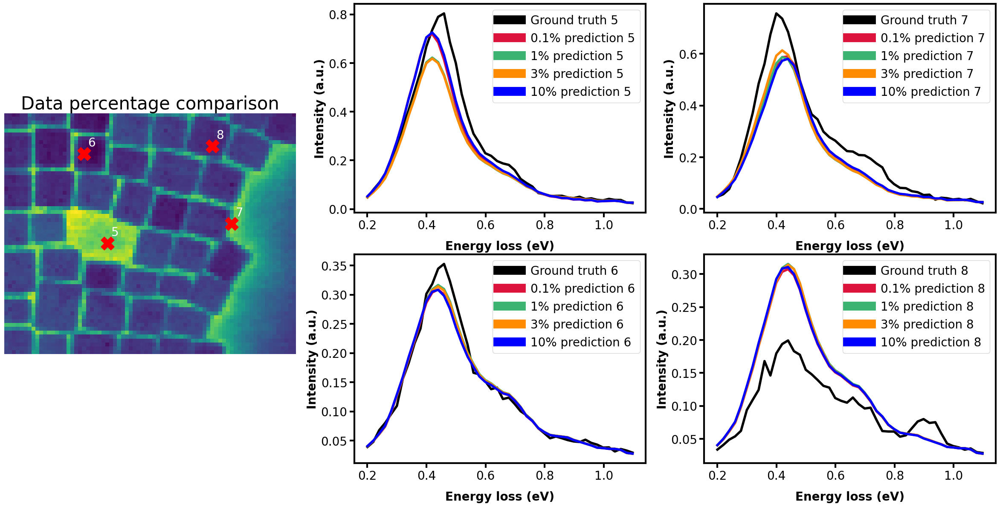

In [84]:
i1,j1 = 0, 0
i2,j2 = 3, 23
i3,j3 = 0, 58
i4,j4 = 15, 5
i5,j5 = 20, 18
i6,j6 = 43, 12
i7,j7 = 25, 50
i8,j8 = 45, 45

plt.figure(figsize=(30,14))
gs=gridspec.GridSpec(2,3)
aximg, ax00,ax01,ax10,ax11 = plt.subplot(gs[0:2,0]), plt.subplot(gs[0,1]), plt.subplot(gs[1,1]), plt.subplot(gs[0,2]), plt.subplot(gs[1,2])
# ax=plt.gca()

dkl_meas_full = y.T.reshape(dkl_pred10.shape)

halfwin = int(window_size/2)

aximg.imshow(np.mean(specim[:,:,k1:k2], axis = 2), origin = 'lower')
# aximg.scatter(j1+halfwin,i1+halfwin, c='r', s=500, marker = 'X')
# aximg.scatter(j2+halfwin,i2+halfwin, c='r', s=500, marker = 'X')
# aximg.scatter(j3+halfwin,i3+halfwin, c='r', s=500, marker = 'X')
# aximg.scatter(j4+halfwin,i4+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j5+halfwin,i5+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j6+halfwin,i6+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j7+halfwin,i7+halfwin, c='r', s=500, marker = 'X')
aximg.scatter(j8+halfwin,i8+halfwin, c='r', s=500, marker = 'X')


aximg.axis('off')
ax00.plot(e_reduced, y.T.reshape(pred10.shape)[i5,j5], linewidth=4, c='k', label="Ground truth 5", zorder=0)
ax00.plot(e_reduced, pred001[i5,j5], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 5", zorder=1)
ax00.plot(e_reduced, pred01[i5,j5], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 5", zorder=1)
ax00.plot(e_reduced, pred03[i5,j5], linewidth=4, c='darkorange', alpha=1, label="3% prediction 5", zorder=1)
ax00.plot(e_reduced, pred10[i5,j5], linewidth=4, c='blue', alpha=1, label="10% prediction 5", zorder=1)

ax01.plot(e_reduced, y.T.reshape(pred10.shape)[i1,j1], linewidth=4, c='k', label="Ground truth 6", zorder=0)
ax01.plot(e_reduced, pred001[i6,j6], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 6", zorder=1)
ax01.plot(e_reduced, pred01[i6,j6], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 6", zorder=1)
ax01.plot(e_reduced, pred03[i6,j6], linewidth=4, c='darkorange', alpha=1, label="3% prediction 6", zorder=1)
ax01.plot(e_reduced, pred10[i6,j6], linewidth=4, c='blue', alpha=1, label="10% prediction 6", zorder=1)

ax10.plot(e_reduced, y.T.reshape(pred10.shape)[i7,j7], linewidth=4, c='k', label="Ground truth 7", zorder=0)
ax10.plot(e_reduced, pred001[i7,j7], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 7", zorder=1)
ax10.plot(e_reduced, pred01[i7,j7], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 7", zorder=1)
ax10.plot(e_reduced, pred03[i7,j7], linewidth=4, c='darkorange', alpha=1, label="3% prediction 7", zorder=1)
ax10.plot(e_reduced, pred10[i7,j7], linewidth=4, c='blue', alpha=1, label="10% prediction 7", zorder=1)

ax11.plot(e_reduced, y.T.reshape(pred10.shape)[i8,j8], linewidth=4, c='k', label="Ground truth 8", zorder=0)
ax11.plot(e_reduced, pred001[i8,j8], linewidth=4, c='crimson', alpha=1, label="0.1% prediction 8", zorder=1)
ax11.plot(e_reduced, pred01[i8,j8], linewidth=4, c='mediumseagreen', alpha=1, label="1% prediction 8", zorder=1)
ax11.plot(e_reduced, pred03[i8,j8], linewidth=4, c='darkorange', alpha=1, label="3% prediction 8", zorder=1)
ax11.plot(e_reduced, pred10[i8,j8], linewidth=4, c='blue', alpha=1, label="10% prediction 8", zorder=1)

for ax in [ax00,ax01,ax10,ax11]:
    leg=ax.legend(fontsize = 20)
    for line in leg.get_lines():
        line.set_linewidth(15)

    ax.set_xlabel('Energy loss (eV)', fontsize = 20, labelpad = 15, weight = 'bold')
    ax.set_ylabel('Intensity (a.u.)', fontsize = 20, weight = 'bold')
    ax.tick_params(labelsize = 20, length = 8, width = 3)

    for axis in ['top','bottom','left','right']:
        ax.spines[axis].set_linewidth(3)

offsetx, offsety = 1, 2
# aximg.annotate("1", (j1+halfwin+offsetx,i1+halfwin+offsety), fontsize = 20, color = 'white')
# aximg.annotate("2", (j2+halfwin+offsetx,i2+halfwin+offsety), fontsize = 20, color = 'white')
# aximg.annotate("3", (j3+halfwin+offsetx,i3+halfwin+offsety), fontsize = 20, color = 'white')
# aximg.annotate("4", (j4+halfwin+offsetx,i4+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("5", (j5+halfwin+offsetx,i5+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("6", (j6+halfwin+offsetx,i6+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("7", (j7+halfwin+offsetx,i7+halfwin+offsety), fontsize = 20, color = 'white')
aximg.annotate("8", (j8+halfwin+offsetx,i8+halfwin+offsety), fontsize = 20, color = 'white')

aximg.set_title("Data percentage comparison", fontsize = 30)

We can also try reconstructing the entire FOV based on the visited points:

In [85]:
dklgp_1 = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
dklgp_1.fit(X_train, y_train, training_cycles=50)

samples = dklgp_1.sample_from_posterior(X, num_samples=1000)
mean = samples.mean(0).T
var = samples.var(0).T

Epoch 1/50 ... Training loss: 37.2762
Epoch 10/50 ... Training loss: 35.6774
Epoch 20/50 ... Training loss: 33.6572
Epoch 30/50 ... Training loss: 31.7803
Epoch 40/50 ... Training loss: 29.8729
Epoch 50/50 ... Training loss: 27.9264


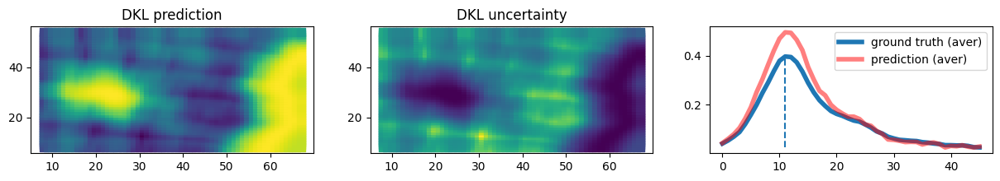

In [86]:
k = 11  # slide across the "energy" axis
_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 2))
ax1.scatter(indices[:, 1], indices[:, 0], s=50, marker='s', c=mean[:, k])
ax1.set_title("DKL prediction")
ax2.scatter(indices[:, 1], indices[:, 0], s=50, marker='s', c=var[:, k])
ax2.set_title("DKL uncertainty")
ax3.plot(y.T.mean(0), linewidth=4, label="ground truth (aver)", zorder=0)
ax3.plot(mean.mean(0), linewidth=4, c='red', alpha=0.5, label="prediction (aver)", zorder=1)
ax3.vlines(k, y.T.mean(0).min(), y.T.mean(0).max(), linestyle="--")
ax3.legend()

Note that the average predicted spectra is characeterized by a higher value of plasmonic peak(s). This is not surprising since we were mostly focused on discovering the regions with high plasmonic response.

Now let's combine exploitation with pure exploration. Specifically, after 60 steps we are going to switch from the expected improvement (of the desired functionality) acquisition function to a pure uncertainty-based exploration.

In [87]:
(X_train, X_test, y_train, y_test,
 indices_train, indices_test) = train_test_split(
     X, y.T, indices, test_size=0.999, shuffle=True, random_state=42)

y_train = y_train.T
y_test = y_test.T

print(X_train.shape) # n_samples x n_features
print(y_train.shape) # vector_size x n_samples

(2, 256)
(46, 2)


1/80
Epoch 1/20 ... Training loss: 44.4031
Epoch 10/20 ... Training loss: 42.4171
Epoch 20/20 ... Training loss: 39.7916


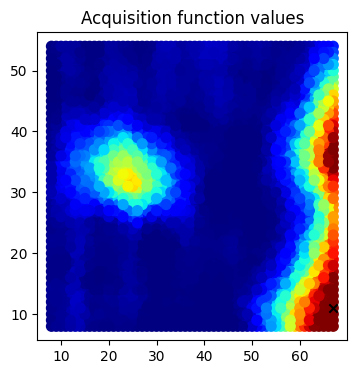

2/80
Epoch 1/20 ... Training loss: 44.8289
Epoch 10/20 ... Training loss: 43.0766
Epoch 20/20 ... Training loss: 40.3551


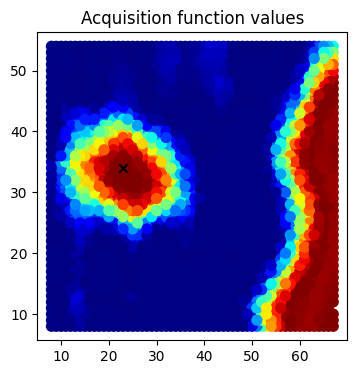

3/80
Epoch 1/20 ... Training loss: 44.2575
Epoch 10/20 ... Training loss: 42.8759
Epoch 20/20 ... Training loss: 40.4231


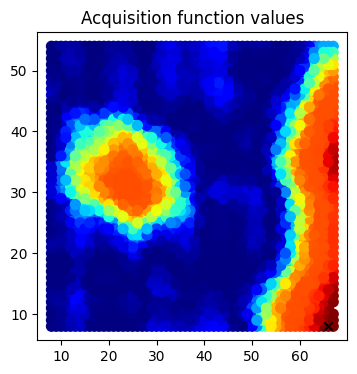

4/80
Epoch 1/20 ... Training loss: 43.4686
Epoch 10/20 ... Training loss: 42.1148
Epoch 20/20 ... Training loss: 39.6317


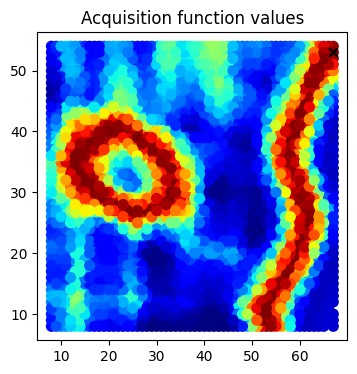

5/80
Epoch 1/20 ... Training loss: 42.7082
Epoch 10/20 ... Training loss: 40.9134
Epoch 20/20 ... Training loss: 39.0055


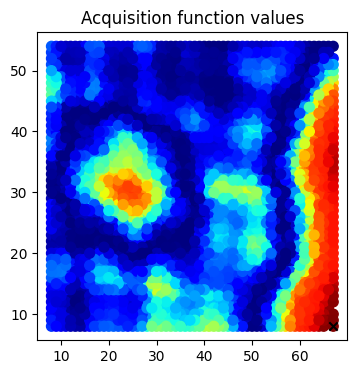

6/80
Epoch 1/20 ... Training loss: 42.0992
Epoch 10/20 ... Training loss: 41.077
Epoch 20/20 ... Training loss: 38.3882


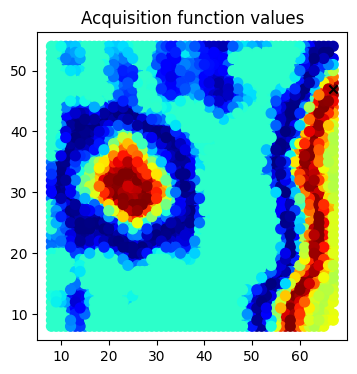

7/80
Epoch 1/20 ... Training loss: 41.7264
Epoch 10/20 ... Training loss: 40.5524
Epoch 20/20 ... Training loss: 38.0906


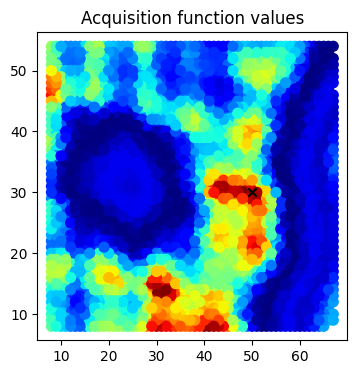

8/80
Epoch 1/20 ... Training loss: 41.4208
Epoch 10/20 ... Training loss: 40.0543
Epoch 20/20 ... Training loss: 37.9969


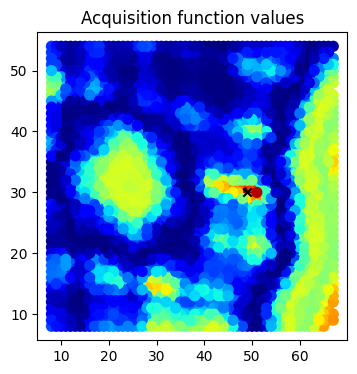

9/80
Epoch 1/20 ... Training loss: 41.1475
Epoch 10/20 ... Training loss: 39.7958
Epoch 20/20 ... Training loss: 37.6424


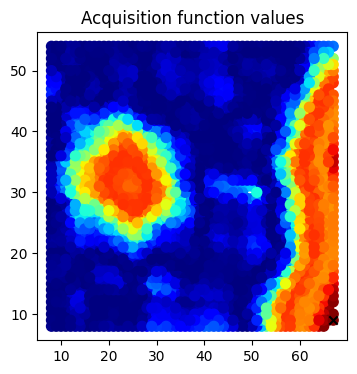

10/80
Epoch 1/20 ... Training loss: 40.7993
Epoch 10/20 ... Training loss: 39.6384
Epoch 20/20 ... Training loss: 37.422


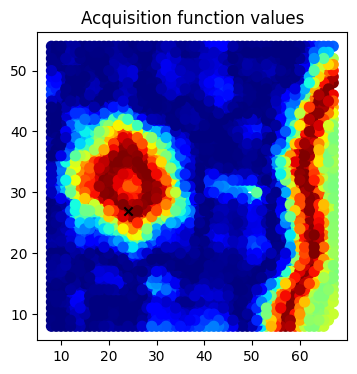

11/80
Epoch 1/20 ... Training loss: 40.5298
Epoch 10/20 ... Training loss: 39.166
Epoch 20/20 ... Training loss: 37.1332


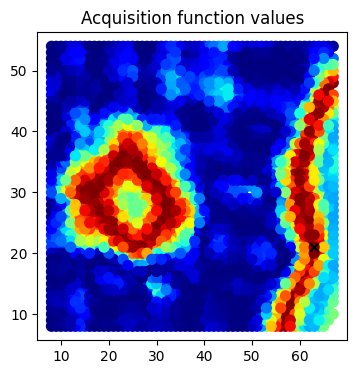

12/80
Epoch 1/20 ... Training loss: 40.3916
Epoch 10/20 ... Training loss: 39.1225
Epoch 20/20 ... Training loss: 36.7852


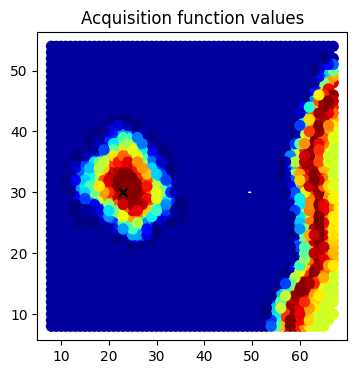

13/80
Epoch 1/20 ... Training loss: 40.1325
Epoch 10/20 ... Training loss: 38.8828
Epoch 20/20 ... Training loss: 36.6692


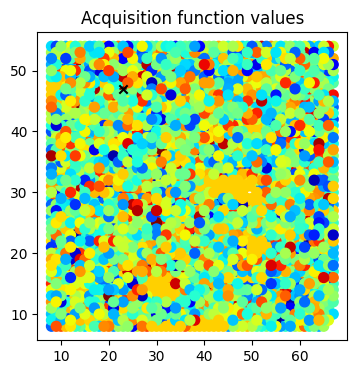

14/80
Epoch 1/20 ... Training loss: 39.8984
Epoch 10/20 ... Training loss: 38.633
Epoch 20/20 ... Training loss: 36.547


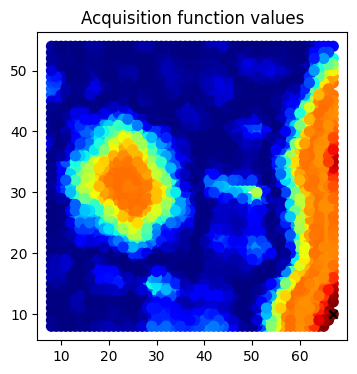

15/80
Epoch 1/20 ... Training loss: 39.7035
Epoch 10/20 ... Training loss: 38.5565
Epoch 20/20 ... Training loss: 36.3793


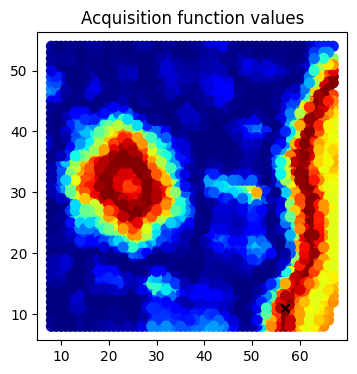

16/80
Epoch 1/20 ... Training loss: 39.6232
Epoch 10/20 ... Training loss: 38.2439
Epoch 20/20 ... Training loss: 36.2248


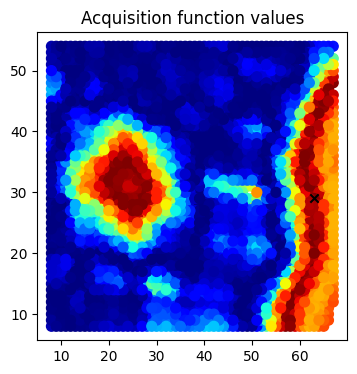

17/80
Epoch 1/20 ... Training loss: 39.4402
Epoch 10/20 ... Training loss: 37.8839
Epoch 20/20 ... Training loss: 35.9119


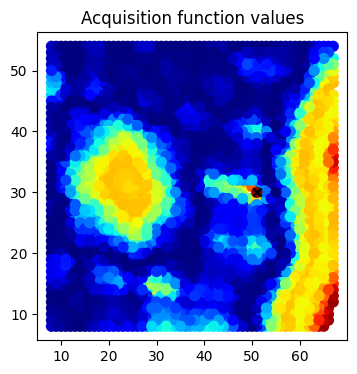

18/80
Epoch 1/20 ... Training loss: 39.2817
Epoch 10/20 ... Training loss: 37.9559
Epoch 20/20 ... Training loss: 35.6092


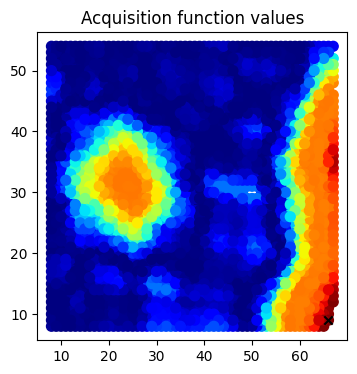

19/80
Epoch 1/20 ... Training loss: 39.1334
Epoch 10/20 ... Training loss: 37.5749
Epoch 20/20 ... Training loss: 35.543


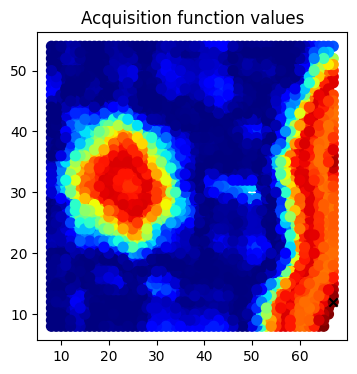

20/80
Epoch 1/20 ... Training loss: 38.9867
Epoch 10/20 ... Training loss: 37.7238
Epoch 20/20 ... Training loss: 35.6235


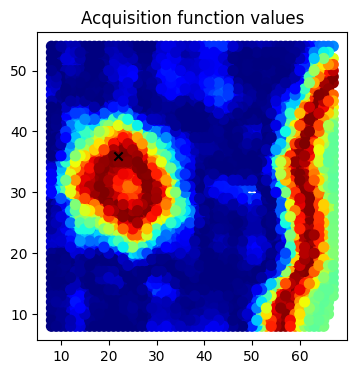

21/80
Epoch 1/20 ... Training loss: 38.8561
Epoch 10/20 ... Training loss: 37.5432
Epoch 20/20 ... Training loss: 35.4959


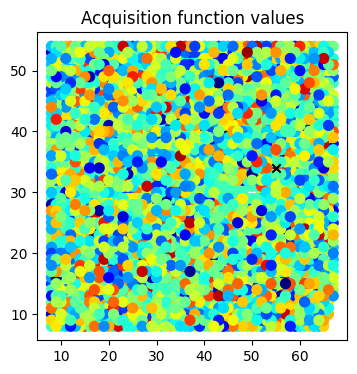

22/80
Epoch 1/20 ... Training loss: 38.732
Epoch 10/20 ... Training loss: 37.2781
Epoch 20/20 ... Training loss: 35.132


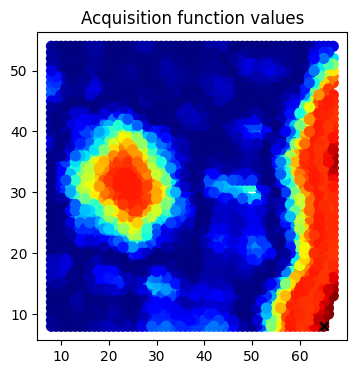

23/80
Epoch 1/20 ... Training loss: 38.6101
Epoch 10/20 ... Training loss: 37.3743
Epoch 20/20 ... Training loss: 35.3122


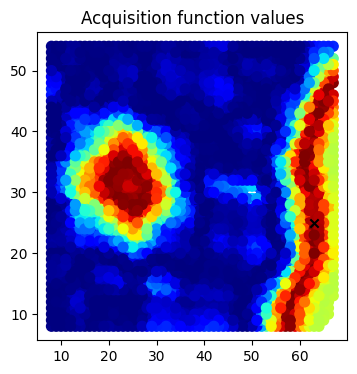

24/80
Epoch 1/20 ... Training loss: 38.5363
Epoch 10/20 ... Training loss: 36.7971
Epoch 20/20 ... Training loss: 34.8401


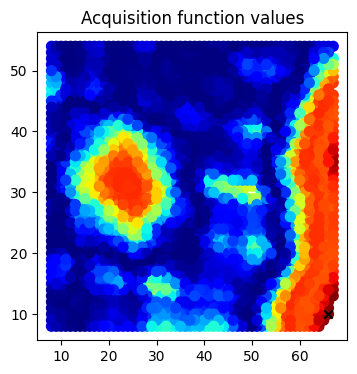

25/80
Epoch 1/20 ... Training loss: 38.428
Epoch 10/20 ... Training loss: 36.9164
Epoch 20/20 ... Training loss: 35.0846


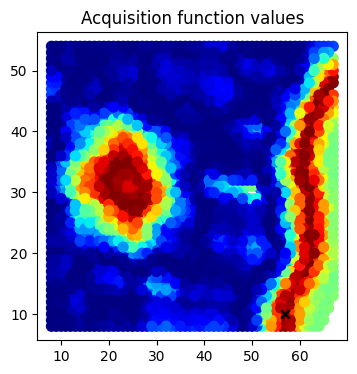

26/80
Epoch 1/20 ... Training loss: 38.3476
Epoch 10/20 ... Training loss: 36.9694
Epoch 20/20 ... Training loss: 34.8832


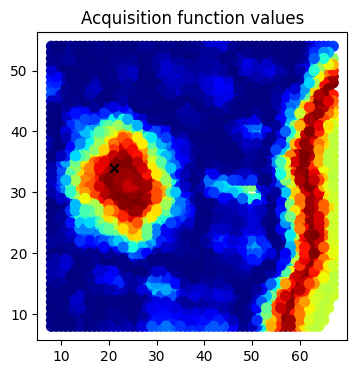

27/80
Epoch 1/20 ... Training loss: 38.267
Epoch 10/20 ... Training loss: 36.6573
Epoch 20/20 ... Training loss: 34.8737


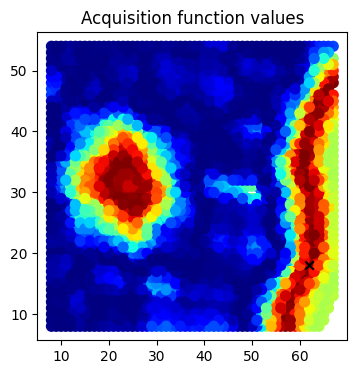

28/80
Epoch 1/20 ... Training loss: 38.174
Epoch 10/20 ... Training loss: 36.7644
Epoch 20/20 ... Training loss: 34.7701


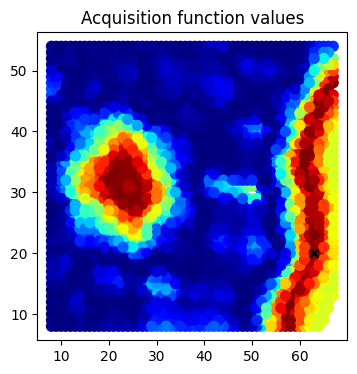

29/80
Epoch 1/20 ... Training loss: 38.1206
Epoch 10/20 ... Training loss: 36.7124
Epoch 20/20 ... Training loss: 34.7054


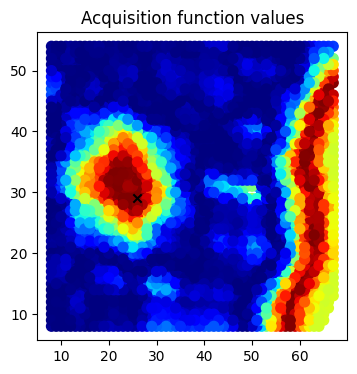

30/80
Epoch 1/20 ... Training loss: 38.0564
Epoch 10/20 ... Training loss: 36.5529
Epoch 20/20 ... Training loss: 34.4397


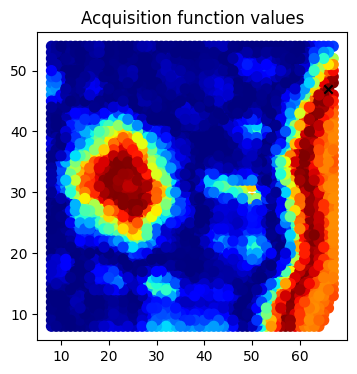

31/80
Epoch 1/20 ... Training loss: 37.9989
Epoch 10/20 ... Training loss: 36.4818
Epoch 20/20 ... Training loss: 34.5412


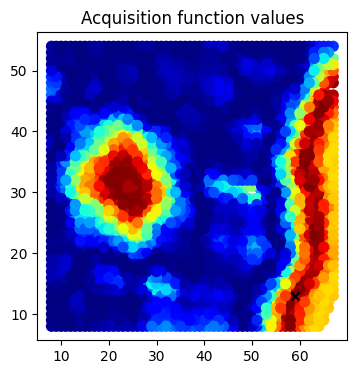

32/80
Epoch 1/20 ... Training loss: 37.9361
Epoch 10/20 ... Training loss: 36.4289
Epoch 20/20 ... Training loss: 34.2294


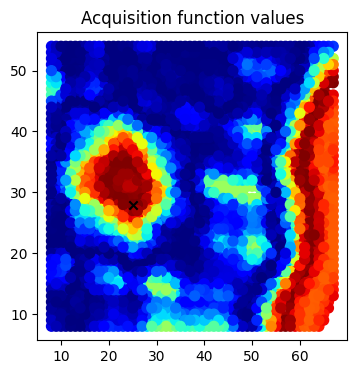

33/80
Epoch 1/20 ... Training loss: 37.892
Epoch 10/20 ... Training loss: 36.3002
Epoch 20/20 ... Training loss: 34.3043


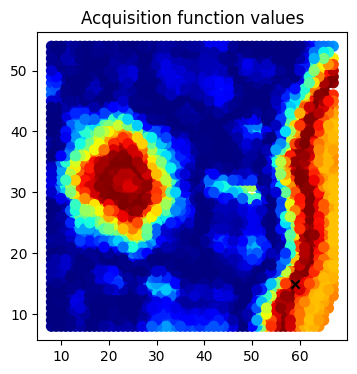

34/80
Epoch 1/20 ... Training loss: 37.8366
Epoch 10/20 ... Training loss: 36.2198
Epoch 20/20 ... Training loss: 34.066


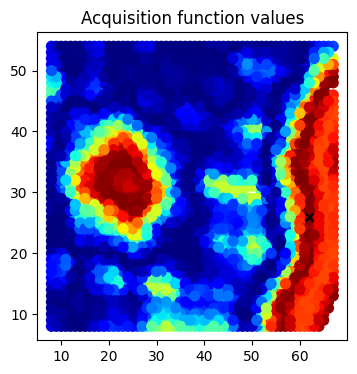

35/80
Epoch 1/20 ... Training loss: 37.7596
Epoch 10/20 ... Training loss: 36.1346
Epoch 20/20 ... Training loss: 34.2484


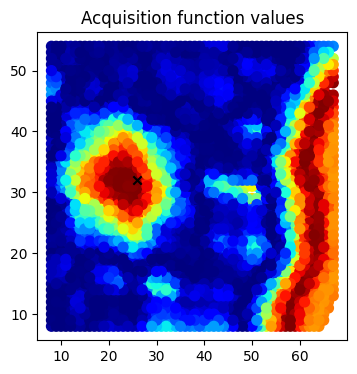

36/80
Epoch 1/20 ... Training loss: 37.6894
Epoch 10/20 ... Training loss: 36.1077
Epoch 20/20 ... Training loss: 34.0632


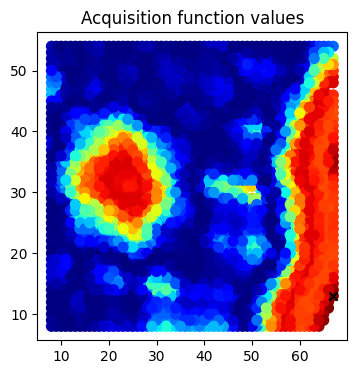

37/80
Epoch 1/20 ... Training loss: 37.6247
Epoch 10/20 ... Training loss: 35.9905
Epoch 20/20 ... Training loss: 34.0495


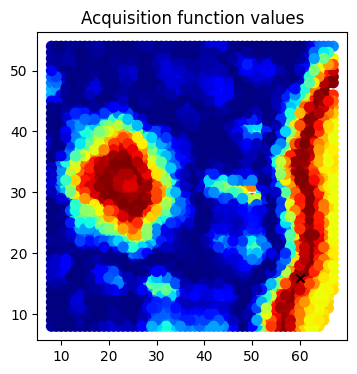

38/80
Epoch 1/20 ... Training loss: 37.563
Epoch 10/20 ... Training loss: 35.8634
Epoch 20/20 ... Training loss: 33.8996


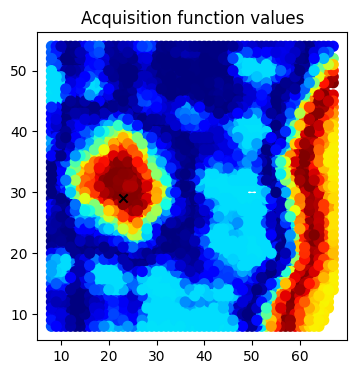

39/80
Epoch 1/20 ... Training loss: 37.5421
Epoch 10/20 ... Training loss: 35.8884
Epoch 20/20 ... Training loss: 33.8886


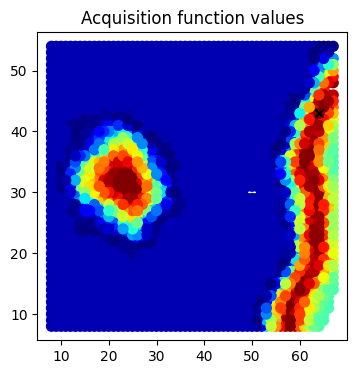

40/80
Epoch 1/20 ... Training loss: 37.482
Epoch 10/20 ... Training loss: 35.8963
Epoch 20/20 ... Training loss: 33.7259


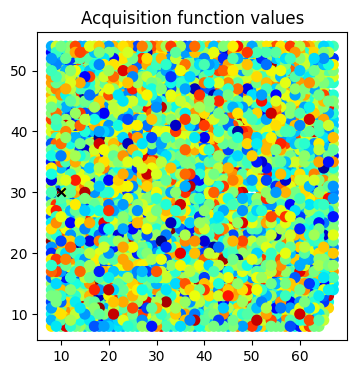

41/80
Epoch 1/20 ... Training loss: 37.4375
Epoch 10/20 ... Training loss: 35.7744
Epoch 20/20 ... Training loss: 33.8638


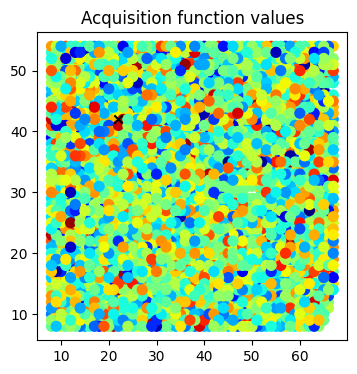

42/80
Epoch 1/20 ... Training loss: 37.4046
Epoch 10/20 ... Training loss: 35.7738
Epoch 20/20 ... Training loss: 33.7505


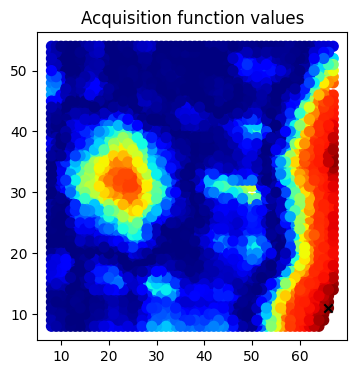

43/80
Epoch 1/20 ... Training loss: 37.3545
Epoch 10/20 ... Training loss: 35.7717
Epoch 20/20 ... Training loss: 33.7909


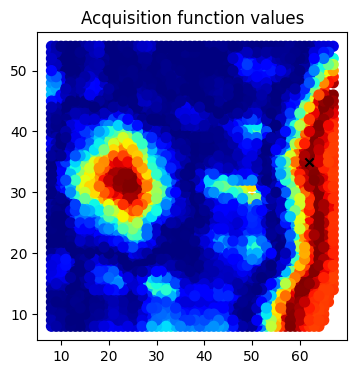

44/80
Epoch 1/20 ... Training loss: 37.2985
Epoch 10/20 ... Training loss: 35.5823
Epoch 20/20 ... Training loss: 33.6128


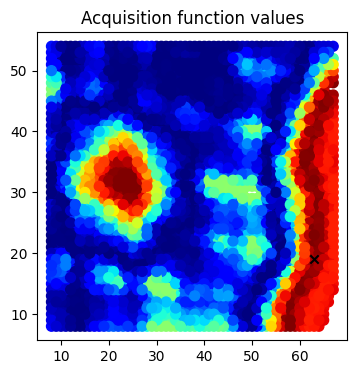

45/80
Epoch 1/20 ... Training loss: 37.246
Epoch 10/20 ... Training loss: 35.5093
Epoch 20/20 ... Training loss: 33.6142


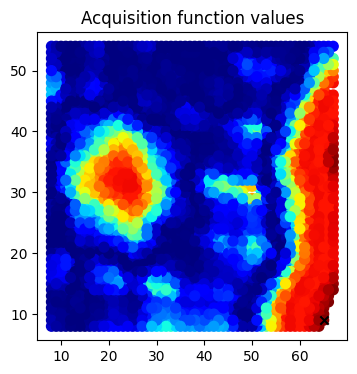

46/80
Epoch 1/20 ... Training loss: 37.1994
Epoch 10/20 ... Training loss: 35.6358
Epoch 20/20 ... Training loss: 33.6502


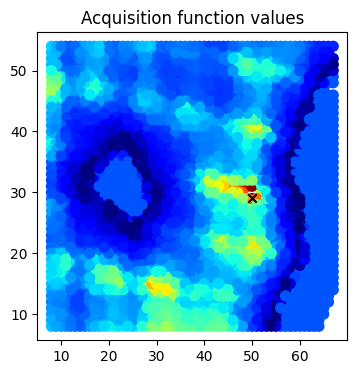

47/80
Epoch 1/20 ... Training loss: 37.1783
Epoch 10/20 ... Training loss: 35.6548
Epoch 20/20 ... Training loss: 33.6306


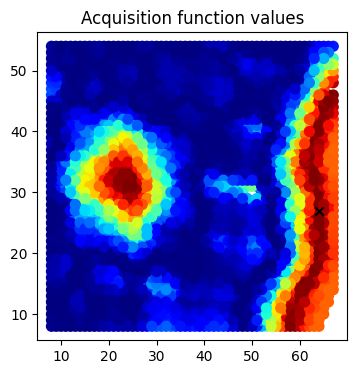

48/80
Epoch 1/20 ... Training loss: 37.1391
Epoch 10/20 ... Training loss: 35.5339
Epoch 20/20 ... Training loss: 33.4678


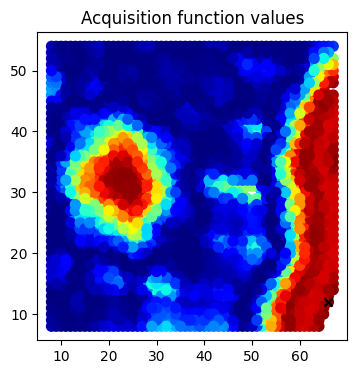

49/80
Epoch 1/20 ... Training loss: 37.0952
Epoch 10/20 ... Training loss: 35.6837
Epoch 20/20 ... Training loss: 33.5844


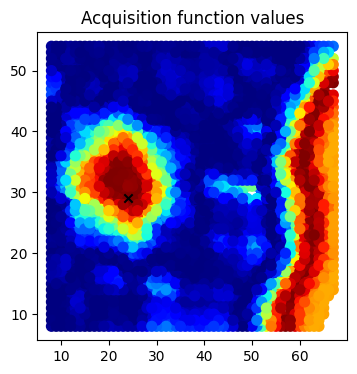

50/80
Epoch 1/20 ... Training loss: 37.0554
Epoch 10/20 ... Training loss: 35.4789
Epoch 20/20 ... Training loss: 33.6042


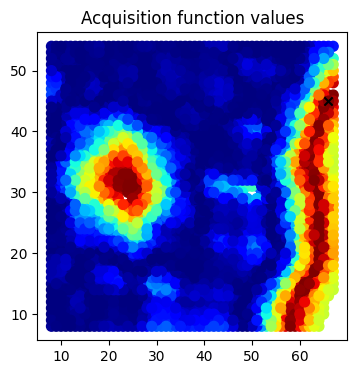

51/80
Epoch 1/20 ... Training loss: 37.0154
Epoch 10/20 ... Training loss: 35.4033
Epoch 20/20 ... Training loss: 33.4832


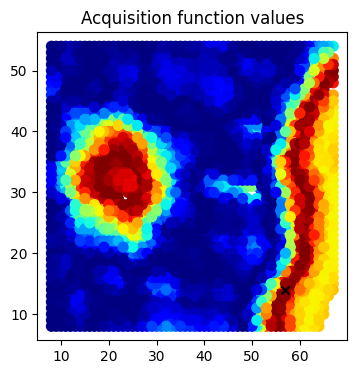

52/80
Epoch 1/20 ... Training loss: 36.9672
Epoch 10/20 ... Training loss: 35.404
Epoch 20/20 ... Training loss: 33.2833


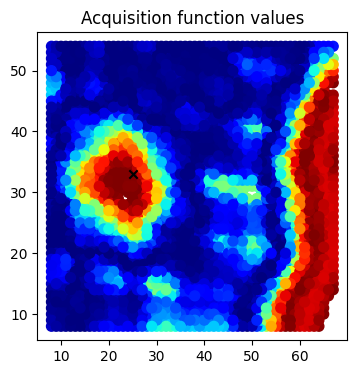

53/80
Epoch 1/20 ... Training loss: 36.9294
Epoch 10/20 ... Training loss: 35.1425
Epoch 20/20 ... Training loss: 33.2886


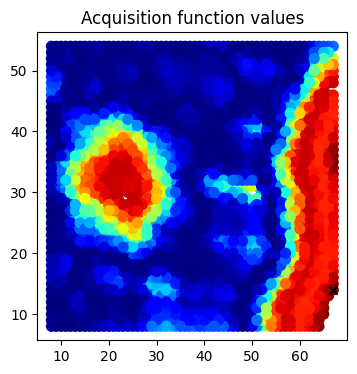

54/80
Epoch 1/20 ... Training loss: 36.8918
Epoch 10/20 ... Training loss: 35.2754
Epoch 20/20 ... Training loss: 33.3856


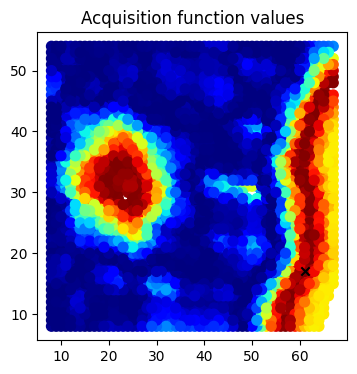

55/80
Epoch 1/20 ... Training loss: 36.8526
Epoch 10/20 ... Training loss: 35.2189
Epoch 20/20 ... Training loss: 33.3273


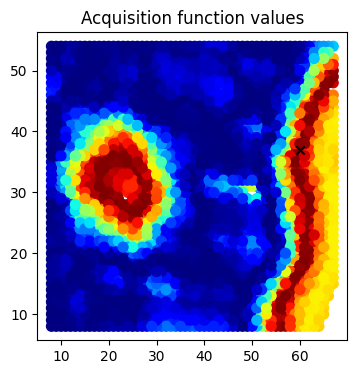

56/80
Epoch 1/20 ... Training loss: 36.8157
Epoch 10/20 ... Training loss: 35.1202
Epoch 20/20 ... Training loss: 33.2034


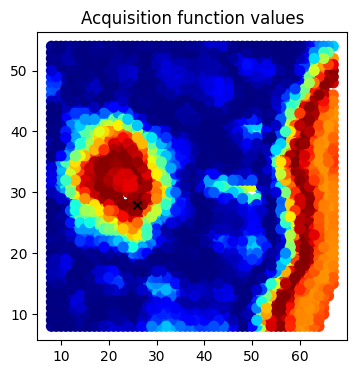

57/80
Epoch 1/20 ... Training loss: 36.8055
Epoch 10/20 ... Training loss: 35.1678
Epoch 20/20 ... Training loss: 33.1221


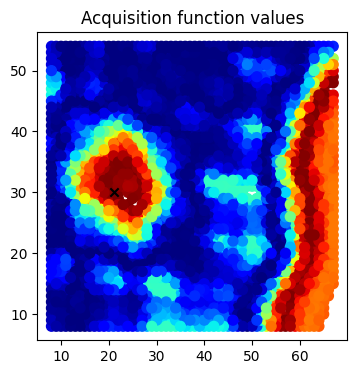

58/80
Epoch 1/20 ... Training loss: 36.7742
Epoch 10/20 ... Training loss: 35.1826
Epoch 20/20 ... Training loss: 33.1715


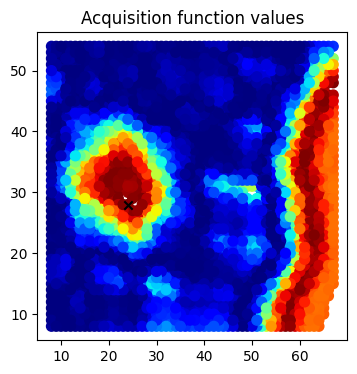

59/80
Epoch 1/20 ... Training loss: 36.7508
Epoch 10/20 ... Training loss: 35.1237
Epoch 20/20 ... Training loss: 33.2565


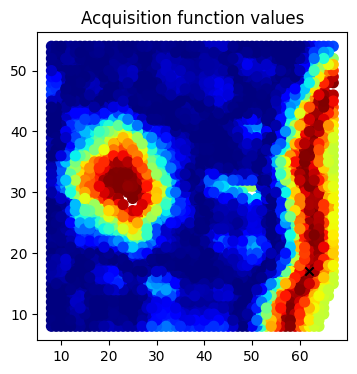

60/80
Epoch 1/20 ... Training loss: 36.7151
Epoch 10/20 ... Training loss: 35.0321
Epoch 20/20 ... Training loss: 33.0633


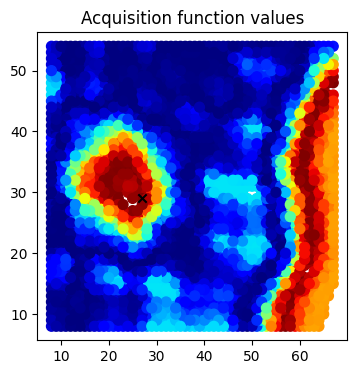

61/80
Epoch 1/20 ... Training loss: 36.6832
Epoch 10/20 ... Training loss: 34.9997
Epoch 20/20 ... Training loss: 33.1376


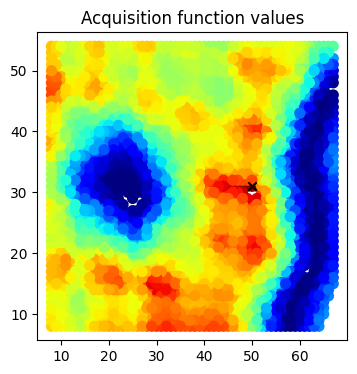

62/80
Epoch 1/20 ... Training loss: 36.6673
Epoch 10/20 ... Training loss: 35.0452
Epoch 20/20 ... Training loss: 33.1732


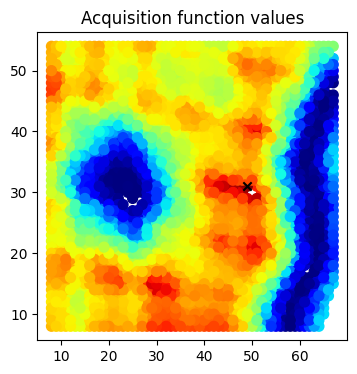

63/80
Epoch 1/20 ... Training loss: 36.6525
Epoch 10/20 ... Training loss: 34.9093
Epoch 20/20 ... Training loss: 33.039


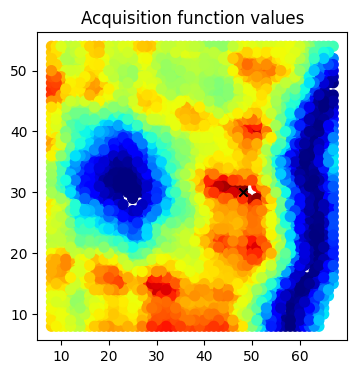

64/80
Epoch 1/20 ... Training loss: 36.6428
Epoch 10/20 ... Training loss: 35.0858
Epoch 20/20 ... Training loss: 33.187


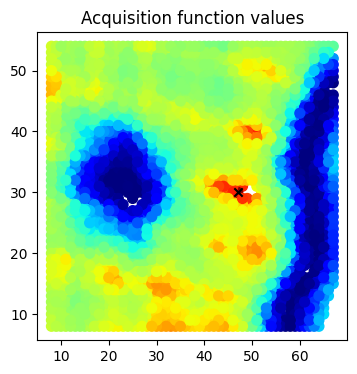

65/80
Epoch 1/20 ... Training loss: 36.6166
Epoch 10/20 ... Training loss: 34.9587
Epoch 20/20 ... Training loss: 33.1559


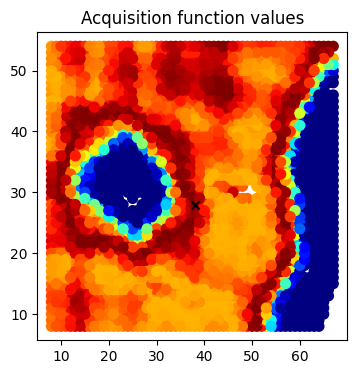

66/80
Epoch 1/20 ... Training loss: 36.5938
Epoch 10/20 ... Training loss: 35.0428
Epoch 20/20 ... Training loss: 33.148


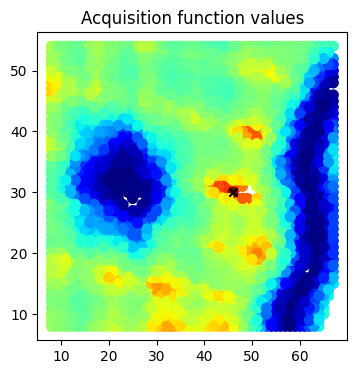

67/80
Epoch 1/20 ... Training loss: 36.5715
Epoch 10/20 ... Training loss: 35.0107
Epoch 20/20 ... Training loss: 33.1548


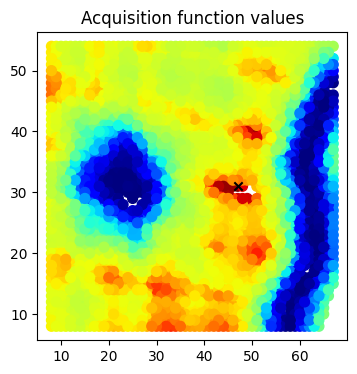

68/80
Epoch 1/20 ... Training loss: 36.5512
Epoch 10/20 ... Training loss: 34.9283
Epoch 20/20 ... Training loss: 33.1372


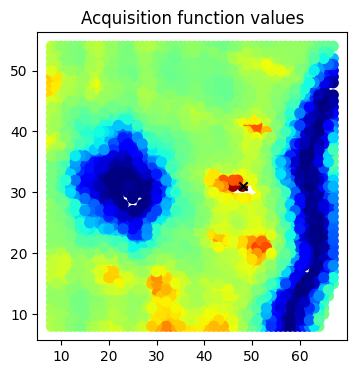

69/80
Epoch 1/20 ... Training loss: 36.5344
Epoch 10/20 ... Training loss: 34.9166
Epoch 20/20 ... Training loss: 33.1129


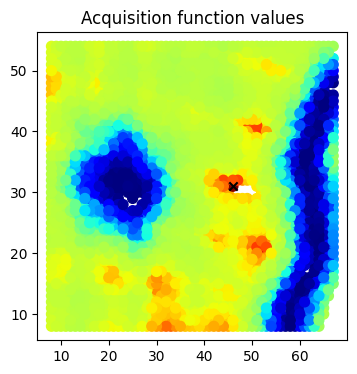

70/80
Epoch 1/20 ... Training loss: 36.5094
Epoch 10/20 ... Training loss: 34.995
Epoch 20/20 ... Training loss: 33.1386


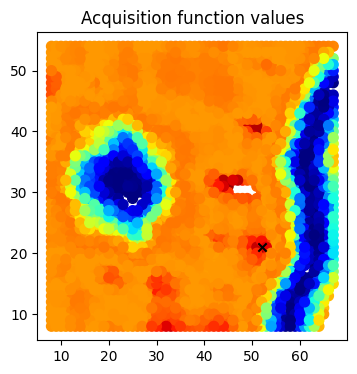

71/80
Epoch 1/20 ... Training loss: 36.4861
Epoch 10/20 ... Training loss: 34.9106
Epoch 20/20 ... Training loss: 33.0243


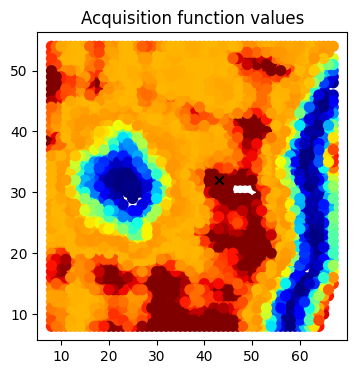

72/80
Epoch 1/20 ... Training loss: 36.4701
Epoch 10/20 ... Training loss: 34.9329
Epoch 20/20 ... Training loss: 32.9175


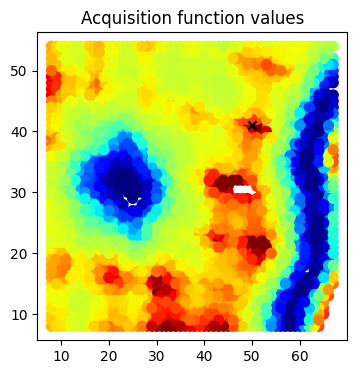

73/80
Epoch 1/20 ... Training loss: 36.4516
Epoch 10/20 ... Training loss: 34.8137
Epoch 20/20 ... Training loss: 32.9377


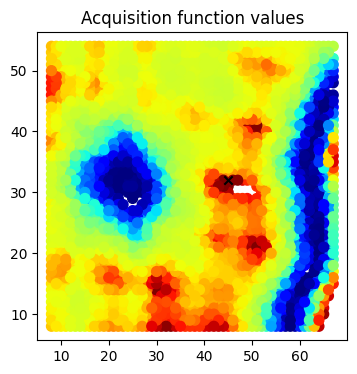

74/80
Epoch 1/20 ... Training loss: 36.4326
Epoch 10/20 ... Training loss: 34.8013
Epoch 20/20 ... Training loss: 33.0544


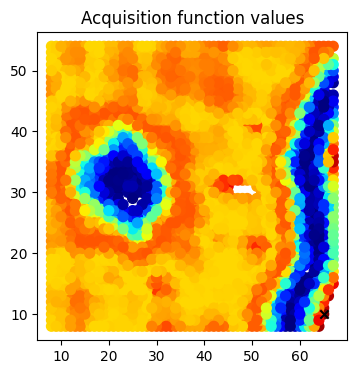

75/80
Epoch 1/20 ... Training loss: 36.4114
Epoch 10/20 ... Training loss: 34.7924
Epoch 20/20 ... Training loss: 32.9204


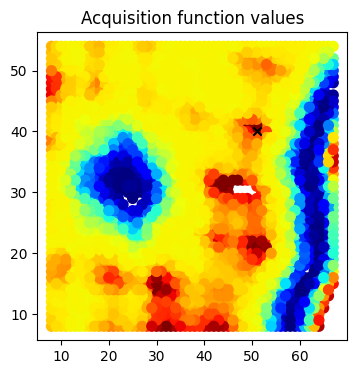

76/80
Epoch 1/20 ... Training loss: 36.39
Epoch 10/20 ... Training loss: 34.8677
Epoch 20/20 ... Training loss: 32.9997


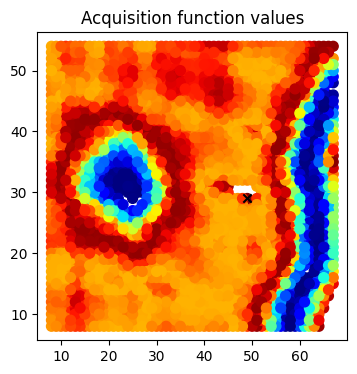

77/80
Epoch 1/20 ... Training loss: 36.3704
Epoch 10/20 ... Training loss: 34.7871
Epoch 20/20 ... Training loss: 32.9903


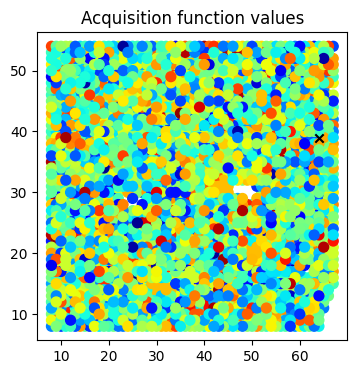

78/80
Epoch 1/20 ... Training loss: 36.3533
Epoch 10/20 ... Training loss: 34.855
Epoch 20/20 ... Training loss: 32.9495


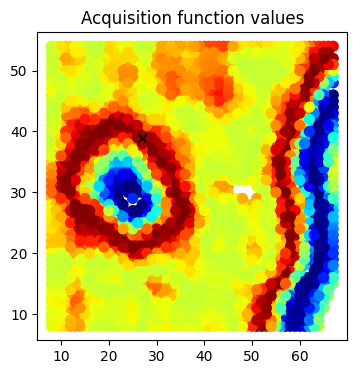

79/80
Epoch 1/20 ... Training loss: 36.3387
Epoch 10/20 ... Training loss: 34.7434
Epoch 20/20 ... Training loss: 32.9514


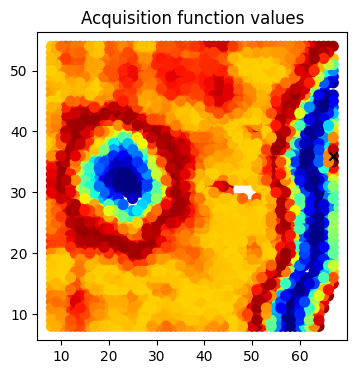

80/80
Epoch 1/20 ... Training loss: 36.3175
Epoch 10/20 ... Training loss: 34.8082
Epoch 20/20 ... Training loss: 32.8767


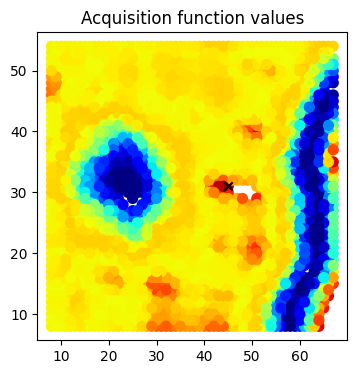

In [88]:
band = [30, 35]

data_dim = X_train.shape[-1]


xi = 0.01  # balances exploration and exploitation for EI
exploration_steps = 80

for e in range(exploration_steps):
    print("{}/{}".format(e+1, exploration_steps))
    training_iter = 20 if e < 100 else 40  # we do not want to "overfit" our model at the beginning
    # update GP posterior
    dklgp = aoi.models.dklGPR(data_dim, embedim=2, precision="double")
    dklgp.fit(X_train, y_train, training_cycles=training_iter)
    # Compute the acquisition function
    best_f = torch.tensor(dklgp.predict(X_train)[0].max())
    obj = EI(dklgp, X_test, best_f, xi) if e < 60 else CE(dklgp, X_test) # switch to a different acquisition function after 60 steps
    obj = obj.T # transpose to n_samples x vector_size  for consistency
    # Scalarize the acqusition function
    obj = scalarize_acq(obj)
    # Select next point to "measure"
    next_point_idx = obj.argmax()
    next_point = indices_test[next_point_idx]
    # Do "measurement"
    measured_point = y_test[:, next_point_idx]
    # Plot current result
    plot_result(indices_test, obj, e)
    # Append to the arrays of measured points
    X_train = np.append(X_train, X_test[next_point_idx][None], 0)
    X_test = np.delete(X_test, next_point_idx, 0)
    y_train = np.append(y_train, measured_point[:, None], 1)
    y_test = np.delete(y_test, next_point_idx, 1)
    indices_train = np.append(indices_train, next_point[None], 0)
    indices_test = np.delete(indices_test, next_point_idx, 0)

Plot the visited points:

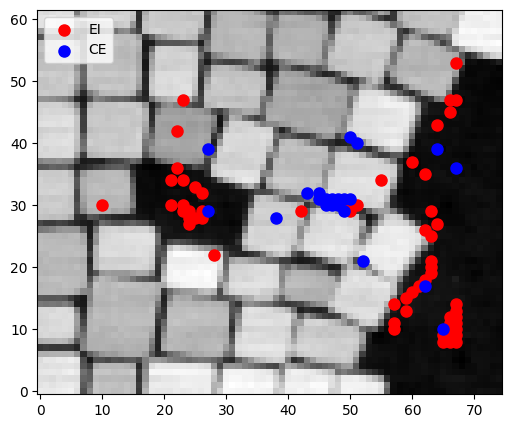

In [89]:
plt.figure(figsize=(6, 6))
plt.imshow(full_img, cmap='gray', origin="lower")
plt.scatter(indices_train[:60, 1], indices_train[:60, 0], s=64, c='r', label="EI")
plt.scatter(indices_train[60:, 1], indices_train[60:, 0], s=64, c='b', label="CE")
plt.legend()

# Non-negative matrix factorization

In [90]:
from sklearn.decomposition import PCA, NMF
from matplotlib.colors import LinearSegmentedColormap

Purple=130./255,53/255., 1.
Orange=1,120./255, 0
Blue=10./255,175/255., 1.
Red=200./255,20/255., 20/225.
Green=50./255,220./255, 50./255
Yellow=220./255,220./255, 90./255
Pink=255/255.,105/255., 180/255.
Gold=155/255.,205/255.,32/255.
Turquoise=72/255., 229/255., 204/255.
Brown=220/255., 142/255., 105/255.
Forest=64/255., 169/255., 64/255.
Gray=159/255., 176/255., 184/255.
Royal=95/255., 55/255., 255/255.

Cmap_Purple = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Purple),(1,1,1)], N=100)
Cmap_Orange = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Orange),(1,1,1)], N=100)
Cmap_Blue = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Blue),(1,1,1)], N=100)
Cmap_Red = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Red),(1,1,1)], N=100)
Cmap_Green = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Green),(1,1,1)], N=100)
Cmap_Pink = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Pink),(1,1,1)], N=100)
Cmap_Gold = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Gold),(1,1,1)], N=100)
Cmap_Gray = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Gray),(1,1,1)], N=100)

colorlist = [Purple, Green, Blue, Red, Orange, Pink, Gold, Gray]
cmaplist = [Cmap_Purple, Cmap_Green, Cmap_Blue, Cmap_Red, Cmap_Orange, Cmap_Pink, Cmap_Gold, Cmap_Gray]

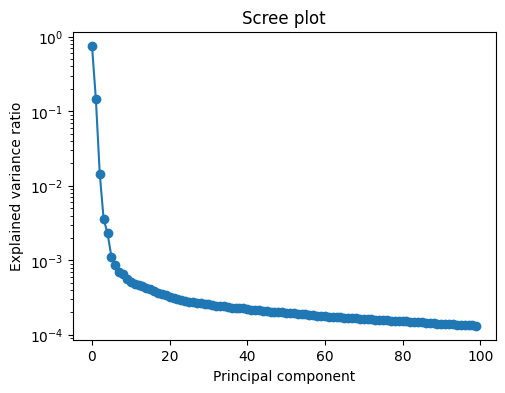

In [91]:
SINBflat = np.reshape(specim, (specim.shape[0]*specim.shape[1],specim.shape[2]))
fig= plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1,2)
ax1 = plt.subplot(gs[0,0])

pca = PCA()

pca.fit(SINBflat[:,:])

explained_var = pca.explained_variance_ratio_

ax1.plot(explained_var[0:100], 'o-')
ax1.semilogy()
ax1.set_xlabel('Principal component')
ax1.set_ylabel('Explained variance ratio');
ax1.set_title('Scree plot')


SIdecon=np.copy(SINBflat)
SIdecon=np.copy(SINBflat[:,:])
SIdecon[np.where(SIdecon<0)]=0

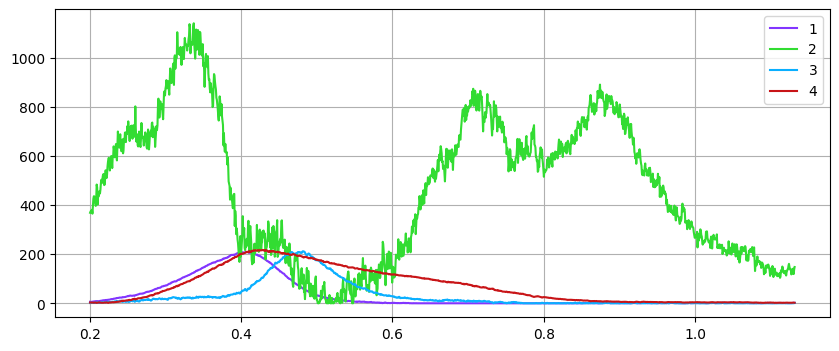

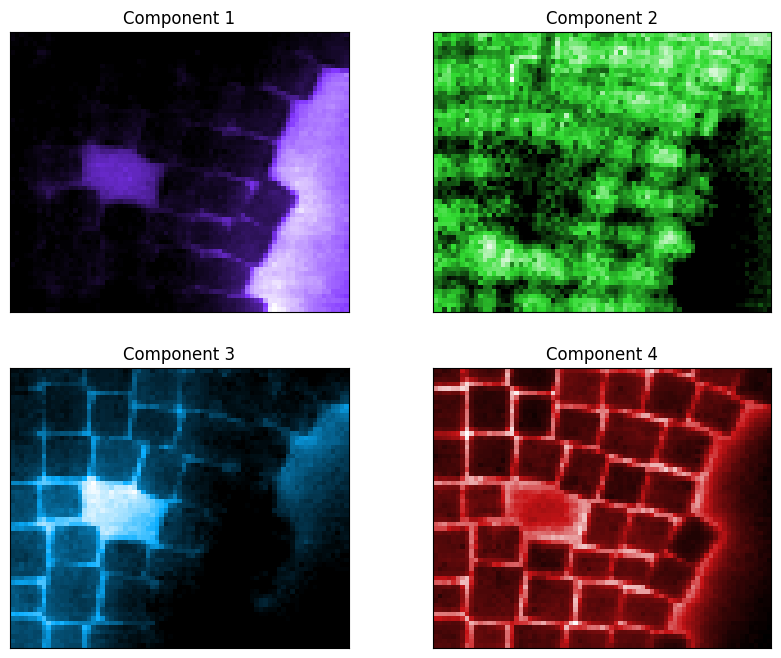

In [92]:
N=4

XY = specim.shape[0:2]
model=NMF(n_components=N, random_state = 42)
NMFIm=model.fit_transform(SIdecon[:,:])
NMFSpec=model.components_
NMFIm=NMFIm.reshape(XY+(N,)).transpose(2,0,1)

rows = int(np.ceil(float(N)/3))
cols = int(np.ceil(float(N)/rows))

fig1,ax1 = plt.subplots(figsize = (10,4))

for jj in range(N):
    try:
      ax1.plot(e_ax,NMFSpec[jj],color = colorlist[jj], label = jj+1)
    except IndexError:
      rollover = int(jj/len(colorlist))
      ax1.plot(e_ax,NMFSpec[jj],color = colorlist[int(jj - len(colorlist)*rollover)], label = jj+1)

    ax1.grid(True)
    ax1.tick_params(labelsize=10)
    ax1.legend()
plt.show()

gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (5*cols, 4*(1+rows//2)))

for jj in range(N):
    ax2 = fig2.add_subplot(gs2[jj])
    try:
      ax2.imshow(NMFIm[jj],cmap = cmaplist[jj], origin = 'lower')
    except IndexError:
      rollover = int(jj/len(colorlist))
      ax2.imshow(NMFIm[jj],cmap = cmaplist[int(jj - len(colorlist)*rollover)], origin = 'lower')
    ax2.set_title('Component ' + str(jj+1))
    plt.setp([ax2],xticks=[], yticks=[])

* This seems to give better results if using a higher (than expected) number of components

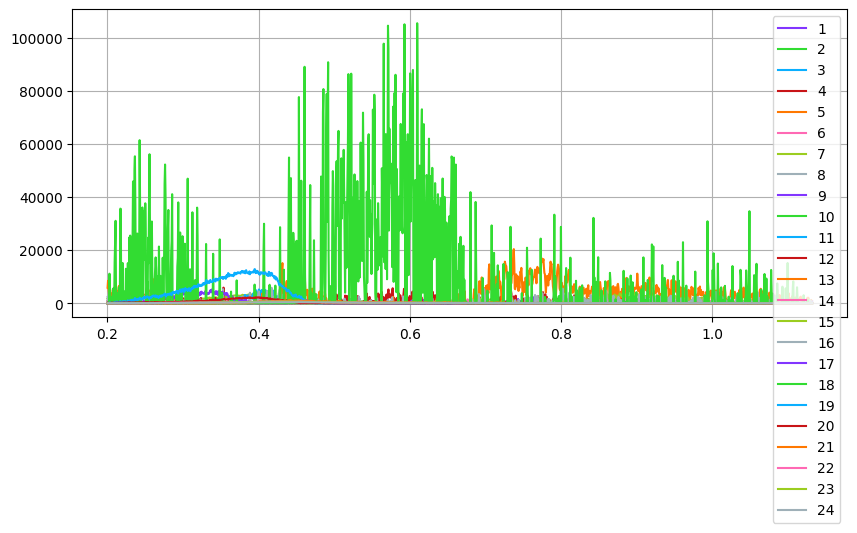

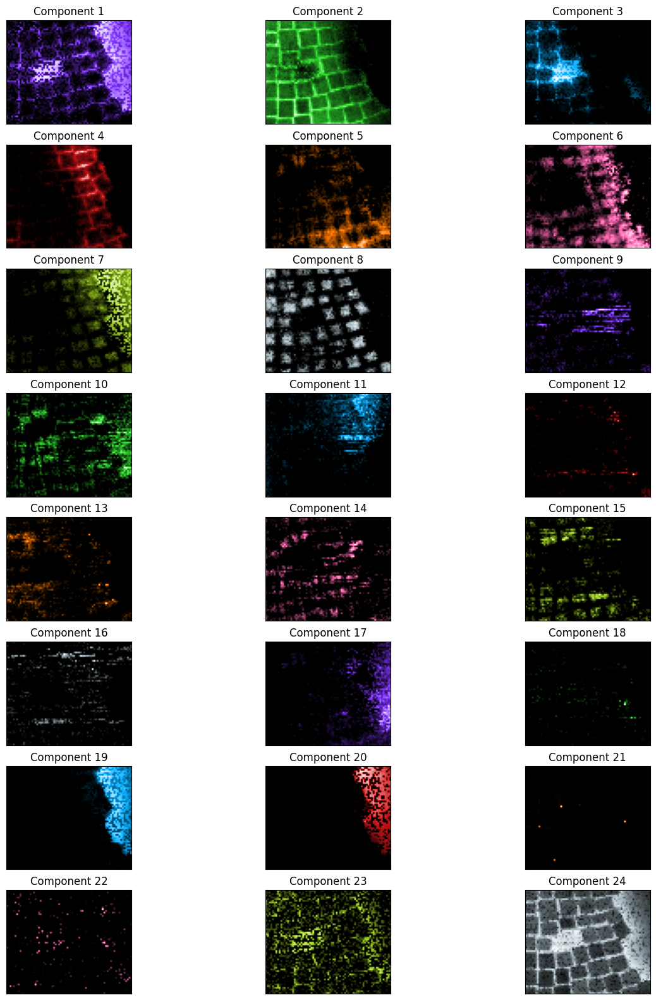

In [93]:
N=24

XY = specim.shape[0:2]
model=NMF(n_components=N, random_state = 42)
NMFIm=model.fit_transform(SIdecon[:,:])
NMFSpec=model.components_
NMFIm=NMFIm.reshape(XY+(N,)).transpose(2,0,1)

rows = int(np.ceil(float(N)/3))
cols = int(np.ceil(float(N)/rows))

fig1,ax1 = plt.subplots(figsize = (10,4))

for jj in range(N):
    try:
      ax1.plot(e_ax,NMFSpec[jj],color = colorlist[jj], label = jj+1)
    except IndexError:
      rollover = int(jj/len(colorlist))
      ax1.plot(e_ax,NMFSpec[jj],color = colorlist[int(jj - len(colorlist)*rollover)], label = jj+1)

    ax1.grid(True)
    ax1.tick_params(labelsize=10)
    ax1.legend()
plt.show()

gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (5*cols, 4*(1+rows//2)))

for jj in range(N):
    ax2 = fig2.add_subplot(gs2[jj])
    try:
      ax2.imshow(NMFIm[jj],cmap = cmaplist[jj])
    except IndexError:
      rollover = int(jj/len(colorlist))
      ax2.imshow(NMFIm[jj],cmap = cmaplist[int(jj - len(colorlist)*rollover)])
    ax2.set_title('Component ' + str(jj+1))
    plt.setp([ax2],xticks=[], yticks=[])

* Then select the reasonable ones (yes there is some bias / required domain expertise)

In [94]:
comps = [0,1,2,4]
len(comps)

4

(0.2, 1.2)

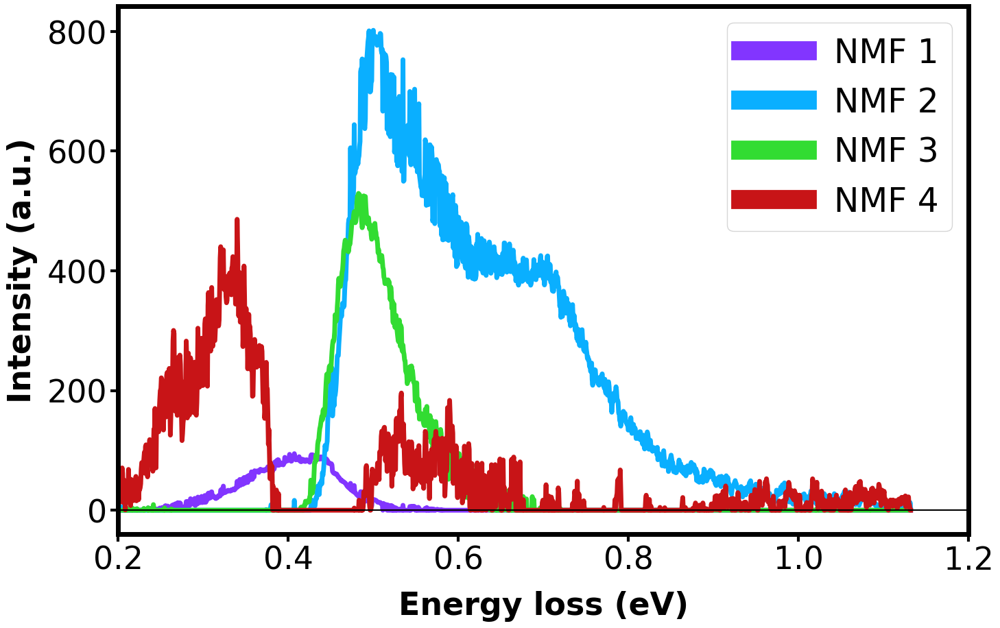

In [95]:
xlimits = [0.2, 1.2]

fig,ax = plt.subplots(1,figsize=(16,10))

fsize = 40

ax.plot(e_ax, NMFSpec[comps[0]], lw = 5, color = colorlist[0], label = 'NMF 1')
ax.plot(e_ax, NMFSpec[comps[1]], lw = 5, color = colorlist[2], label = 'NMF 2')
ax.plot(e_ax, NMFSpec[comps[2]], lw = 5, color = colorlist[1], label = 'NMF 3')
ax.plot(e_ax, NMFSpec[comps[3]], lw = 5, color = colorlist[3], label = 'NMF 4')

leg=ax.legend(fontsize = 35)
for line in leg.get_lines():
  line.set_linewidth(20)

ax.set_xlabel('Energy loss (eV)', fontsize = 33, labelpad = 15, weight = 'bold')
ax.set_ylabel('Intensity (a.u.)', fontsize = 33, labelpad = 10, weight = 'bold')
ax.tick_params(labelsize = 33, length = 8, width = 3)


for axis in ['top','bottom','left','right']:
  ax.spines[axis].set_linewidth(5)

ax.axhline(0, c='k')

ax.set_xlim(xlimits[0], xlimits[1])

[]

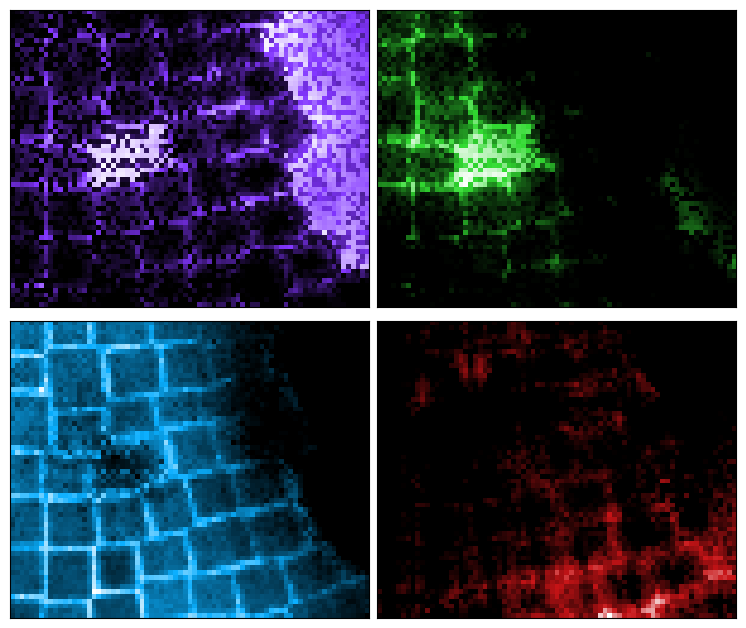

In [96]:
fig = plt.figure(figsize=(9.37,8))
gs = gridspec.GridSpec(2,2, wspace = 0.02, hspace = 0.02)

ax20, ax21  = plt.subplot(gs[0,0]), plt.subplot(gs[1,0]),
ax30, ax31 = plt.subplot(gs[0,1]), plt.subplot(gs[1,1])

fsize = 20
ax20.imshow(NMFIm[comps[0]], cmap = cmaplist[0])
ax21.imshow(NMFIm[comps[1]], cmap = cmaplist[2])
ax30.imshow(NMFIm[comps[2]], cmap = cmaplist[1])
ax31.imshow(NMFIm[comps[3]], cmap = cmaplist[3])

img_axes = [ax20, ax21, ax30, ax31]
plt.setp(img_axes, xticks = [], yticks = [])